# Load functions and data

In [1]:
%load_ext autoreload
%autoreload 2
from analysis_imports_and_functions import *

print(os.getcwd())

with open("config.json", "r") as f:
    config = json.load(f)

mother_machine_data_pickle = "mother_machine_data_2025_11_28.pickle"
mother_machine_data = pd.read_pickle(mother_machine_data_pickle)
mother_machine_data

/home/ka537/external_SSD/2025_11_28_40x_persister


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,solidity,FOV_number,lane,condition
130048,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,0.964088,5,0,Fresh media
130049,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,0.952514,5,0,Fresh media
130050,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,0.967552,5,0,Fresh media
130051,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,0.962857,5,0,Fresh media
130052,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,0.974138,5,0,Fresh media
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13494643,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,0.940032,789,3,"50 μg/mL ampicillin, 4 hours"
13494644,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,0.956607,789,3,"50 μg/mL ampicillin, 4 hours"
13494645,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,0.938224,789,3,"50 μg/mL ampicillin, 4 hours"
13494646,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,0.954545,789,3,"50 μg/mL ampicillin, 4 hours"


# Timepoint thresholds

In [2]:
# Set criteria for cells present at the start and end of the experiment (to remove empty trenches with segmentation artefacts & to act as a crude check for cells surviving at the end)
TRENCHES_FILE = "trenches.zarr"
MASKS_FILTERED_FILE = "masks_upscaled_filtered.zarr"

START_END_CONFIG = {
    'n_first':    {'min': 5, 'max': 50, 'step': 1,   'default': 20},
    'miss_first': {'min': 0, 'max': 20, 'step': 1,   'default': 2},
    'n_last':     {'min': 5, 'max': 50, 'step': 1,   'default': 30},
    'miss_last':  {'min': 0, 'max': 20, 'step': 1,   'default': 1} 
}

start_end_params = run_interactive_start_end_image_check(mother_machine_data, TRENCHES_FILE, MASKS_FILTERED_FILE, START_END_CONFIG, upscaled=True)

Loading images from:
 - trenches.zarr
 - masks_upscaled_filtered.zarr

 START/END PARAMS SAVED
n_first             : 20
miss_first          : 2
n_last              : 30
miss_last           : 1



In [14]:
# (Optional) Check at_start criteria looks good:
inspect_start_fails(mother_machine_data, locals().get('start_end_params'), TRENCHES_FILE, MASKS_FILTERED_FILE, START_END_CONFIG)

Identifying Start Failures...
 APPLYING START/END FLAGS 
Start Window: First 20 pts (Max 2 missing)
End Window:   Last  30 pts (Max 1 missing)
Unique mother_id counts — mother_machine_data: 50896, at_start: 46379, at_end: 16001, at_start & at_end: 15399
----------------------------------------
Found 4517 Start Failures. Launching viewer...
Loading images from:
 - trenches.zarr
 - masks_upscaled_filtered.zarr


{'n_first': 20, 'miss_first': 2, 'n_last': 30, 'miss_last': 1}


 START/END PARAMS SAVED
n_first             : 20
miss_first          : 2
n_last              : 30
miss_last           : 1
>> Updating 'params' variable in-place.



In [6]:
# (Optional) Check at_end criteria looks good:
inspect_end_fails(mother_machine_data, locals().get('start_end_params'), TRENCHES_FILE, MASKS_FILTERED_FILE, START_END_CONFIG)

Identifying End Failures...
 APPLYING START/END FLAGS 
Start Window: First 20 pts (Max 2 missing)
End Window:   Last  30 pts (Max 1 missing)
Unique mother_id counts — mother_machine_data: 38873, at_start: 26538, at_end: 23349, at_start & at_end: 21637
----------------------------------------
Found 15524 End Failures. Launching viewer...
Loading images from:
 - trenches.zarr
 - masks_upscaled_filtered.zarr


{'n_first': 20, 'miss_first': 2, 'n_last': 30, 'miss_last': 1}


 START/END PARAMS SAVED
n_first             : 20
miss_first          : 2
n_last              : 30
miss_last           : 1
>> Updating 'params' variable in-place.



In [3]:
# Run at_start & at_end criteria for all mother_ids
mother_machine_data = execute_batch_start_end_flags(mother_machine_data, locals().get('start_end_params'))

mother_machine_data

 APPLYING START/END FLAGS 
Start Window: First 20 pts (Max 2 missing)
End Window:   Last  30 pts (Max 1 missing)
Unique mother_id counts — mother_machine_data: 50896, at_start: 46379, at_end: 16001, at_start & at_end: 15399
----------------------------------------


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,solidity,FOV_number,lane,condition,at_start,at_end
130048,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,0.964088,5,0,Fresh media,True,True
130049,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,0.952514,5,0,Fresh media,True,True
130050,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,0.967552,5,0,Fresh media,True,True
130051,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,0.962857,5,0,Fresh media,True,True
130052,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,0.974138,5,0,Fresh media,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13494643,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,0.940032,789,3,"50 μg/mL ampicillin, 4 hours",True,False
13494644,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,0.956607,789,3,"50 μg/mL ampicillin, 4 hours",True,False
13494645,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,0.938224,789,3,"50 μg/mL ampicillin, 4 hours",True,False
13494646,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,0.954545,789,3,"50 μg/mL ampicillin, 4 hours",True,False


# Cell growth trace initial cleanup

In [4]:
"""
================================================================================
                        GROWTH TRACE CLEANING PIPELINE
================================================================================

This pipeline applies 4 filters sequentially to clean cell growth traces.
The "mother_machine_data" DataFrame is filtered in the following order:

1. HARD AREA FILTER
   - Logic: Rejects ANY timepoint where area < 'hard_min'.
   - 'hard_min': Minimum area threshold (microns^2) allowed for any point.

2. GATED AREA FILTER
   - Logic: Finds the first sequence of 'gate_len' frames where area >= 'gated_min'.
     Rejects any point AFTER this gate opens if area < 'gated_min'.
   - 'gated_min': Area threshold applied only after the cell passes the gate check.
   - 'gate_len': Number of consecutive frames above 'gated_min' required to open the gate.

3. SPIKE FILTER
   - Logic: Rejects length spikes where length jumps UP by >= 'spike_fc' 
     and then DOWN by >= 'spike_fc' within 'spike_gap' frames.
   - 'spike_fc': Fold change threshold (e.g., 2.0 means doubling/halving).
   - 'spike_gap': Maximum frames allowed between the UP jump and the DOWN jump.

4. GRADIENT FILTER
   - Logic: Iteratively removes points creating a positive slope > 'grad_max'.
     It bridges gaps up to 'grad_gap' frames to check the gradient.
   - 'grad_max': Maximum allowed positive gradient (slope of ln(length) vs time).
   - 'grad_gap': Maximum frames to look back when calculating gradient.

================================================================================
"""

# -- PARAMETER CONFIGURATION ---------------------------------------------------
# min/max: slider range, step: slider interval, default: default value
CLEANING_CONFIG = {
    # 1. Hard Area Filter
    'hard_min':  {'min': 0.5, 'max': 3.0, 'step': 0.01,  'default': 0.87},
    
    # 2. Gated Area Filter
    'gated_min': {'min': 0.5, 'max': 3.0, 'step': 0.01,  'default': 1.34},
    'gate_len':  {'min': 0,   'max': 20,  'step': 1,     'default': 10},
    
    # 3. Spike Filter (Now Split Up/Down)
    'spike_fc_up':   {'min': 1.0, 'max': 3.0, 'step': 0.1,   'default': 1.6},
    'spike_fc_down': {'min': 1.0, 'max': 3.0, 'step': 0.1,   'default': 1.4},
    'spike_gap':     {'min': 0,   'max': 5,   'step': 1,     'default': 3},
    
    # 4. Gradient Filter
    'grad_max':  {'min': 0.0, 'max': 0.1, 'step': 0.001, 'default': 0.046},
    'grad_gap':  {'min': 0,   'max': 10,  'step': 1,     'default': 3}
}


# -- EXECUTION --
cleaning_params = launch_interactive_cleaning(mother_machine_data, CLEANING_CONFIG)

Loaded 50896 traces.

 PARAMETERS SAVED
HARD_MIN        = 0.870
GATED_MIN       = 1.340
GATE_LEN        = 10
SPIKE_FC_UP     = 1.600
SPIKE_FC_DOWN   = 1.400
SPIKE_GAP       = 3
GRAD_MAX        = 0.046
GRAD_GAP        = 3
--------------------
USE_HARD        = True
USE_GATED       = True
USE_SPIKE       = True
USE_GRAD        = True



In [5]:
# Run growth trace cleanup for all mother_ids using saved parameters
num_IDs_to_plot_per_lane = 50  # Set to False to plot all mother_ids

mother_machine_data = execute_batch_cleaning(mother_machine_data, locals().get('cleaning_params'), num_IDs_to_plot_per_lane=num_IDs_to_plot_per_lane)

mother_machine_data

 STARTING BATCH CLEANING 
Report: growth_traces_cleaned_2025_11_28_40x_persister_20260222_152817.pdf
Step 1: Preparing Data and Applying Filters...
Active Filters: Hard=True, Gated=True, Spike=True, Grad=True


Processing Growth Trace Cleaning:   0%|          | 0/50896 [00:00<?, ?it/s]

Cleaning Complete. 1715285 points removed.
Sampling ~50 mothers per lane for the PDF report...
Step 2: Generating PDF Report...
PDF Report saved to: growth_traces_cleaned_2025_11_28_40x_persister_20260222_152817.pdf
 DONE 


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,solidity,FOV_number,lane,condition,at_start,at_end,log_length_cleaned
0,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,0.964088,5,0,Fresh media,True,True,0.945760
1,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,0.952514,5,0,Fresh media,True,True,0.920948
2,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,0.967552,5,0,Fresh media,True,True,0.899692
3,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,0.962857,5,0,Fresh media,True,True,0.898597
4,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,0.974138,5,0,Fresh media,True,True,0.894247
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13221178,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,0.940032,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.530553
13221179,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,0.956607,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.317533
13221180,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,0.938224,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.358181
13221181,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,0.954545,789,3,"50 μg/mL ampicillin, 4 hours",True,False,NaN


In [6]:
# Identify division events (basic 1st pass, we re-do this later after extra smoothing steps)
DIV_CONFIG = {
    'prominence': {'min': 0.0, 'max': 0.2, 'step': 0.005, 'default': 0.100},
    'min_dist':   {'min': 0,   'max': 60,  'step': 1,    'default': 12},
    'drop_min':   {'min': 0.0, 'max': 1.0, 'step': 0.05, 'default': 0.35}, 
    'drop_max':   {'min': 0.0, 'max': 10.0,'step': 0.1,  'default': 1.1}
}

div_params = launch_interactive_division_testing(mother_machine_data, DIV_CONFIG)

Loaded 50896 traces.

 DIVISION PARAMETERS SAVED
peak_prominence          : 0.1
min_division_interval    : 12
drop_min                 : 0.35
drop_max                 : 1.1



In [7]:
# Run division event identification for all mother_ids
mother_machine_data = execute_batch_division_detection(mother_machine_data, locals().get('div_params'))

mother_machine_data

 STARTING DIVISION DETECTION 
Step 1: Detecting Division Events...


Processing Division Event Identification:   0%|          | 0/50896 [00:00<?, ?it/s]

Detection Complete. Flagged 407485 unique division events (across all channels).
 DONE 


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,solidity,FOV_number,lane,condition,at_start,at_end,log_length_cleaned,division_event
0,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,0.964088,5,0,Fresh media,True,True,0.945760,False
1,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,0.952514,5,0,Fresh media,True,True,0.920948,False
2,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,0.967552,5,0,Fresh media,True,True,0.899692,False
3,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,0.962857,5,0,Fresh media,True,True,0.898597,False
4,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,0.974138,5,0,Fresh media,True,True,0.894247,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13221178,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,0.940032,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.530553,False
13221179,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,0.956607,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.317533,False
13221180,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,0.938224,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.358181,False
13221181,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,0.954545,789,3,"50 μg/mL ampicillin, 4 hours",True,False,NaN,False


# Extensive data cleanup, division event/growth rate/slowdown event/lag time identification

In [2]:
fresh_media_start = 12                     # minutes
treatment_start = fresh_media_start + 7*60 # minutes (set equal to fresh_media_start for stationary resuscitation experiments)
treatment_end = treatment_start + 4*60     # minutes

In [ ]:
# TO-DO: modify increased smoothing window limit to be based on size, not time? i.e. for persisters and cells growing slowly from the start

In [9]:
# Set growth trace smoothing criteria
SMOOTHING_CONFIG = {
    'lowess_window':       {'min': 0, 'max': 50, 'step': 2, 'default': 8},
    'lowess_window_early': {'min': 0, 'max': 50, 'step': 2, 'default': 14},              # extra smoothing at the start (if cells start in stationary phase), where cells are small and segmentation is more variable
    'early_time_lim':      {'min': 0, 'max': 600, 'step': 10, 'default': 100},           # define where the extra lowess_window_early smoothing ends and swaps to lowess_window
    'start_flat':          {'min': 0, 'max':60, 'step': 3, 'default': fresh_media_start} # force the first X minutes of the growth traces to have the same size (i.e. cells in spent media, which shouldn't be growing)
}
ZOOM_XLIMS = (200, 400)                                                                  # zoom in to check that "division event flattening" is working as expected

smoothing_params = run_interactive_smoothing(mother_machine_data, config=SMOOTHING_CONFIG, zoom_xlims=ZOOM_XLIMS)

Loaded 46379 candidates for smoothing check.
Saved Params:
  Main Window: 8
  Early Window: 14
  Early Limit: 100.0
  Start Flat: 12.0


In [10]:
# Process growth trace smoothing for all mother_ids
mother_machine_data = execute_batch_smoothing(mother_machine_data, smoothing_params)

mother_machine_data

 STARTING BATCH SMOOTHING (Parallel n_jobs=31) 
  Main Window:  8 pts
  Early Window: 14 pts
  Early Limit:  100.0 mins
  Start Flat:   12.0 mins
Processing 46379 mother_ids...


Smoothing growth traces:   0%|          | 0/46379 [00:00<?, ?it/s]

Concatenating results...
 DONE 


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,solidity,FOV_number,lane,condition,at_start,at_end,log_length_cleaned,division_event,log_length_smoothed
0,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,0.964088,5,0,Fresh media,True,True,0.945760,False,0.899692
1,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,0.952514,5,0,Fresh media,True,True,0.920948,False,0.899692
2,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,0.967552,5,0,Fresh media,True,True,0.899692,False,0.899692
3,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,0.962857,5,0,Fresh media,True,True,0.898597,False,0.899692
4,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,0.974138,5,0,Fresh media,True,True,0.894247,False,0.899692
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13221178,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,0.940032,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.530553,False,1.530553
13221179,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,0.956607,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.317533,False,1.317533
13221180,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,0.938224,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.358181,False,1.358181
13221181,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,0.954545,789,3,"50 μg/mL ampicillin, 4 hours",True,False,NaN,False,1.358181


In [11]:
# Set parameters for identifying missing division events
# (lean towards trying to identify almost all real division events for clean traces, artefacts for messy traces aren't a big deal as these traces will likely be discarded later)
MISSING_DIV_CONFIG = {
    'prominence':                {'min': 0.0, 'max': 0.2, 'step': 0.005, 'default': 0.150},
    'min_dist':                  {'min': 0,   'max': 60,  'step': 3,     'default': 12   },
    'drop_min':                  {'min': 0.0, 'max': 1.0, 'step': 0.01,  'default': 0.12 }, 
    'drop_max':                  {'min': 0.0, 'max': 10.0,'step': 0.1,   'default': 1.4  },
    'division_timepoint_window': {'min': 0,   'max': 30,  'step': 3,     'default': 15   },
    'division_peak_lookback':    {'min': 1,   'max': 5,   'step': 1,     'default': 5    }
}

missing_div_params = run_interactive_missing_divisions(mother_machine_data, config=MISSING_DIV_CONFIG)

Saved Missing Div Params: {'prominence': 0.15, 'min_dist': 12, 'drop_min': 0.12, 'drop_max': 1.4, 'snap_enabled': True, 'division_timepoint_window': 15, 'division_peak_lookback': 5}


In [12]:
# Process missing division event identification for all mother_ids
mother_machine_data = execute_batch_missing_divisions(mother_machine_data, missing_div_params)

mother_machine_data

 FINDING MISSING DIVISIONS (Parallel n_jobs=31) 
  Params: {'prominence': 0.15, 'min_dist': 12, 'drop_min': 0.12, 'drop_max': 1.4, 'snap_enabled': True, 'division_timepoint_window': 15, 'division_peak_lookback': 5}
Processing 46379 mother_ids...


Identifying missing division events:   0%|          | 0/46379 [00:00<?, ?it/s]

Added 78599 new division events.
 DONE 


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,solidity,FOV_number,lane,condition,at_start,at_end,log_length_cleaned,division_event,log_length_smoothed
0,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,0.964088,5,0,Fresh media,True,True,0.945760,False,0.899692
1,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,0.952514,5,0,Fresh media,True,True,0.920948,False,0.899692
2,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,0.967552,5,0,Fresh media,True,True,0.899692,False,0.899692
3,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,0.962857,5,0,Fresh media,True,True,0.898597,False,0.899692
4,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,0.974138,5,0,Fresh media,True,True,0.894247,False,0.899692
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13221178,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,0.940032,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.530553,False,1.530553
13221179,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,0.956607,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.317533,False,1.317533
13221180,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,0.938224,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.358181,False,1.358181
13221181,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,0.954545,789,3,"50 μg/mL ampicillin, 4 hours",True,False,NaN,False,1.358181


In [13]:
# Remove "division events" that are identified impossibly early
min_division_event_time = fresh_media_start + 45 # minutes
mother_machine_data.loc[mother_machine_data["time"] < min_division_event_time, "division_event"] = False

In [15]:
# Re-run growth trace smoothing for all mother_ids (with new division events)
mother_machine_data = execute_batch_smoothing(mother_machine_data, smoothing_params)

mother_machine_data

 STARTING BATCH SMOOTHING (Parallel n_jobs=31) 
  Main Window:  8 pts
  Early Window: 14 pts
  Early Limit:  100.0 mins
  Start Flat:   12.0 mins
Processing 46379 mother_ids...


Smoothing growth traces:   0%|          | 0/46379 [00:00<?, ?it/s]

Concatenating results...
 DONE 


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,solidity,FOV_number,lane,condition,at_start,at_end,log_length_cleaned,division_event,log_length_smoothed
0,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,0.964088,5,0,Fresh media,True,True,0.945760,False,0.899692
1,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,0.952514,5,0,Fresh media,True,True,0.920948,False,0.899692
2,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,0.967552,5,0,Fresh media,True,True,0.899692,False,0.899692
3,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,0.962857,5,0,Fresh media,True,True,0.898597,False,0.899692
4,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,0.974138,5,0,Fresh media,True,True,0.894247,False,0.899692
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13221178,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,0.940032,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.530553,False,1.530553
13221179,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,0.956607,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.317533,False,1.317533
13221180,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,0.938224,789,3,"50 μg/mL ampicillin, 4 hours",True,False,1.358181,False,1.358181
13221181,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,0.954545,789,3,"50 μg/mL ampicillin, 4 hours",True,False,NaN,False,1.358181


### Growth rate and second derivative

In [85]:
# Set growth rate and second deriv smoothing criteria
DERIV_CONFIG = {
    'lowess_window_first_deriv':  {'min': 0, 'max': 50, 'step': 2, 'default': 24},
    'lowess_window_second_deriv': {'min': 0, 'max': 50, 'step': 2, 'default': 12}
}

# Import 'start_flat' from SMOOTHING_CONFIG
if 'start_flat' in locals().get('SMOOTHING_CONFIG', {}):
    DERIV_CONFIG['start_flat'] = SMOOTHING_CONFIG['start_flat']
else:
    DERIV_CONFIG['start_flat'] = {'default': 0}
    
deriv_params = run_interactive_derivative_smoothing(mother_machine_data, config=DERIV_CONFIG)

Loaded 46379 traces. Start Flat enforced at t <= 0 min.


RuntimeError: latex was not able to process the following string:
b'(x10^-2 1/min)'

Here is the full command invocation and its output:

latex -interaction=nonstopmode --halt-on-error --output-directory=tmp48ptbuhs 5b357d32453c5ecf3d8685e310836e1c.tex

This is pdfTeX, Version 3.141592653-2.6-1.40.25 (TeX Live 2023/Debian) (preloaded format=latex)
 restricted \write18 enabled.
entering extended mode
(./5b357d32453c5ecf3d8685e310836e1c.tex
LaTeX2e <2023-11-01> patch level 1
L3 programming layer <2024-01-22>
(/usr/share/texlive/texmf-dist/tex/latex/base/article.cls
Document Class: article 2023/05/17 v1.4n Standard LaTeX document class
(/usr/share/texlive/texmf-dist/tex/latex/base/size10.clo))
(/usr/share/texlive/texmf-dist/tex/latex/psnfss/helvet.sty
(/usr/share/texlive/texmf-dist/tex/latex/graphics/keyval.sty))
(/usr/share/texlive/texmf-dist/tex/latex/type1cm/type1cm.sty)
(/usr/share/texmf/tex/latex/cm-super/type1ec.sty
(/usr/share/texlive/texmf-dist/tex/latex/base/t1cmr.fd))
(/usr/share/texlive/texmf-dist/tex/latex/base/inputenc.sty)
(/usr/share/texlive/texmf-dist/tex/latex/geometry/geometry.sty
(/usr/share/texlive/texmf-dist/tex/generic/iftex/ifvtex.sty
(/usr/share/texlive/texmf-dist/tex/generic/iftex/iftex.sty)))
(/usr/share/texlive/texmf-dist/tex/latex/amsmath/amsmath.sty
For additional information on amsmath, use the `?' option.
(/usr/share/texlive/texmf-dist/tex/latex/amsmath/amstext.sty
(/usr/share/texlive/texmf-dist/tex/latex/amsmath/amsgen.sty))
(/usr/share/texlive/texmf-dist/tex/latex/amsmath/amsbsy.sty)
(/usr/share/texlive/texmf-dist/tex/latex/amsmath/amsopn.sty))
(/usr/share/texlive/texmf-dist/tex/latex/amsfonts/amssymb.sty
(/usr/share/texlive/texmf-dist/tex/latex/amsfonts/amsfonts.sty))
(/usr/share/texlive/texmf-dist/tex/latex/sfmath/sfmath.sty)
(/usr/share/texlive/texmf-dist/tex/latex/underscore/underscore.sty)
(/usr/share/texlive/texmf-dist/tex/latex/firstaid/underscore-ltx.sty)
(/usr/share/texlive/texmf-dist/tex/latex/base/textcomp.sty)
(/usr/share/texlive/texmf-dist/tex/latex/l3backend/l3backend-dvips.def)
No file 5b357d32453c5ecf3d8685e310836e1c.aux.
*geometry* driver: auto-detecting
*geometry* detected driver: dvips
(/usr/share/texlive/texmf-dist/tex/latex/psnfss/ot1phv.fd)
! Missing $ inserted.
<inserted text> 
                $
l.30 {\sffamily (x10^
                     -2 1/min)}%
No pages of output.
Transcript written on tmp48ptbuhs/5b357d32453c5ecf3d8685e310836e1c.log.




Traceback (most recent call last):
  File "/home/ka537/miniconda3/envs/extraction/lib/python3.11/site-packages/matplotlib/backends/backend_qt.py", line 498, in _draw_idle
    self.draw()
  File "/home/ka537/miniconda3/envs/extraction/lib/python3.11/site-packages/matplotlib/backends/backend_agg.py", line 387, in draw
    self.figure.draw(self.renderer)
  File "/home/ka537/miniconda3/envs/extraction/lib/python3.11/site-packages/matplotlib/artist.py", line 95, in draw_wrapper
    result = draw(artist, renderer, *args, **kwargs)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/ka537/miniconda3/envs/extraction/lib/python3.11/site-packages/matplotlib/artist.py", line 72, in draw_wrapper
    return draw(artist, renderer)
           ^^^^^^^^^^^^^^^^^^^^^^
  File "/home/ka537/miniconda3/envs/extraction/lib/python3.11/site-packages/matplotlib/figure.py", line 3155, in draw
    mimage._draw_list_compositing_images(
  File "/home/ka537/miniconda3/envs/extraction/lib/python3.11/si

In [84]:
# Set growth rate and second deriv cleanup criteria
DERIV_CLEANUP_CONFIG = {
    # First Derivative (Growth Rate) - scaled by 10^-2
    'min_d1': {'min': -0.5, 'max': 0.5,  'step': 0.01, 'default': -0.2}, 
    'max_d1': {'min': 0.0,  'max': 10.0, 'step': 0.1,  'default': 3.5}, 
    'adj_d1': {'min': 0,    'max': 5,    'step': 1,    'default': 0},
    # Second Derivative - scaled by 10^-4
    'min_d2': {'min': -4.5, 'max': 0.5,  'step': 0.1,  'default': -2.5}, 
    'max_d2': {'min': 0.0,  'max': 10.0, 'step': 0.1,  'default': 3.5}, 
    'adj_d2': {'min': 0,    'max': 5,    'step': 1,    'default': 0}
}

cleanup_params = run_interactive_derivative_cleanup(mother_machine_data, config=DERIV_CLEANUP_CONFIG, prev_deriv_params=locals().get('deriv_params'))

AttributeError: 'NoneType' object has no attribute 'get'

In [18]:
# Process first and second deriv smoothing & cleanup for all mother_ids
# Creates growth_rate and second_derivative columns with the filtered raw timepoints & growth_rate_smoothed and second_deriv_smoothed for LOWESS-smoothed fit data
mother_machine_data = execute_batch_derivative_cleanup(mother_machine_data, cleanup_params, locals().get('deriv_params'))

mother_machine_data

 STARTING BATCH CLEANUP (Parallel n_jobs=31) 
  Cleanup Params: {'use_d1': True, 'min_d1': 0.0, 'max_d1': 0.035, 'adj_d1': 0, 'use_d2': True, 'min_d2': -0.00025, 'max_d2': 0.00035, 'adj_d2': 0, 'start_flat': 12.0}
  Start Flat: 12 mins
Processing 46379 mother_ids...


Cleaning derivatives:   0%|          | 0/46379 [00:00<?, ?it/s]

Concatenating results...
 DONE 


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,...,condition,at_start,at_end,log_length_cleaned,division_event,log_length_smoothed,growth_rate,second_deriv,growth_rate_smoothed,second_deriv_smoothed
0,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,...,Fresh media,True,True,0.945760,False,0.899692,0.000000,0.000000,0.000000,0.000000
1,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,...,Fresh media,True,True,0.920948,False,0.899692,0.000000,0.000000,0.000000,0.000000
2,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,...,Fresh media,True,True,0.899692,False,0.899692,0.000000,0.000000,0.000000,0.000000
3,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,...,Fresh media,True,True,0.898597,False,0.899692,0.000000,0.000000,0.000000,0.000000
4,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,...,Fresh media,True,True,0.894247,False,0.899692,0.007533,0.000178,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13221178,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,...,"50 μg/mL ampicillin, 4 hours",True,False,1.530553,False,1.530553,NaN,NaN,0.006331,-0.000291
13221179,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,...,"50 μg/mL ampicillin, 4 hours",True,False,1.317533,False,1.317533,NaN,NaN,0.004915,-0.000291
13221180,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,...,"50 μg/mL ampicillin, 4 hours",True,False,1.358181,False,1.358181,NaN,NaN,0.003500,-0.000291
13221181,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,...,"50 μg/mL ampicillin, 4 hours",True,False,NaN,False,1.358181,NaN,NaN,0.002052,-0.000291


### Final timepoints (QC)

In [19]:
# Set parameters for identifying final timepoints (based on % of subsequent growth_rate NaN timepoints), sets all subsequent timepoints (artefacts/messy traces) to NaN
# N.B. This isn't perfect at finding the actual final timepoint, it's just used as a (normally fairly non-stringent) QC step to help exclude artefacts; code to actually find the death time will be added later
FINAL_CHECK_CONFIG = {
    'max_window_nan_pct':     {'min': 0.0, 'max': 100.0, 'step': 1.0, 'default': 96.0}, # max % of timepoints that can be NaN (looking at log_length_cleaned, growth_rate, and second_deriv)
    'window_length':        {'min': 0,   'max': 600,   'step': 3,   'default': 120},    # initial rolling window size (minutes) to look for % NaN timepoints
    'window_fold_decrease': {'min': 1.1, 'max': 10.0,  'step': 0.1, 'default': 2.0}     # window size fold decrease per cycle, shouldn't actually affect the result
}

check_params = run_final_timepoint_check_viewer(mother_machine_data, config=FINAL_CHECK_CONFIG)

Saved Final Check Params: {'max_window_nan_pct': 96.0, 'window_length': 120, 'window_fold_decrease': 2.0}


In [20]:
# Process final timepoint identification for all mother_ids
mother_machine_data = execute_batch_final_timepoint_check(mother_machine_data, check_params)

mother_machine_data

 EXECUTING FINAL TIMEPOINT CHECK (Parallel n_jobs=31) 
  Params: {'max_window_nan_pct': 96.0, 'window_length': 120, 'window_fold_decrease': 2.0}
Processing 46379 mother_ids...


Identifying final timepoints:   0%|          | 0/46379 [00:00<?, ?it/s]

Applying cutoffs and masking data...
Masking 867788 timepoints across 46379 traces.
 DONE 


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,...,at_start,at_end,log_length_cleaned,division_event,log_length_smoothed,growth_rate,second_deriv,growth_rate_smoothed,second_deriv_smoothed,final_time
0,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,...,True,True,0.945760,False,0.899692,0.000000,0.000000,0.0,0.0,NaN
1,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,...,True,True,0.920948,False,0.899692,0.000000,0.000000,0.0,0.0,NaN
2,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,...,True,True,0.899692,False,0.899692,0.000000,0.000000,0.0,0.0,NaN
3,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,...,True,True,0.898597,False,0.899692,0.000000,0.000000,0.0,0.0,NaN
4,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,...,True,True,0.894247,False,0.899692,0.007533,0.000178,0.0,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13221178,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,...,True,False,NaN,False,NaN,NaN,NaN,NaN,NaN,294.0
13221179,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,...,True,False,NaN,False,NaN,NaN,NaN,NaN,NaN,294.0
13221180,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,...,True,False,NaN,False,NaN,NaN,NaN,NaN,NaN,294.0
13221181,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,...,True,False,NaN,False,NaN,NaN,NaN,NaN,NaN,294.0


## Growth slowdown events

In [ ]:
# TO-DO: Update 'lost_time' slowdown calculation to use the predicted non-slowed growth rate as a non-fixed upper limit for integrating between

In [4]:
SLOWDOWN_TEST_CONFIG = {
    # Trigger: Min Dip Area (Area Under Zero)
    'min_dip_area':        {'min': 0, 'max': 100, 'step': 1, 'default': 15},       # x10^-4, 15 is low to to catch small magnitude slowdowns towards the start, might also pick up some artefacts
    'recovery_factor':     {'min': 0, 'max': 3.0,  'step': 0.05, 'default': 0.75}, # Factor of dip area needed above zero to end slowdown event
    # Baseline Growth Rate Calculation
    'baseline_window_min': {'min': 3,   'max': 120, 'step': 3,   'default': 60},
    'baseline_metric':     'Median',                                               # 'Mean' or 'Median'
    'max_baseline':        {'min': 0.5, 'max': 3.0, 'step': 0.1, 'default': 2.0},  # x10^-2
    # Snapping points to curve
    'snap_window_min':     {'min': 0, 'max': 120, 'step': 3, 'default': 72}
}

slowdown_params = run_interactive_slowdown_tester(mother_machine_data, config=SLOWDOWN_TEST_CONFIG)

Saved Params: {'min_dip_area': 15.0, 'recovery_factor': 0.75, 'baseline_window_min': 60, 'baseline_metric': 'Median', 'max_baseline': 2.0, 'snap_timings_to_curve': True, 'snap_window_min': 72}


In [22]:
mother_machine_data = execute_batch_slowdown_detection(mother_machine_data, slowdown_params)

mother_machine_data

 EXECUTING BATCH SLOWDOWN DETECTION 
Processing 46379 mothers...


Detecting slowdowns:   0%|          | 0/46379 [00:00<?, ?it/s]

Applying annotations...
Annotated 4822967 timepoints in slowdown regions.
 DONE 


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,...,growth_rate_smoothed,second_deriv_smoothed,final_time,slowdown,slowdown_start,slowdown_end,current_slowdown_duration,total_slowdown_duration,current_lost_time,total_lost_time
0,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,...,0.0,0.0,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN
1,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,...,0.0,0.0,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN
2,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,...,0.0,0.0,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN
3,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,...,0.0,0.0,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN
4,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,...,0.0,0.0,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13221178,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,...,NaN,NaN,294.0,False,NaN,NaN,NaN,NaN,NaN,NaN
13221179,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,...,NaN,NaN,294.0,False,NaN,NaN,NaN,NaN,NaN,NaN
13221180,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,...,NaN,NaN,294.0,False,NaN,NaN,NaN,NaN,NaN,NaN
13221181,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,...,NaN,NaN,294.0,False,NaN,NaN,NaN,NaN,NaN,NaN


## Pre-treatment division event identification (also used to identify growth during early treatment for resuscitation treatment experiments)

In [31]:
# N.B. the code currently assumes that all lanes are either treatment during exponential phase, or treatment during wakeup from stationary phase,
# if the lanes contain a combination of both, will need to tweak the code for division_before identification a bit

In [23]:
# Set "growing_before" cell criteria (to exclude segementation artefacts/very blurry image traces from at_start cells)
# Has to pass either the min_mean_growth_rate threshold during the T1->T2 window or during the mean of all timepoints
# This should allow for inclusion of persisters/cells that are very slow growing at the start in growing_before == True

# Exponential phase treatment -- growth & divisions before
T2 = treatment_start # growth region to check end
T1 = T2 - 4*60       # growth region to check start
GROWTH_BEFORE_CONFIG = {
    'min_divs':    {'min': 0, 'max': 10, 'step': 1, 'default': 2},
    'max_nan_pct': {'min': 0, 'max': 50, 'step': 0.5, 'default': 22.5},
    'min_mean_growth_rate_window': {'min': 0, 'max': 50, 'step': 0.1, 'default': 0}, # x10^-2
    'min_mean_growth_rate_total': {'min': 0, 'max': 50, 'step': 0.1, 'default': 0}   # x10^-2
}

# # Resuscitation from stationary phase -- growth before (no divisions check)
# T1 = treatment_start # growth region to check start
# T2 = T1 + 1.5*60     # growth region to check end
# GROWTH_BEFORE_CONFIG = {
#     'min_divs':    {'min': 0, 'max': 10, 'step': 1, 'default': 0},
#     'max_nan_pct': {'min': 0, 'max': 50, 'step': 0.5, 'default': 30},
#     'min_mean_growth_rate_window': {'min': 0, 'max': 50, 'step': 0.05, 'default': 0.25}, # x10^-2
#     'min_mean_growth_rate_total': {'min': 0, 'max': 50, 'step': 0.05, 'default': 0.5}    # x10^-2    
# }
# # N.B. If looking at VBNCs later, don't filter for growing_before == True during VBNC analysis steps

growth_params = launch_interactive_growth_testing(mother_machine_data, T1, T2, GROWTH_BEFORE_CONFIG)

Checking Pre-Treatment Window: 192 min -> 432 min
Growing Before Params Saved: {'t1': 192, 't2': 432, 'min_division_events': 2, 'max_missing_timepoints_fraction': 20.0, 'min_mean_growth_rate_window': 0.0, 'min_mean_growth_rate_total': 0.0}


In [65]:
# Map mother_ids to index in launch_interactive_growth_testing GUI
target_mother_ids = [33956]

mask = mother_machine_data.get("at_start", slice(None))
all_ids = np.sort(mother_machine_data.loc[mask, "mother_id"].unique())
print(*np.searchsorted(all_ids, target_mother_ids), sep='\n')

32448
Growing Before Params Saved: {'t1': 31, 't2': 121.0, 'min_division_events': 0, 'max_missing_timepoints_fraction': 25.0, 'min_mean_growth_rate_window': 0.0025, 'min_mean_growth_rate_total': 0.005}


In [24]:
# Process growing_before criteria for all mother_ids
mother_machine_data = execute_batch_growth_classification(mother_machine_data, locals().get('growth_params'))

mother_machine_data

 STARTING GROWTH CLASSIFICATION (Parallel) 
Criteria Window: Divs>=2, NaN<20.0%, GR>=0.0
Criteria Total:  NaN<20.0%, GR>=0.0 (Divs ignored)
Processing 46379 mother_ids in window [192, 432]...


Classifying:   0%|          | 0/46379 [00:00<?, ?it/s]

Classification Complete. 31239/46379 classified as Growing.


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,...,second_deriv_smoothed,final_time,slowdown,slowdown_start,slowdown_end,current_slowdown_duration,total_slowdown_duration,current_lost_time,total_lost_time,growing_before
0,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,...,0.0,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,True
1,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,...,0.0,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,True
2,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,...,0.0,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,True
3,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,...,0.0,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,True
4,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,...,0.0,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13221178,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,...,NaN,294.0,False,NaN,NaN,NaN,NaN,NaN,NaN,False
13221179,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,...,NaN,294.0,False,NaN,NaN,NaN,NaN,NaN,NaN,False
13221180,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,...,NaN,294.0,False,NaN,NaN,NaN,NaN,NaN,NaN,False
13221181,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,...,NaN,294.0,False,NaN,NaN,NaN,NaN,NaN,NaN,False


## Post-treatment division event identification

In [85]:
# Set "growing_after" cell criteria (to exclude segementation artefacts/very blurry image traces from surviving at_end cells)

T4 = mother_machine_data["time"].max() # growth region to check end
T3 = T4 - 6*60                         # growth region to check start
# T3 = treatment_end + 1*60              # growth region to check start
# T4 = T3 + 6*60                         # growth region to check end

# For accurate data, recommended to use somewhat relaxed criteria to capture almost all real events along with inevitably some artefacts; the artefacts can be quite easily discarded manually later
GROWTH_AFTER_CONFIG = {
    'min_divs':    {'min': 0, 'max': 10, 'step': 1, 'default': 2},
    'max_nan_pct': {'min': 0, 'max': 90, 'step': 0.5, 'default': 36},
    'min_mean_growth_rate_window': {'min': 0, 'max': 50, 'step': 0.05, 'default': 0.4}, #x10^-2
}

post_growth_params = launch_interactive_post_growth_testing(mother_machine_data,  T3,  T4, GROWTH_AFTER_CONFIG)

Loaded 46379 traces.
Checking Post-Treatment Window: 837 min -> 1197 min


In [ ]:
# Map mother_ids to index in launch_interactive_growth_testing GUI
target_mother_ids = [62044, 56673, 55143, 54985, 38101, 37884, 37659, 36149]

mask = mother_machine_data.get("at_start", slice(None))
all_ids = np.sort(mother_machine_data.loc[mask, "mother_id"].unique())
print(*np.searchsorted(all_ids, target_mother_ids), sep='\n')

In [27]:
# Process growing_after criteria for all mother_ids
mother_machine_data = execute_batch_post_growth_classification(mother_machine_data, locals().get('post_growth_params'))

mother_machine_data

 CLASSIFYING GROWING_AFTER (Parallel) 
Window: [837.0, 1197.0]
Criteria: Divs >= 2, Bad Data <= 36.0%, Mean GR >= 0.004
Processing 46379 mother_ids...


Classifying growing_after:   0%|          | 0/46379 [00:00<?, ?it/s]

Applying classifications...
Done. Approximately 2771489 mothers classified as 'growing_after'.


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,...,final_time,slowdown,slowdown_start,slowdown_end,current_slowdown_duration,total_slowdown_duration,current_lost_time,total_lost_time,growing_before,growing_after
0,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,...,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,True,True
1,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,...,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,True,True
2,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,...,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,True,True
3,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,...,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,True,True
4,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,...,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13221178,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,...,294.0,False,NaN,NaN,NaN,NaN,NaN,NaN,False,False
13221179,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,...,294.0,False,NaN,NaN,NaN,NaN,NaN,NaN,False,False
13221180,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,...,294.0,False,NaN,NaN,NaN,NaN,NaN,NaN,False,False
13221181,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,...,294.0,False,NaN,NaN,NaN,NaN,NaN,NaN,False,False


In [1]:
# Generate PDF report for survivors
# Define lanes to include in the PDF
lanes_to_check = [0, 1, 2, 3]
max_IDs_per_lane = 50

# generate_survivor_pdf(mother_machine_data, treatment_start=treatment_start, treatment_end=treatment_end, lanes_to_check=lanes_to_check, max_IDs_per_lane=max_IDs_per_lane)
generate_survivor_slowdown_pdf(mother_machine_data, slowdown_params=slowdown_params, treatment_start=treatment_start, treatment_end=treatment_end, lanes_to_check=lanes_to_check, max_IDs_per_lane=max_IDs_per_lane)

NameError: name 'generate_survivor_pdf' is not defined

In [29]:
# Generate PDF report for non-survivors (check that good mother_ids aren't accidentally being discarded)
# N.B. checks for when growing_before == True and growing_after == False, does NOT check for when growing_before == False (i.e. may also be losing real events here)
generate_non_survivor_pdf(mother_machine_data, treatment_start=treatment_start, treatment_end=treatment_end, lanes_to_check=lanes_to_check, max_IDs_per_lane=max_IDs_per_lane)

 GENERATING NON-SURVIVOR PDF 
Filtering for lanes: [0, 1, 2, 3]
Found 24378 non-survivors to plot.
Generating PDF: non_survivor_report_20260222_160521.pdf (200 plots)...


Plotting Non-Survivors:   0%|          | 0/200 [00:00<?, ?it/s]

Done. Report saved to /home/ka537/external_SSD/2025_11_28_40x_persister/non_survivor_report_20260222_160521.pdf


## Accumulated lag time

In [30]:
# Plot different growth percentiles to decide which one to use for "max growth rate" (check saved PDF)
analyze_global_growth_thresholds(
    mother_machine_data, 
    percentages=[5, 10, 15, 20],     # top percentile values to check
    n_plot=50,                       # number of example plots to create per lane
    treatment_start=treatment_start,
    treatment_end=treatment_end,
    start_time=treatment_end,        # only look at growth rates after this timepoint for calculating "max growth rate"
    require_growing_before=True,     # only include cells that passed the growing_before QC at the start
    require_growing_after=True       # only look at cells that survive (i.e. exlude lysed cell debris masks from messing with the calculation)
)

 ANALYZING GLOBAL GROWTH THRESHOLDS 
Calculated Global Thresholds (Top X%) using eligible mothers after 672 min:
  Top 5% (>95th perc): 0.02083 [min^-1] (2.08 x10^-2)
  Top 10% (>90th perc): 0.02007 [min^-1] (2.01 x10^-2)
  Top 15% (>85th perc): 0.01955 [min^-1] (1.95 x10^-2)
  Top 20% (>80th perc): 0.01911 [min^-1] (1.91 x10^-2)

Generating PDF report for 100 random traces...


Plotting:   0%|          | 0/100 [00:00<?, ?it/s]

PDF saved to: /home/ka537/external_SSD/2025_11_28_40x_persister/growth_threshold_test_20260222_160728.pdf


{'Top 5%': 0.02083089719982509,
 'Top 10%': 0.02007333821013217,
 'Top 15%': 0.019547022007467788,
 'Top 20%': 0.019109865872981288}

In [90]:
# Calculate accumulated lag
mother_machine_data = calculate_accumulated_lag(
    df=mother_machine_data, 
    top_percentile=10.0,                       # change as needed, based on decision from above plots
    allow_recovery=True,                       # if True, values larger than max growth rate are subtracted from accumulated lag time
    n_plot=50,                                 # number of example plots to create per lane
    treatment_start=treatment_start, 
    treatment_end=treatment_end,
    start_time=treatment_end,                  # only look at growth rates after this timepoint for calculating "max growth rate"
    accumulation_start_time=fresh_media_start, # define where to start counting lag accumulation from (e.g. 0 to count from the start)
    require_growing_before=True,               # only include cells that passed the growing_before QC at the start
    require_growing_after=True                 # only look at cells that survive (i.e. exlude lysed cell debris masks from messing with the calculation)
)

mother_machine_data

 CALCULATING ACCUMULATED LAG 
Global Max Growth Rate (Top 10.0% after 672m): 0.020074 min^-1
Lag Recovery (subtract when rate > max): True
Accumulation Start Time: 12 min
Computing lag for all mothers...
Generating PDF report for 84 total traces: accumulated_lag_with_recovery_top10pct_start12_20260222_171725.pdf


Plotting Lag:   0%|          | 0/84 [00:00<?, ?it/s]

Done. Columns 'accum_lag_current'/'accum_lag_total' added. PDF saved to /home/ka537/external_SSD/2025_11_28_40x_persister/accumulated_lag_with_recovery_top10pct_start12_20260222_171725.pdf


,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,...,slowdown_start,slowdown_end,current_slowdown_duration,total_slowdown_duration,current_lost_time,total_lost_time,growing_before,growing_after,accum_lag_current,accum_lag_total
0,380,0,0,2.574768,1.135562,2.284139,0.945760,0.825989,PC,14671.355301,...,NaN,NaN,NaN,NaN,NaN,NaN,True,True,0.00000,312.52724
1,380,1,3,2.511669,1.139026,2.231780,0.920948,0.802800,PC,14700.005865,...,NaN,NaN,NaN,NaN,NaN,NaN,True,True,0.00000,312.52724
2,380,2,6,2.458846,1.119356,2.146698,0.899692,0.763931,PC,14877.847561,...,NaN,NaN,NaN,NaN,NaN,NaN,True,True,0.00000,312.52724
3,380,3,9,2.456154,1.152502,2.205601,0.898597,0.791000,PC,14881.436202,...,NaN,NaN,NaN,NaN,NaN,NaN,True,True,0.00000,312.52724
4,380,4,12,2.445493,1.163413,2.218691,0.894247,0.796917,PC,14941.840708,...,NaN,NaN,NaN,NaN,NaN,NaN,True,True,1.50000,312.52724
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13221178,60034,395,1185,4.620733,1.061211,3.795990,1.530553,1.333945,PC,12306.041379,...,NaN,NaN,NaN,NaN,NaN,NaN,False,False,113.96208,113.96208
13221179,60034,396,1188,3.734199,1.094397,3.174233,1.317533,1.155066,PC,11865.222680,...,NaN,NaN,NaN,NaN,NaN,NaN,False,False,113.96208,113.96208
13221180,60034,397,1191,3.889112,1.062558,3.180778,1.358181,1.157126,PC,10935.111111,...,NaN,NaN,NaN,NaN,NaN,NaN,False,False,113.96208,113.96208
13221181,60034,398,1194,1.091472,0.833827,0.687205,0.087527,-0.375123,PC,9498.228571,...,NaN,NaN,NaN,NaN,NaN,NaN,False,False,113.96208,113.96208


## Save/load updated df

In [134]:
mother_machine_data.to_pickle("complete_mother_machine_data_2025_11_28.pickle")

In [3]:
# mother_machine_data_pickle = "complete_mother_machine_data_2025_11_28.pickle"
# mother_machine_data = pd.read_pickle(mother_machine_data_pickle)

# Analysis

In [4]:
# Check number of initial cells per condition
mother_machine_data.query("growing_before == True and time == 0")["condition"].value_counts()

condition
50 μg/mL ampicillin, 4 hours    23701
Fresh media                      7537
Name: count, dtype: int64

In [39]:
# Check survival
survival_stats = calculate_lane_survival(mother_machine_data)

 SURVIVAL SUMMARY (Unique Mothers) 
Lane       | Condition                      | N(Before)  | N(After)   | Survival %
------------------------------------------------------------------------
0          | Fresh media                    | 7537       | 6827       | 90.58%
1          | 50 μg/mL ampicillin, 4 hours   | 11449      | 12         | 0.10%
2          | 50 μg/mL ampicillin, 4 hours   | 9437       | 20         | 0.21%
3          | 50 μg/mL ampicillin, 4 hours   | 2816       | 2          | 0.07%
------------------------------------------------------------------------


/home/ka537/external_SSD/2025_11_28_40x_persister/analysis_imports_and_functions.py:8249: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unique_moms['growing_after'] = unique_moms['growing_after'].fillna(False).astype(bool)


## Growth rates analysis

 PLOTTING GROWTH RATE STATISTICS (Mean/Median/Mode) 
Plot Range: 0 to 240 min
Calculating statistics...


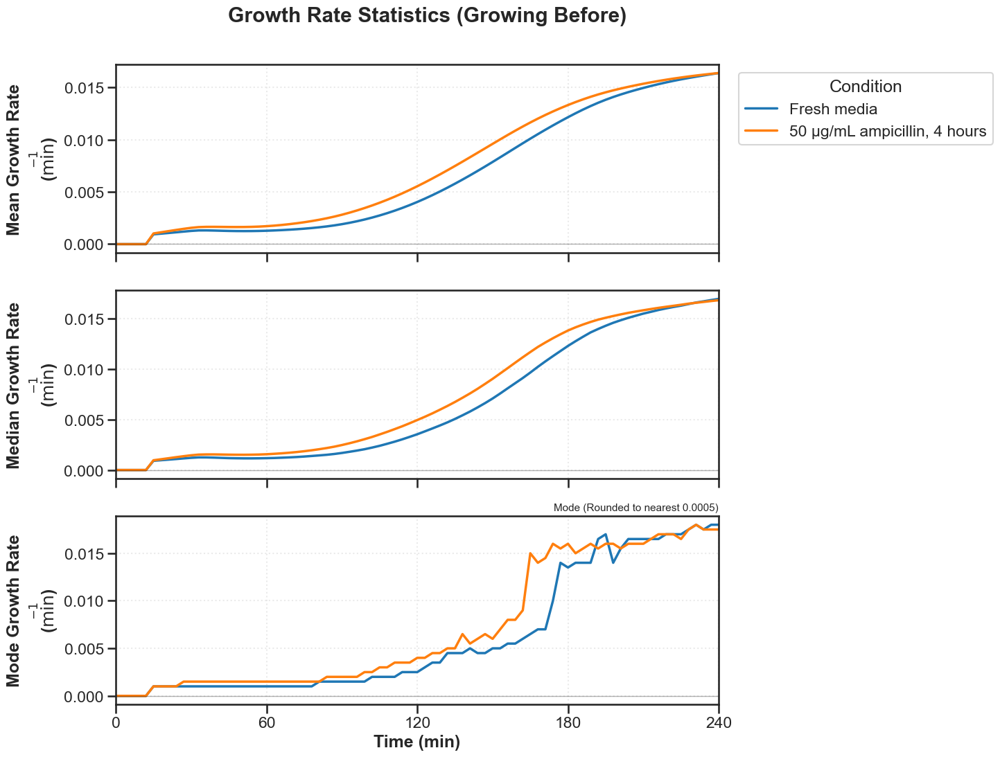

In [42]:
# Plot average growth rates of the entire population within a defined time window
PLOT_XMIN, PLOT_XMAX = (0, 240)

plot_growth_rate_stats_by_condition(
    mother_machine_data,
    treatment_start=treatment_start,
    treatment_end=treatment_end,
    plot_xmin=PLOT_XMIN,
    plot_xmax=PLOT_XMAX,
    require_growing_before=True,
    require_growing_after=False,
    mode_round_interval=0.0005
)

 PLOTTING SLOWDOWN SURVIVOR TRACES 
Found 24656 Slowdown Cells out of 31239 Base Candidates.


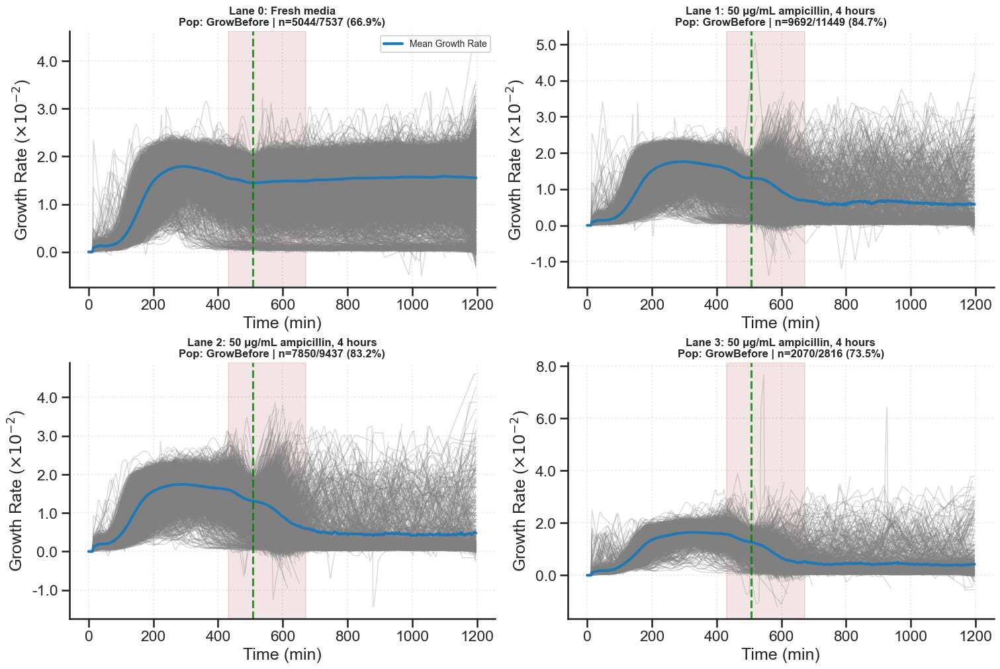

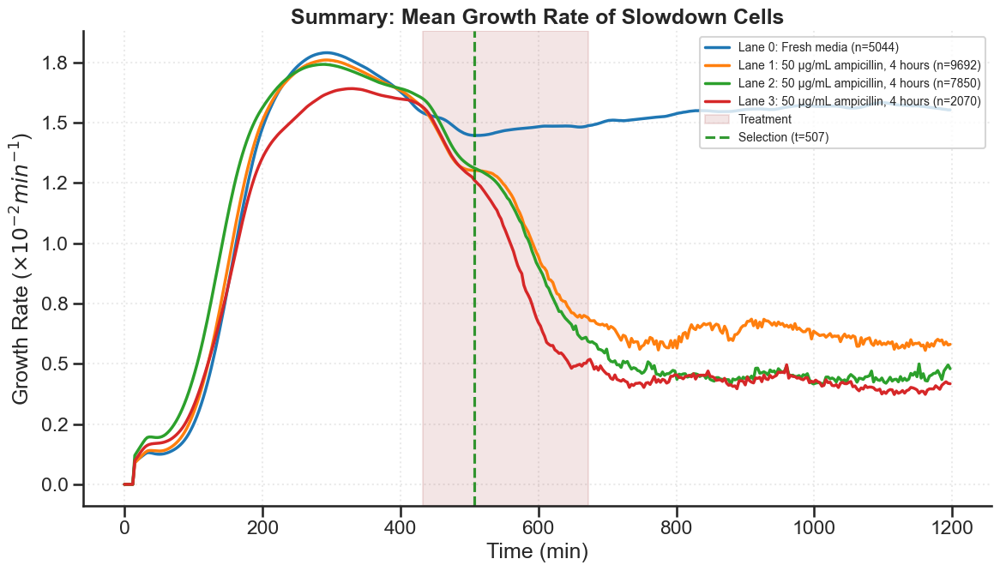

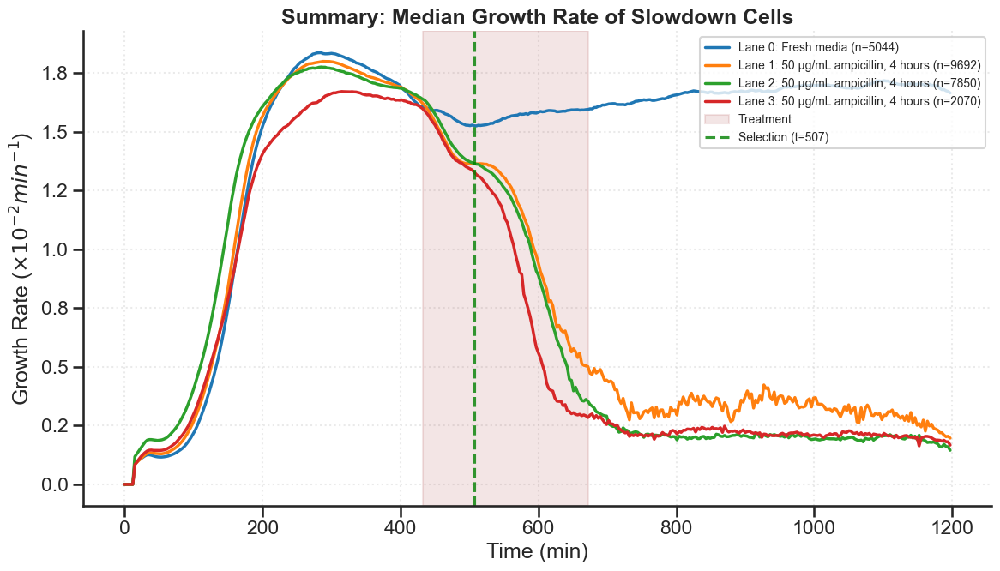

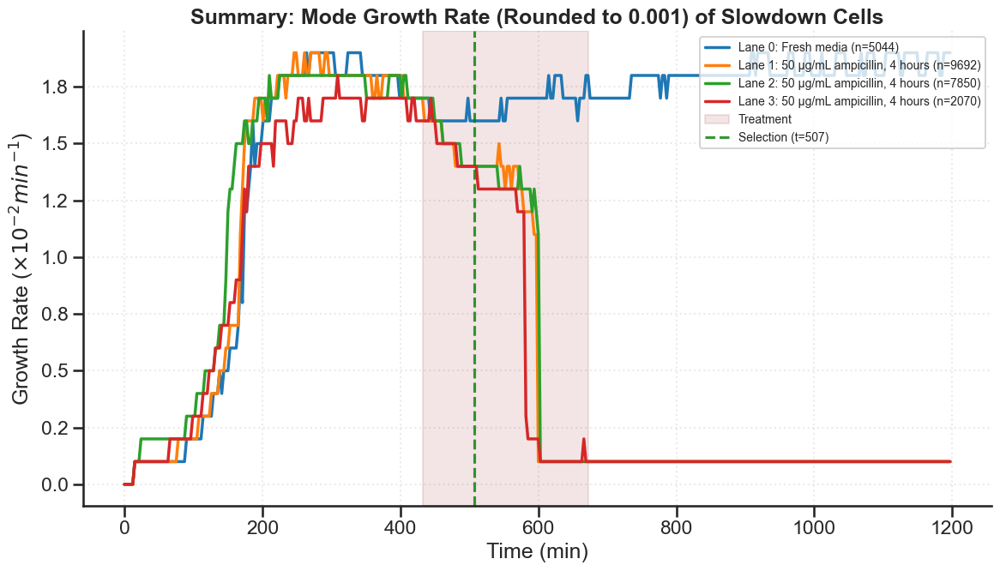

In [43]:
# Plot growth rates of surviving cells that are within a slowdown event at X minutes
check_time = treatment_start + 75 # minutes

plot_slowdown_survivor_growth_rates(
    mother_machine_data, 
    check_time=check_time, 
    treatment_start=treatment_start, 
    treatment_end=treatment_end,
    require_growing_before=True,
    require_growing_after=False,
    mode_round_interval = 0.001
)

 PLOTTING SLOWDOWN SURVIVOR TRACES 
Found 20264 Slowdown Cells out of 31239 Base Candidates.


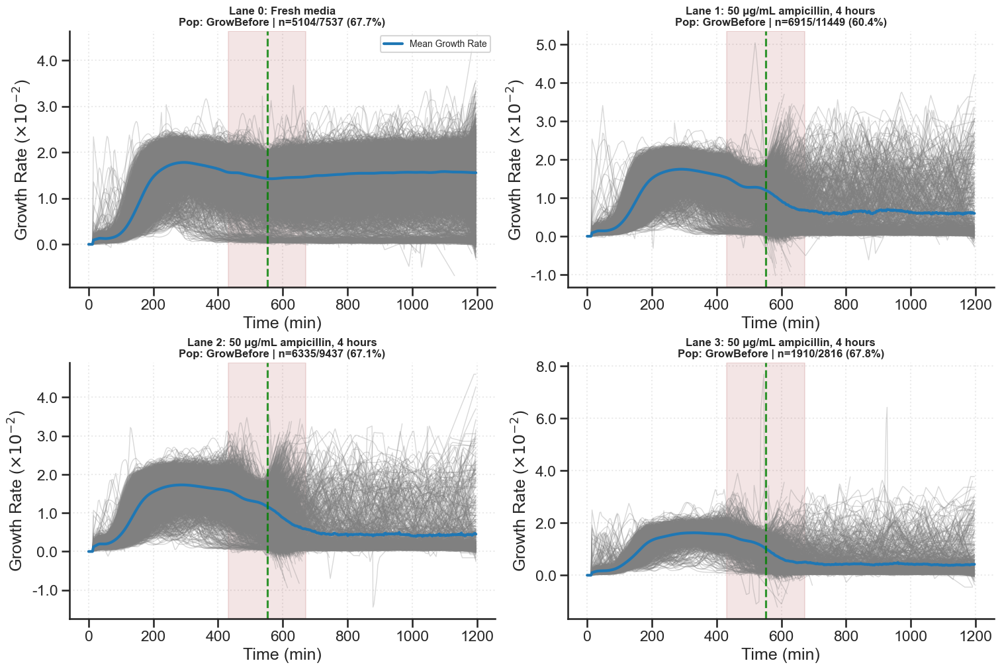

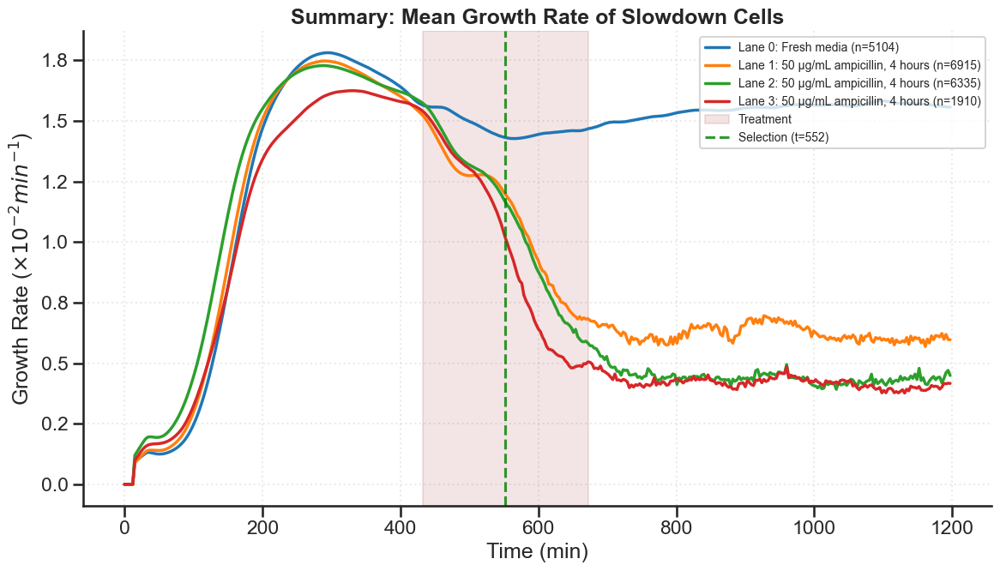

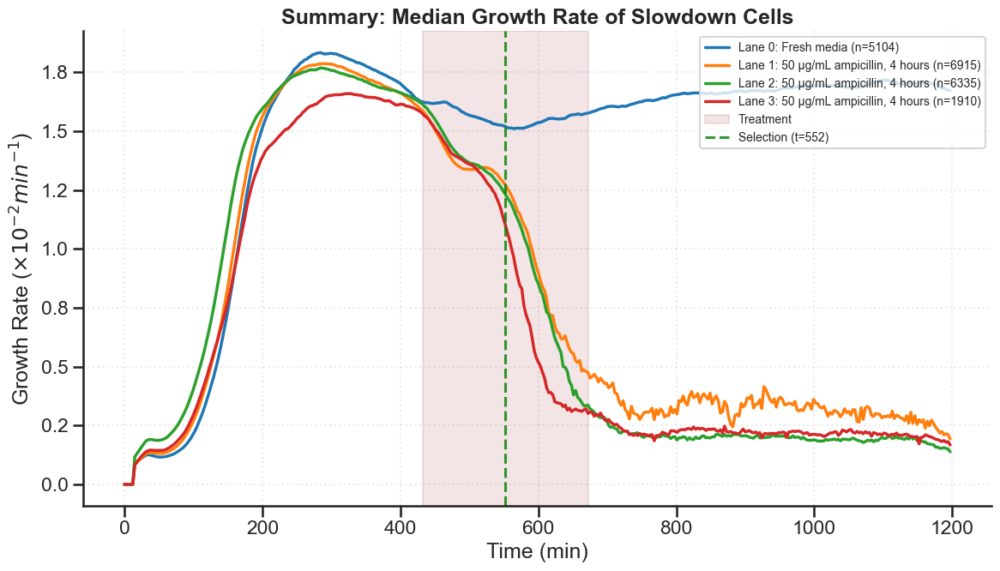

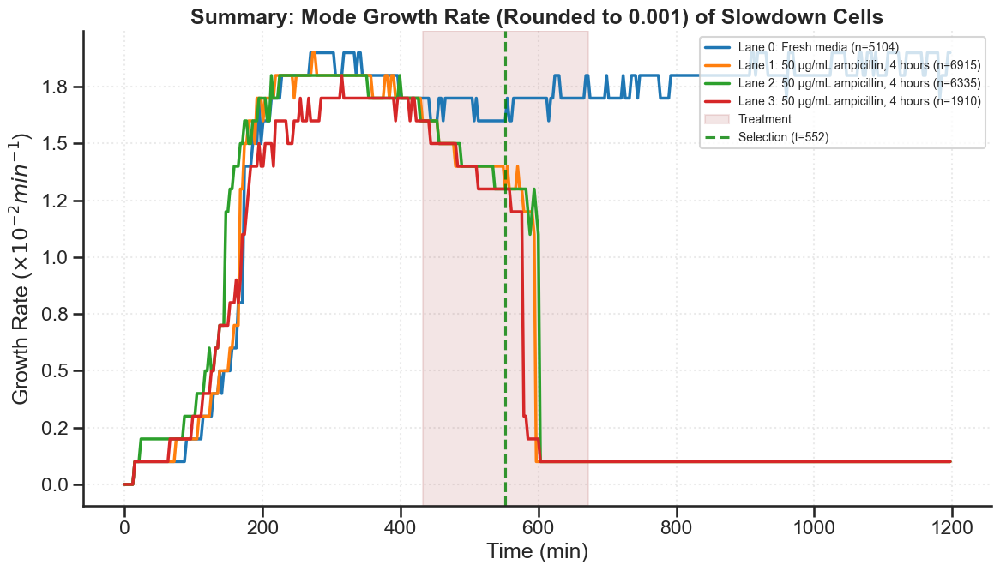

In [44]:
# Plot growth rates of surviving cells that are within a slowdown event at X minutes
check_time = treatment_start + 120 # minutes

plot_slowdown_survivor_growth_rates(
    mother_machine_data, 
    check_time=check_time, 
    treatment_start=locals().get('treatment_start'), 
    treatment_end=locals().get('treatment_end'),
    require_growing_before=True,
    require_growing_after=False,
    mode_round_interval = 0.001
)

 GENERATING SLOWDOWN CELL PDF 
Found 2365 matching cells. Generating PDF...


Generating Pages:   0%|          | 0/2365 [00:00<?, ?it/s]

Exception ignored in: <function tqdm.__del__ at 0x754fd77d1080>
Traceback (most recent call last):
  File "/home/ka537/miniconda3/envs/extraction/lib/python3.11/site-packages/tqdm/std.py", line 1147, in __del__
    def __del__(self):

KeyboardInterrupt: 


KeyboardInterrupt: 

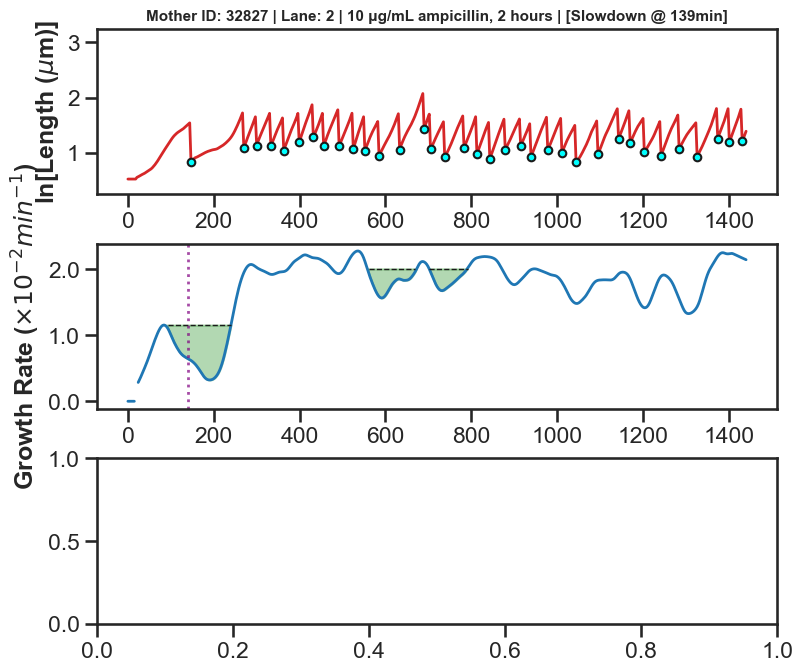

In [66]:
# Create PDF with single-cell traces of these slowdown survivors
check_time = treatment_start + 120 # minutes

generate_slowdown_survivor_pdf(
    df=mother_machine_data,
    slowdown_params=slowdown_params,  # Must be defined earlier
    treatment_start=treatment_start,
    treatment_end=treatment_end,
    check_time=check_time,
    require_growing_before=True,
    require_growing_after=False 
)

 PLOTTING TRACES: SLOWDOWN STARTING 70-90 min 
Found 156 Target Cells out of 19067 Base Candidates.


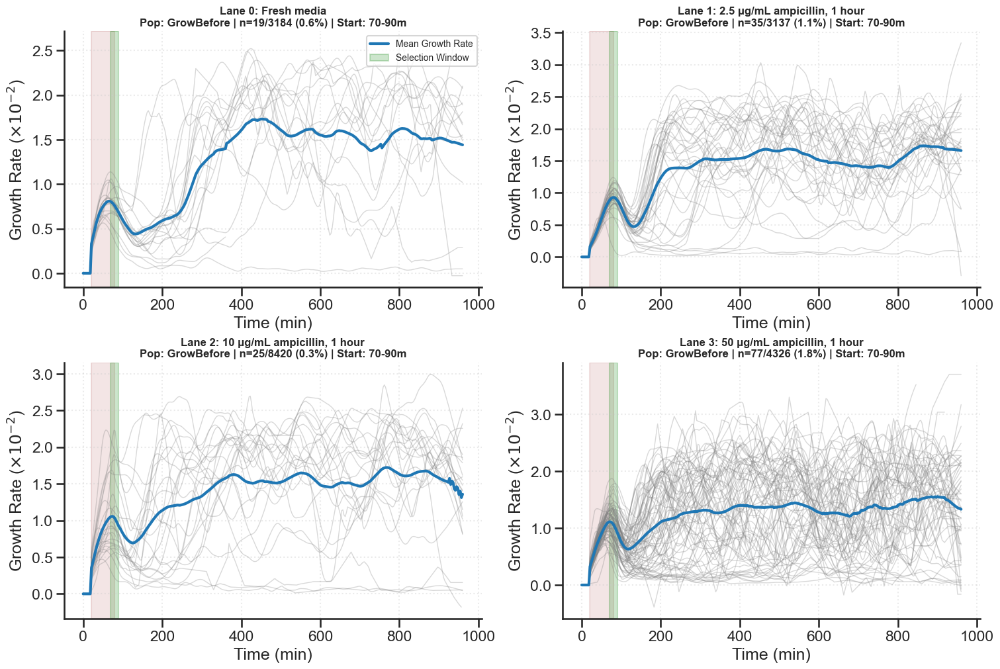

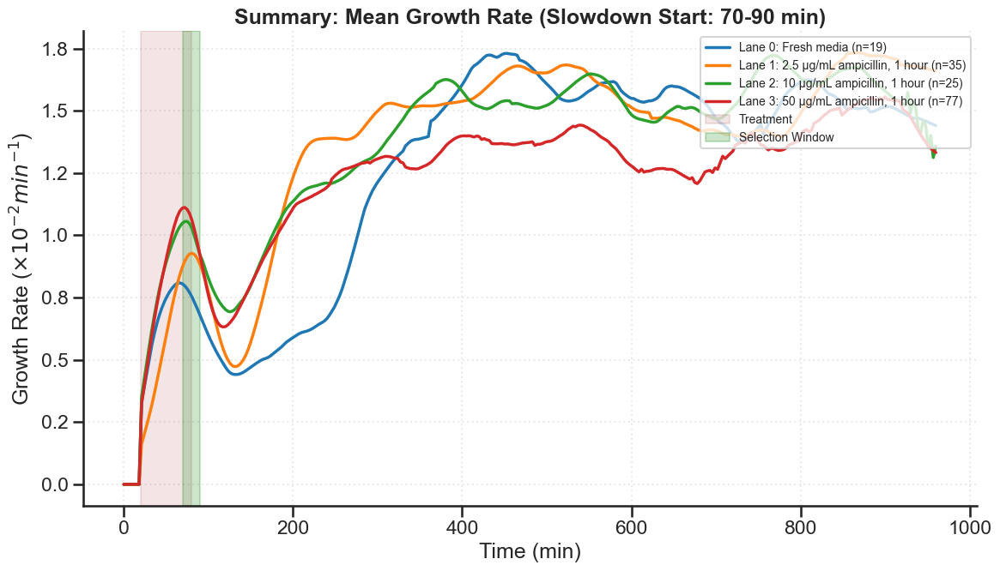

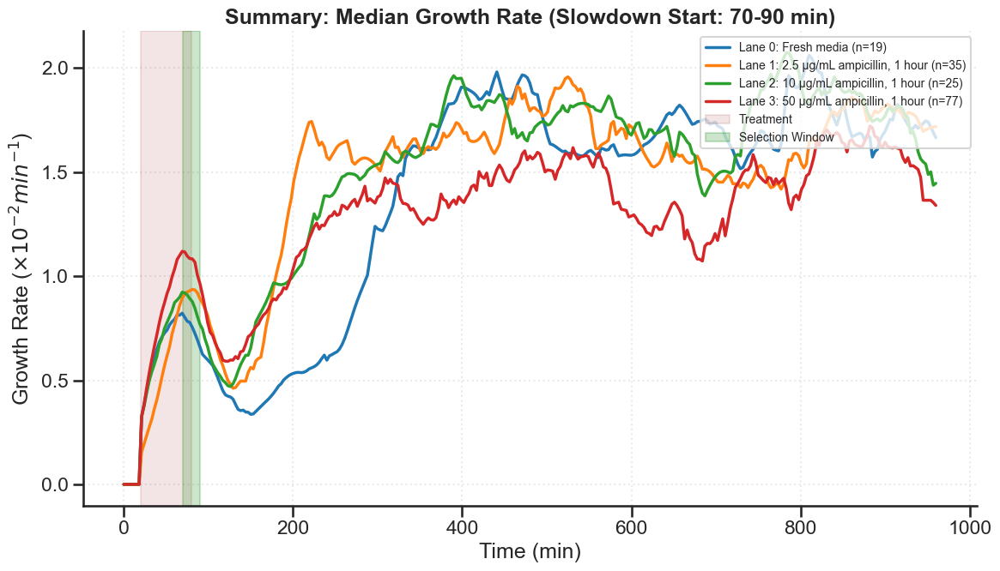

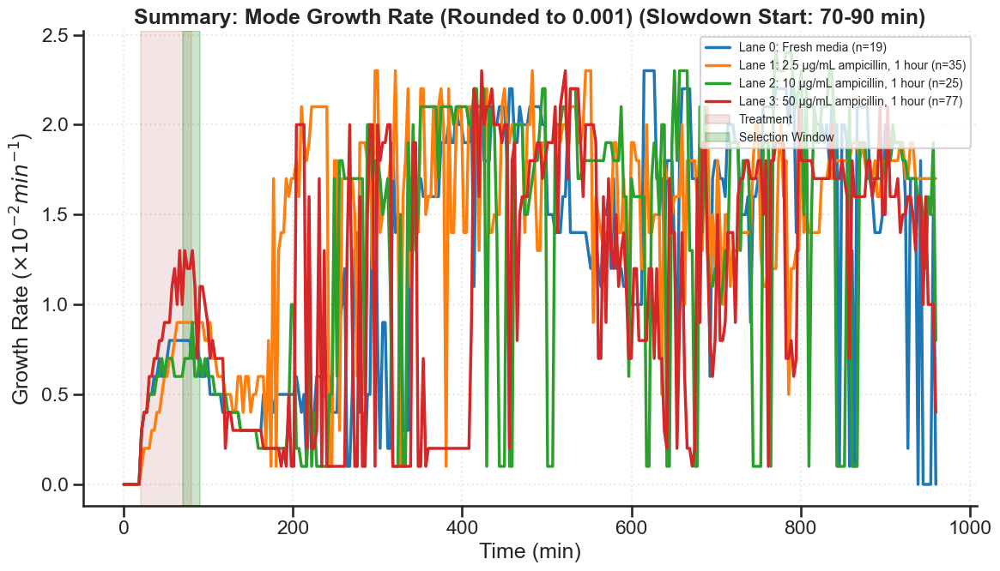

In [71]:
# Plot slowdown events that START between two timepoints
win_start = treatment_start + 50 # minutes
win_end = treatment_start + 70 # minutes

plot_slowdown_survivor_growth_rates_by_window(
    mother_machine_data,
    window_start=win_start,
    window_end=win_end,
    treatment_start=treatment_start,
    treatment_end=treatment_end,
    require_growing_before=True,
    require_growing_after=False,
    mode_round_interval = 0.001
)

 GROWTH RATE DISTRIBUTION (OVERLAID) 
Window: 542.0 min to 562.0 min


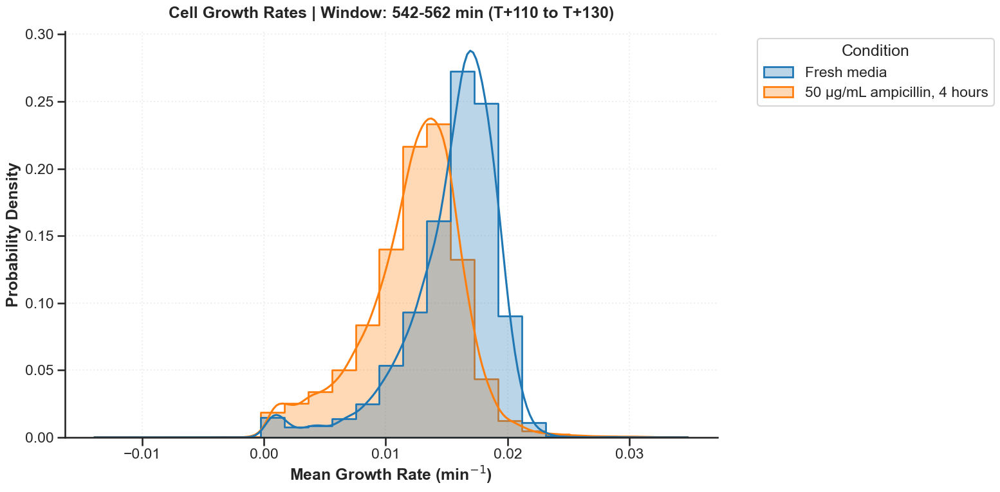

In [45]:
# Growth rate probability distributions of whole population within a time window
win_start = treatment_start + 110 # minutes
win_end = treatment_start + 130 # minutes

plot_survivor_growth_rate_distribution_overlaid(
    mother_machine_data,
    treatment_start=treatment_start,
    win_start=win_start,
    win_end=win_end,
    require_growing_before=True,
    require_growing_after=False,
    bins=25, 
    alpha=0.3 
)

## Lag time analysis

 PLOTTING LAG HISTOGRAMS (NORMALIZED TO INITIAL POPULATION) 
Initial population counts per condition (before 'growing_after' filter):
  - 50 μg/mL ampicillin, 4 hours: 23702 cells
  - Fresh media: 7537 cells


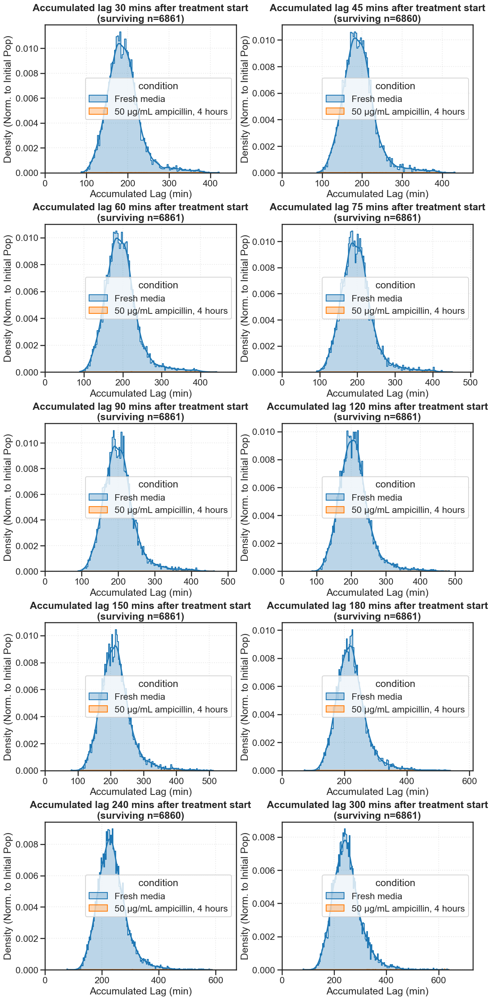

In [46]:
# Plot accumulated lag for time relative to treatment start
plot_lag_histograms(
    mother_machine_data, 
    treatment_start=treatment_start,
    times_relative_to_treatment_start=[30, 45, 60, 75, 90, 120, 150, 180, 240, 300], 
    require_growing_before=True,
    require_growing_after=True,
    bin_width=3   # Adjust to change bin size (minutes)
)

 PLOTTING INTERVAL LAG HISTOGRAMS (NORMALIZED TO INITIAL POPULATION) 


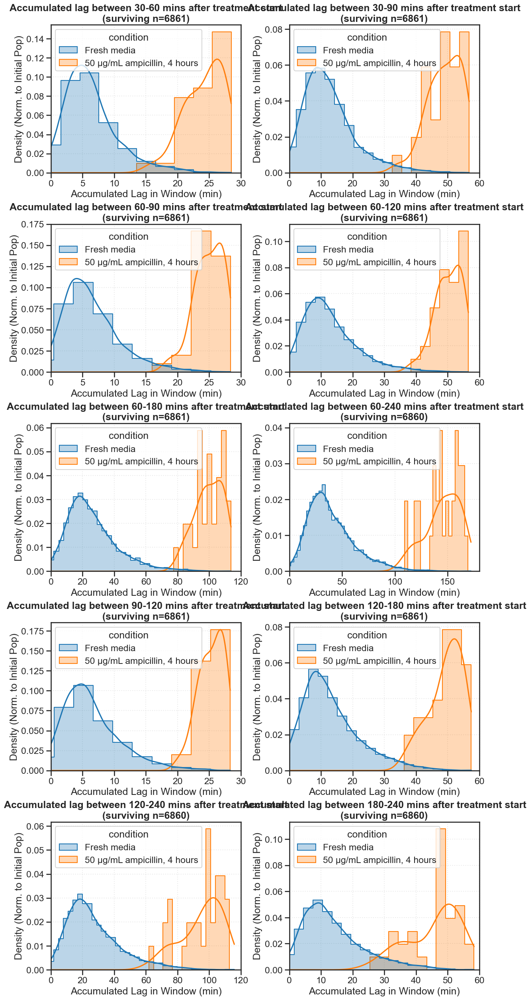

In [47]:
# Plot lag histograms for a given time interval
# Issue with this function? Areas are the same size between conditions when they shouldn't be
plot_interval_lag_histograms(
    mother_machine_data, 
    treatment_start=treatment_start,
    intervals_relative_to_treatment_start=[(30, 60), (30, 90), (60, 90), (60, 120), (60, 180), (60, 240), (90, 120), (120, 180), (120, 240), (180, 240)], 
    require_growing_before=True,
    require_growing_after=True,
    bin_width=3   # Adjust to change bin size (minutes)
)

In [48]:
# Calculate differences in average interval lag between lanes
lag_differences = compare_interval_lag_between_lanes(
    mother_machine_data, 
    treatment_start=treatment_start,
    lane1=0,
    lane2=1,
    interval_start_relative=0,
    times_relative_to_treatment_start=[30, 60, 90, 120, 180, 240], 
    require_growing_before=True,
    require_growing_after=False,
    bin_width=3   # Adjust to change bin size for the mode calculation
)


 COMPARING INTERVAL LAG: LANE 0 vs LANE 1 
 Interval Start: T+0 min
Differences (Lane 0 - Lane 1)
Time   | N1   | N2   | Mean Diff  | Median Diff | Mode Diff
-----------------------------------------------------------------
T+30   | 7500 | 11381 | -0.86      | -0.99       | 0.00     
T+60   | 7493 | 11317 | -3.72      | -4.02       | -6.00    
T+90   | 7486 | 11020 | -7.11      | -7.53       | -6.00    
T+120  | 7473 | 9106 | -11.66     | -12.33      | -15.00   
T+180  | 7459 | 2469 | -35.92     | -35.15      | -42.00   
T+240  | 7443 | 1395 | -49.97     | -52.09      | -66.00   


In [49]:
# Calculate survival percentages grouped by accumulated lag bins
survival_per_bin_df = calculate_survival_per_lag_bin(
    mother_machine_data,
    treatment_start=treatment_start,
    times_relative_to_treatment_start=[30, 60, 90, 120, 180, 240],
    bin_width=3.0,                # Defines 3-minute lag bins
    require_growing_before=True   # Filters to baseline eligible cells
)

survival_per_bin_df


 CALCULATING SURVIVAL PERCENTAGES PER LAG BIN (Width: 3.0m) 


,time_relative,lane,bin_start,bin_label,total_cells,survivors,survival_percentage
0,30,0,81.0,"[81, 84)",1,0,0.000000
1,30,0,87.0,"[87, 90)",2,2,100.000000
2,30,0,93.0,"[93, 96)",2,1,50.000000
3,30,0,99.0,"[99, 102)",4,4,100.000000
4,30,0,102.0,"[102, 105)",9,8,88.888889
...,...,...,...,...,...,...,...
2776,240,3,507.0,"[507, 510)",1,0,0.000000
2777,240,3,519.0,"[519, 522)",1,0,0.000000
2778,240,3,525.0,"[525, 528)",1,1,100.000000
2779,240,3,543.0,"[543, 546)",1,0,0.000000


In [50]:
survival_per_bin_df.query("lane == 1 & time_relative == 240 & bin_start > 150")

,time_relative,lane,bin_start,bin_label,total_cells,survivors,survival_percentage
2390,240,1,153.0,"[153, 156)",2,0,0.0
2391,240,1,156.0,"[156, 159)",5,0,0.0
2392,240,1,159.0,"[159, 162)",6,0,0.0
2393,240,1,162.0,"[162, 165)",5,0,0.0
2394,240,1,165.0,"[165, 168)",7,0,0.0
...,...,...,...,...,...,...,...
2525,240,1,576.0,"[576, 579)",1,1,100.0
2526,240,1,579.0,"[579, 582)",1,1,100.0
2527,240,1,582.0,"[582, 585)",1,1,100.0
2528,240,1,588.0,"[588, 591)",1,1,100.0


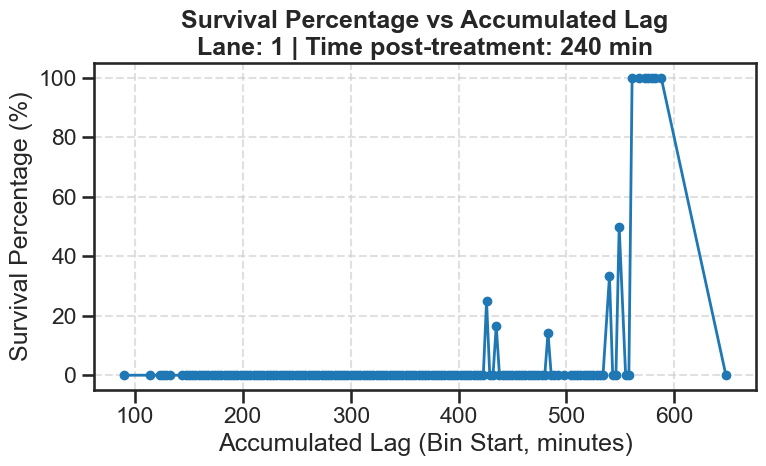

In [58]:
# 2. Create the plot for Lane 0 and Time Relative 240
plot_survival_vs_lag_bin(
    survival_df=survival_per_bin_df,
    lane=1,
    time_relative=240
)

In [84]:
# Simulate shifting the population by +12 minutes with the safeguard enabled
shift_results_df = simulate_population_shift(
    survival_df=survival_per_bin_df,
    lane=1,
    time_relative=240,
    shift_amount=12.0,   # Shifting up 4 bins (if bin_width is 3.0)
    safeguard=True       # Prevents expected survival from dropping below source bin
)



 SIMULATED POPULATION SHIFT: +12.0 mins
 Lane: 1 | Time Relative: 240 min
 Safeguard Enabled: True
Total Eligible Population (growing_before=True) : 1045
Original Survivors before shift                 : 29 (2.78%)
Expected Survivors after shift                  : 50.9 (4.87%)
Difference in Survivors                         : +21.9



In [37]:
# Generate plots for the single cells within specific slices of the above plots 
generate_interval_lag_pdf(
    mother_machine_data, 
    treatment_start=treatment_start,
    treatment_end=treatment_end,
    interval_relative_to_treatment_start=(30, 90), # define the interval region from above to look at
    min_lag_amount=30, # define the accumulated lag range to look at
    max_lag_amount=33,
    require_growing_before=True,
    require_growing_after=False,
    max_IDs_per_condition=500
)

 GENERATING INTERVAL LAG PDF
 Interval: T+60 to T+240 min
 Target Lag Range: 100 to 103 min (inclusive)
Generating PDF: interval_lag_100to103m_report_20260219_201800.pdf...
  - Fresh media: Plotting all 10 cells


Plotting Fresh media:   0%|          | 0/10 [00:00<?, ?it/s]

  - 10 μg/mL ampicillin, 1 hour: Plotting all 28 cells


Plotting 10 μg/mL ampicillin, 1 hour:   0%|          | 0/28 [00:00<?, ?it/s]

  - 50 μg/mL ampicillin, 1 hour: Plotting all 20 cells


Plotting 50 μg/mL ampicillin, 1 hour:   0%|          | 0/20 [00:00<?, ?it/s]

Done. Report saved to /mnt/ka_gh_storage/2025_11_27_40x_persister_1HourAmpicillinTreatments/interval_lag_100to103m_report_20260219_201800.pdf


## Slowdown analysis

In [6]:
idxs = mother_machine_data.query("slowdown == True").groupby("mother_id")["current_lost_time"].idxmax()

In [7]:
max_lost_time = mother_machine_data.loc[idxs]

<Axes: xlabel='current_slowdown_duration', ylabel='current_lost_time'>

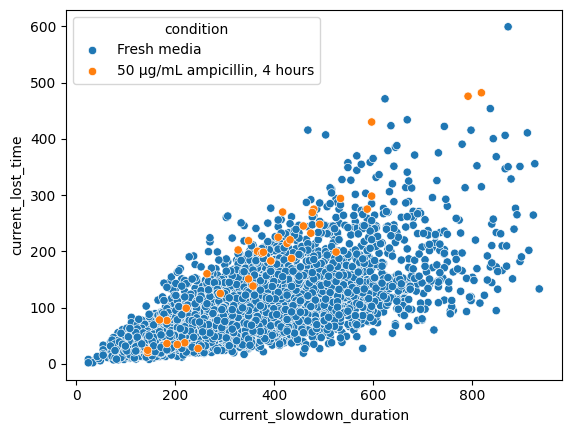

In [8]:
sns.scatterplot(data = max_lost_time.query("growing_after == True"), y = "current_lost_time", x = "current_slowdown_duration", hue = "condition")

In [9]:
# Manually review possible outliers missed by general code

In [10]:
check_these_idxs = (max_lost_time.query("growing_after == True")["current_lost_time"]/max_lost_time.query("growing_after == True")["current_slowdown_duration"]) > 0.45

In [11]:
max_lost_time.query("growing_after == True")[check_these_idxs]

,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,...,slowdown_start,slowdown_end,current_slowdown_duration,total_slowdown_duration,current_lost_time,total_lost_time,growing_before,growing_after,accum_lag_current,accum_lag_total
3897,390,237,711,2.193571,1.161839,1.976533,0.785531,0.681344,PC,16534.245033,...,384.0,711.0,327.0,327.0,164.245501,164.245501,True,True,416.707624,546.785522
14584,421,399,1197,2.470631,1.085454,2.074705,0.904474,0.729819,PC,23457.261830,...,999.0,1197.0,198.0,198.0,105.161252,105.161252,True,True,438.468634,438.468634
17439,430,325,975,3.072246,1.211800,2.905896,1.122409,1.066742,PC,15796.103604,...,558.0,975.0,417.0,417.0,206.662376,206.662376,True,True,416.315191,462.441601
22222,442,399,1197,2.457029,1.209707,2.303773,0.898953,0.834548,PC,16782.616477,...,840.0,1197.0,357.0,357.0,197.991867,197.991867,True,True,679.240500,679.240500
36818,484,159,477,2.285832,1.176654,2.100884,0.826730,0.742358,PC,20885.965732,...,408.0,477.0,69.0,69.0,38.887458,38.887458,True,True,249.994830,418.260762
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8647800,42265,258,774,3.236889,1.232652,3.089150,1.174613,1.127896,PC,29684.972458,...,342.0,774.0,432.0,432.0,220.495994,220.495994,True,True,344.425378,395.076461
8915584,43571,249,747,4.356361,1.330508,4.489740,1.471637,1.501795,PC,27350.596210,...,354.0,747.0,393.0,393.0,182.990122,182.990122,True,True,585.693721,797.360976
9110520,44448,265,795,5.727147,1.369007,6.060494,1.745218,1.801791,PC,23249.767819,...,531.0,795.0,264.0,264.0,160.211749,160.211749,False,True,305.441539,348.303641
10864700,50959,399,1197,2.532693,1.353019,2.663738,0.929283,0.979730,PC,27770.083538,...,378.0,1197.0,819.0,819.0,481.792510,481.792510,True,True,667.287582,667.287582


In [12]:
# --- REFRESH DATA & RESET COUNTER ---
print("Refreshing candidate list based on new data/filters...")

# Call the function defined previously
mother_ids_cached = get_candidate_mothers(mother_machine_data, max_lost_time, check_these_idxs)

# Reset the plot index to the beginning
plot_idx = 0 

print(f"DONE. Found {len(mother_ids_cached)} mothers. \nRun the next cell to start plotting.")

Refreshing candidate list based on new data/filters...
DONE. Found 308 mothers. 
Run the next cell to start plotting.


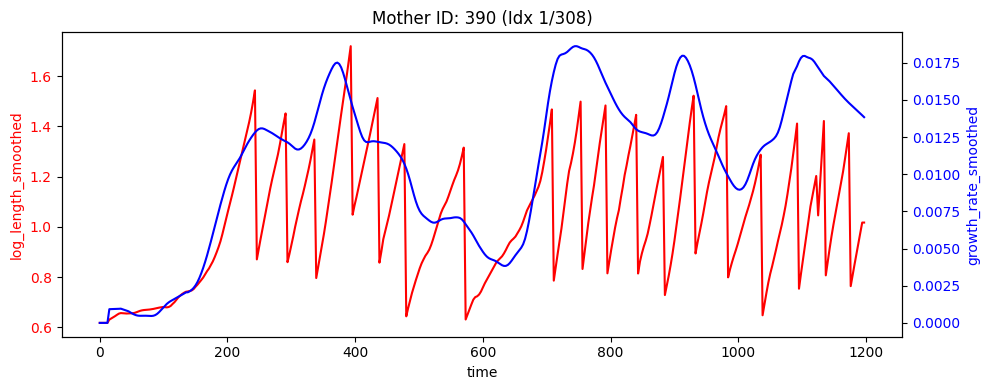

In [13]:
# --- PLOT & INCREMENT ---
n = len(mother_ids_cached)

if n > 0:
    # 1. Clamp index (safety check in case list size shrank)
    plot_idx = min(plot_idx, n - 1)
    
    # 2. Get ID and Plot
    current_id = mother_ids_cached[plot_idx]
    plot_single_mother(mother_machine_data, current_id, plot_idx + 1, n)
    
    # 3. Increment for next execution
    if plot_idx < n - 1:
        plot_idx += 1
    else:
        print(f"Reached end of list ({n}). Set 'plot_idx = 0' in the previous cell to restart.")
else:
    print("No matching mothers found in the current list.")

In [14]:
# set to growing_after = False and re-run
bad_mother_ids = [528, 3111, 10128, 11027, 13391, 14470, 3275, 10246, 13006, 44275, 3344, 2535, 3344] # add manually (should probably make a cleaner napari hotkey version of this code, but this works for now)
mother_machine_data.loc[mother_machine_data["mother_id"].isin(bad_mother_ids), "growing_after"] = False

In [15]:
# Exclude exposure-limited survivors (i.e. slow growth rate from the start)
# Create the filtered dataframe
max_lost_time_slowdown = filter_fast_survivors(
    max_lost_time,
    mother_machine_data,
    fresh_media_start, 
    treatment_start,
    top_percent=10,      # top 10% of growth_rate_smoothed values before treatment_start have to exceed gr_threshold
    gr_threshold=1.5     #x10^-2, growth_rate_smoothed threshold
)

Original survivors in target lanes: 6845
Filtered survivors (Top 10% GR >= 1.5 x 10^-2 between 12 and 432 min): 6528


In [16]:
max_lost_time_slowdown.query("lane == [1,2,3]")["mother_id"].nunique()

14

In [43]:
# Plots for cleaned data

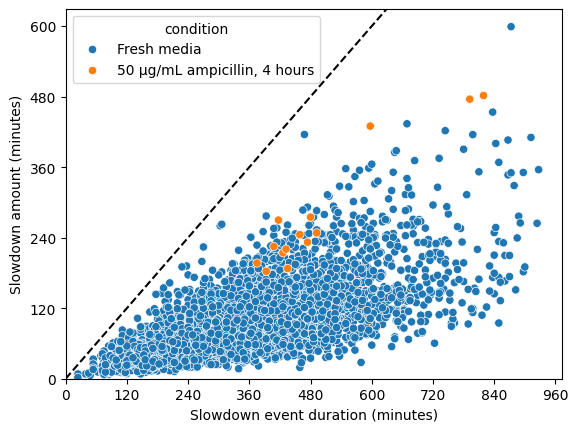

In [17]:
ax = sns.scatterplot(
    data=max_lost_time_slowdown, 
    y="current_lost_time", 
    x="current_slowdown_duration", 
    hue="condition"
)

# Set axis labels
ax.set_ylabel("Slowdown amount (minutes)")
ax.set_xlabel("Slowdown event duration (minutes)")
ax.set_xlim(left=0)
ax.set_ylim(bottom=0)

# Set x-axis ticks every 120 minutes
ax.xaxis.set_major_locator(ticker.MultipleLocator(120))
ax.yaxis.set_major_locator(ticker.MultipleLocator(120))

# Add a dashed 1:1 line
# We calculate the max extent to ensure the line covers the data
x0, x1 = ax.get_xlim()
y0, y1 = ax.get_ylim()
limit = max(x1, y1)
plt.plot([0, limit], [0, limit], color='black', linestyle='--')

plt.savefig("2_conditions.png", dpi=300)
plt.show()

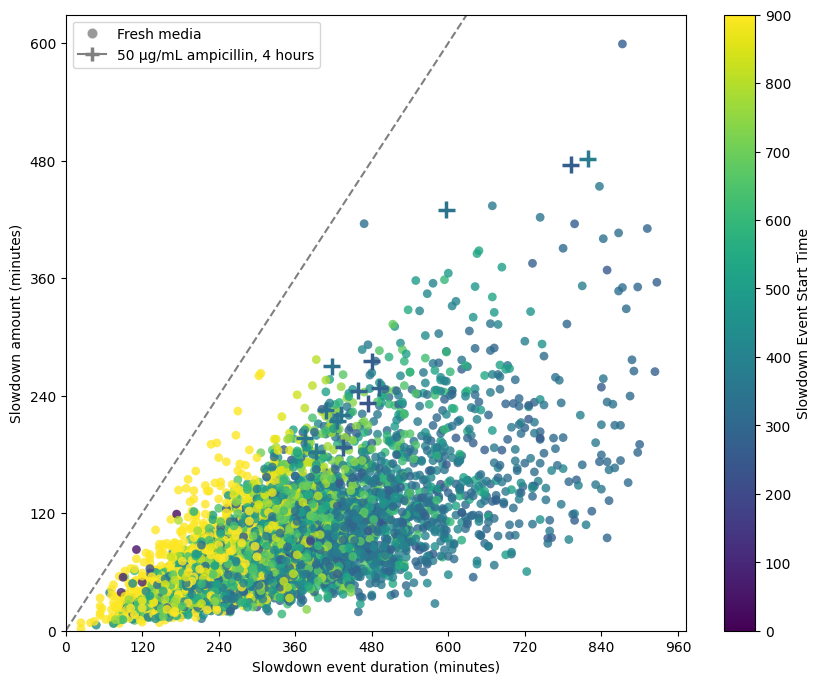

In [18]:
# --- 1. CONFIGURATION SECTION (Modify these values) ---
# Circles (Common Condition)
CIRCLE_SIZE = 40
CIRCLE_ALPHA = 0.8      # 0.0 is invisible, 1.0 is solid
CIRCLE_LINEWIDTH = 0    # 0 for no border

# Pluses (Rare Condition)
PLUS_SIZE = 150         # Reduced from 200/250
PLUS_ALPHA = 1.0        # Keep opaque to pop out
PLUS_LINEWIDTH = 2.5    # Thickness of the plus lines

# ------------------------------------------------------

# 2. Prepare Data
# Use the filtered dataframe directly (already ensures survivors)
plot_data = max_lost_time_slowdown.copy()
plot_data['start_time'] = plot_data['slowdown_start']

# 3. Identify Conditions
counts = plot_data['condition'].value_counts()
cond_plus = counts.idxmin()   # Rare -> Plus
cond_circle = counts.idxmax() # Common -> Circle

df_circles = plot_data[plot_data['condition'] == cond_circle]
df_pluses = plot_data[plot_data['condition'] == cond_plus]

# 4. Setup Plot
plt.figure(figsize=(10, 8))
norm = plt.Normalize(vmin=0, vmax=900)
cmap = sns.color_palette("viridis", as_cmap=True)

# 5. Plot Circles (Background)
ax = sns.scatterplot(
    data=df_circles,
    x="current_slowdown_duration",
    y="current_lost_time",
    hue="start_time",
    palette=cmap, hue_norm=norm,
    marker='o',
    s=CIRCLE_SIZE,
    linewidth=CIRCLE_LINEWIDTH,
    alpha=CIRCLE_ALPHA,
    zorder=1, legend=False
)

# 6. Plot Pluses (Foreground)
sns.scatterplot(
    data=df_pluses,
    x="current_slowdown_duration",
    y="current_lost_time",
    hue="start_time",
    palette=cmap, hue_norm=norm,
    marker='+',
    s=PLUS_SIZE,
    linewidth=PLUS_LINEWIDTH,
    alpha=PLUS_ALPHA,
    zorder=2, legend=False, ax=ax
)

# 7. Add Colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, label="Slowdown Event Start Time")

# 8. Custom Legend
legend_elements = [
    mlines.Line2D([0], [0], marker='o', color='w', markerfacecolor='gray', 
                  label=cond_circle, markersize=8, alpha=CIRCLE_ALPHA), 
    mlines.Line2D([0], [0], marker='+', color='gray', 
                  label=cond_plus, markersize=10, markeredgewidth=PLUS_LINEWIDTH)
]
ax.legend(handles=legend_elements, loc='upper left')

# 9. Formatting
ax.set_ylabel("Slowdown amount (minutes)")
ax.set_xlabel("Slowdown event duration (minutes)")

# Set x-axis and y-axis ticks every 120 minutes
ax.xaxis.set_major_locator(ticker.MultipleLocator(120))
ax.yaxis.set_major_locator(ticker.MultipleLocator(120))

ax.set_xlim(left=0)
ax.set_ylim(bottom=0)

# 1:1 Line
x0, x1 = ax.get_xlim()
y0, y1 = ax.get_ylim()
limit = max(x1, y1)
plt.plot([0, limit], [0, limit], color='black', linestyle='--', alpha=0.5, zorder=0)

plt.savefig("start_time_colour_bar.png", dpi=300)
plt.show()

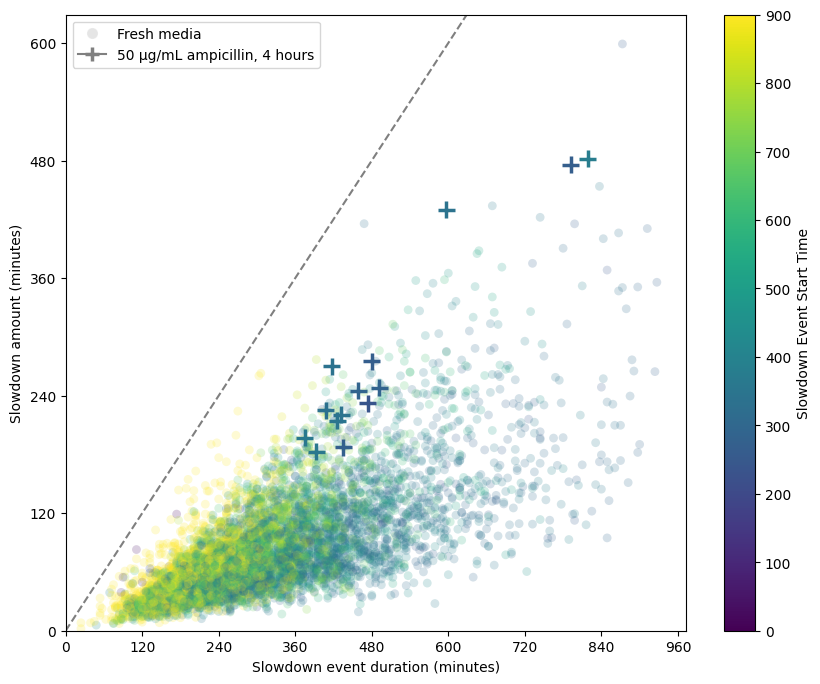

In [19]:
# --- 1. CONFIGURATION SECTION (Modify these values) ---
# Circles (Common Condition)
CIRCLE_SIZE = 40
CIRCLE_ALPHA = 0.2      # 0.0 is invisible, 1.0 is solid
CIRCLE_LINEWIDTH = 0    # 0 for no border

# Pluses (Rare Condition)
PLUS_SIZE = 150         # Reduced from 200/250
PLUS_ALPHA = 1.0        # Keep opaque to pop out
PLUS_LINEWIDTH = 2.5    # Thickness of the plus lines

# ------------------------------------------------------

# 2. Prepare Data
# Use the filtered dataframe directly (already ensures survivors)
plot_data = max_lost_time_slowdown.copy()
plot_data['start_time'] = plot_data['slowdown_start']

# 3. Identify Conditions
counts = plot_data['condition'].value_counts()
cond_plus = counts.idxmin()   # Rare -> Plus
cond_circle = counts.idxmax() # Common -> Circle

df_circles = plot_data[plot_data['condition'] == cond_circle]
df_pluses = plot_data[plot_data['condition'] == cond_plus]

# 4. Setup Plot
plt.figure(figsize=(10, 8))
norm = plt.Normalize(vmin=0, vmax=900)
cmap = sns.color_palette("viridis", as_cmap=True)

# 5. Plot Circles (Background)
ax = sns.scatterplot(
    data=df_circles,
    x="current_slowdown_duration",
    y="current_lost_time",
    hue="start_time",
    palette=cmap, hue_norm=norm,
    marker='o',
    s=CIRCLE_SIZE,
    linewidth=CIRCLE_LINEWIDTH,
    alpha=CIRCLE_ALPHA,
    zorder=1, legend=False
)

# 6. Plot Pluses (Foreground)
sns.scatterplot(
    data=df_pluses,
    x="current_slowdown_duration",
    y="current_lost_time",
    hue="start_time",
    palette=cmap, hue_norm=norm,
    marker='+',
    s=PLUS_SIZE,
    linewidth=PLUS_LINEWIDTH,
    alpha=PLUS_ALPHA,
    zorder=2, legend=False, ax=ax
)

# 7. Add Colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, label="Slowdown Event Start Time")

# 8. Custom Legend
legend_elements = [
    mlines.Line2D([0], [0], marker='o', color='w', markerfacecolor='gray', 
                  label=cond_circle, markersize=8, alpha=CIRCLE_ALPHA), 
    mlines.Line2D([0], [0], marker='+', color='gray', 
                  label=cond_plus, markersize=10, markeredgewidth=PLUS_LINEWIDTH)
]
ax.legend(handles=legend_elements, loc='upper left')

# 9. Formatting
ax.set_ylabel("Slowdown amount (minutes)")
ax.set_xlabel("Slowdown event duration (minutes)")

# Set x-axis and y-axis ticks every 120 minutes
ax.xaxis.set_major_locator(ticker.MultipleLocator(120))
ax.yaxis.set_major_locator(ticker.MultipleLocator(120))

ax.set_xlim(left=0)
ax.set_ylim(bottom=0)

# 1:1 Line
x0, x1 = ax.get_xlim()
y0, y1 = ax.get_ylim()
limit = max(x1, y1)
plt.plot([0, limit], [0, limit], color='black', linestyle='--', alpha=0.5, zorder=0)

plt.savefig("start_time_colour_bar_focusOnTreated.png", dpi=300)
plt.show()

In [20]:
# Combine plots

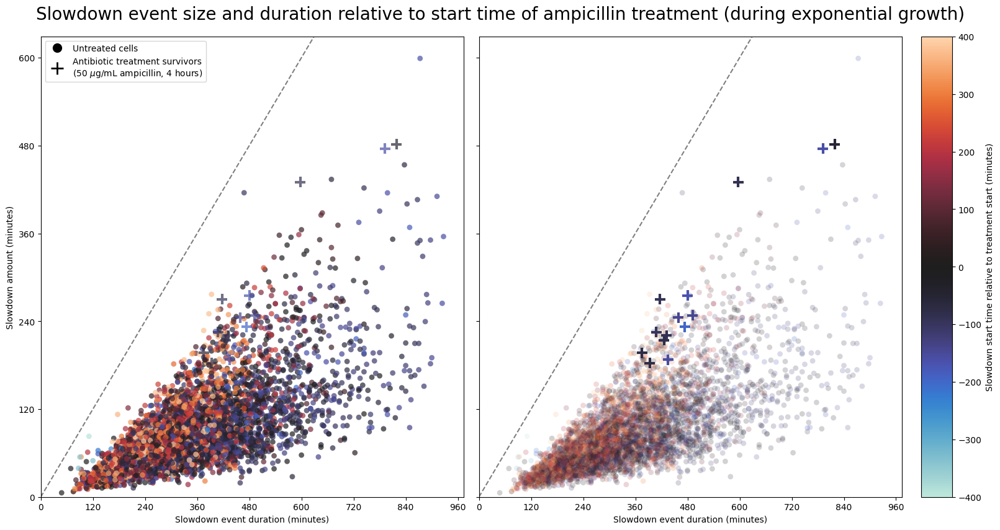

In [24]:
# --- 1. CONFIGURATION ---
# Labels
LABEL_UNTREATED = "Untreated cells"
LABEL_TREATED = "Antibiotic treatment survivors\n" + r"(50 $\mu$g/mL ampicillin, 4 hours)"

# Style Settings
# Left Plot: Slight transparency for both
STYLE_LEFT = {
    'common': {'marker': 'o', 's': 40,  'alpha': 0.7, 'linewidth': 0,   'zorder': 1},
    'rare':   {'marker': '+', 's': 150, 'alpha': 0.7, 'linewidth': 3, 'zorder': 2}
}

# Right Plot: High transparency background (faint), Opaque foreground
STYLE_RIGHT = {
    'common': {'marker': 'o', 's': 40,  'alpha': 0.2, 'linewidth': 0,   'zorder': 1},
    'rare':   {'marker': '+', 's': 150, 'alpha': 1.0, 'linewidth': 3, 'zorder': 2}
}

# --- 2. PREPARE DATA ---
# Use the newly filtered dataframe directly
df = max_lost_time_slowdown.copy()

# Calculate relative to treatment_start
df['rel_start_time'] = df['slowdown_start'] - treatment_start

# FILTER: Limit the points shown to only be between -400 and 400 minutes
df = df[(df['rel_start_time'] >= -400) & (df['rel_start_time'] <= 400)]

# Identify conditions dynamically
cond_untreated = df['condition'].mode()[0]             # Common (Circles)
cond_treated = df['condition'].value_counts().idxmin() # Rare (Crosses)

# --- 3. CUSTOM COLORMAP & NORM ---
# Gradient: Seaborn's icefire palette
cmap = sns.color_palette("icefire", as_cmap=True)

# Center the map around 0, strictly bounding it between -400 and 400
norm = mcolors.TwoSlopeNorm(vcenter=0, vmin=-400, vmax=400)

# --- 4. SETUP GRID ---
fig, axs = plt.subplots(1, 2, figsize=(16, 8), sharey=True, sharex=True, constrained_layout=True)

# --- 5. PLOT LEFT PANEL (Standard View) ---
ax_left = axs[0]

# Plot Untreated (Circles)
sns.scatterplot(
    data=df[df['condition'] == cond_untreated],
    x="current_slowdown_duration",
    y="current_lost_time",
    hue="rel_start_time",
    palette=cmap, hue_norm=norm,
    ax=ax_left,
    legend=False,
    **STYLE_LEFT['common']
)

# Plot Treated (Crosses)
sns.scatterplot(
    data=df[df['condition'] == cond_treated],
    x="current_slowdown_duration",
    y="current_lost_time",
    hue="rel_start_time",
    palette=cmap, hue_norm=norm,
    ax=ax_left,
    legend=False,
    **STYLE_LEFT['rare']
)

# --- CUSTOM LEGEND (Left Panel Only) ---
legend_elements = [
    # Circle: Black face, no edge, increased size
    mlines.Line2D([], [], marker='o', color='w', markerfacecolor='black', 
                  label=LABEL_UNTREATED, markersize=12, alpha=1.0), 
    
    # Plus: Black color, increased size
    mlines.Line2D([], [], marker='+', color='black', linestyle='None',
                  label=LABEL_TREATED, markersize=14, markeredgewidth=2.0)
]

# frameon=True ensures the box is drawn
ax_left.legend(handles=legend_elements, loc='upper left', frameon=True)

# --- 6. PLOT RIGHT PANEL (Focused View) ---
ax_right = axs[1]

# Plot Untreated (Very Faint)
sns.scatterplot(
    data=df[df['condition'] == cond_untreated],
    x="current_slowdown_duration",
    y="current_lost_time",
    hue="rel_start_time",
    palette=cmap, hue_norm=norm,
    ax=ax_right,
    legend=False,
    **STYLE_RIGHT['common']
)

# Plot Treated (Opaque)
sns.scatterplot(
    data=df[df['condition'] == cond_treated],
    x="current_slowdown_duration",
    y="current_lost_time",
    hue="rel_start_time",
    palette=cmap, hue_norm=norm,
    ax=ax_right,
    legend=False,
    **STYLE_RIGHT['rare']
)

# --- 7. FORMATTING ---
# Global Title
fig.suptitle("Slowdown event size and duration relative to start time of ampicillin treatment (during exponential growth)", fontsize=20, y=1.05)

for ax in axs:
    ax.set_xlabel("Slowdown event duration (minutes)")
    
    # Set x and y axis ticks every 120 minutes
    ax.xaxis.set_major_locator(ticker.MultipleLocator(120))
    ax.yaxis.set_major_locator(ticker.MultipleLocator(120))
    
    # 1:1 Line
    ax.axline((0, 0), slope=1, color='black', linestyle='--', alpha=0.5, zorder=0)
    
    # Ensure plots start from 0
    ax.set_xlim(left=0)
    ax.set_ylim(bottom=0)

# Y-Label only on left
axs[0].set_ylabel("Slowdown amount (minutes)")
axs[1].set_ylabel("")

# Shared Colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# aspect=15 (Thicker), pad=0.02 (Gap)
cbar = fig.colorbar(sm, ax=axs, label="Slowdown start time relative to treatment start (minutes)", 
                    aspect=15, pad=0.02)

plt.savefig("combined_comparison_plot_final.png", dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
# Slowdown histograms

In [ ]:
# [Add new versions]

## Cell classification

In [4]:
mother_machine_data.query("time==0")[["lane", "condition"]].value_counts()

lane  condition                   
2     50 μg/mL ampicillin, 4 hours    14397
1     50 μg/mL ampicillin, 4 hours    13169
3     50 μg/mL ampicillin, 4 hours    10295
0     Fresh media                      9081
Name: count, dtype: int64

In [ ]:
# TO-DO: add improved lysis/cell death artefact detection (& removal), e.g. when cells lyse and masks get much smaller and stay small, or when they die and stay large (or decrease slightly over time)

In [8]:
# Napari manual survivor classification (remove remaining artefacts & manually classify persisters at the same time)

include_lanes       = [1, 2, 3]
MAX_T_FOR_REVIEW    = None
TRENCHES_FILE       = "trenches.zarr"
MASKS_FILTERED_FILE = "masks_upscaled_filtered.zarr"
RESULTS_JSON_FILE   = "classification_results.json"

# --- 2. INITIALIZE VARIABLES (without overwriting existing memory) ---
if 'discard_mother_ids' not in locals():
    discard_mother_ids, persister_mother_ids, survivor_mother_ids, classification_cache = [], [], [], {}

# --- 3. START CLASSIFICATION ---
start_classification_session(
    mother_machine_data=mother_machine_data, 
    treatment_start=treatment_start, 
    treatment_end=treatment_end,
    config=config,
    discard_list=discard_mother_ids,
    persister_list=persister_mother_ids,
    survivor_list=survivor_mother_ids,
    cache_dict=classification_cache,
    save_filepath=RESULTS_JSON_FILE,
    trenches_file=TRENCHES_FILE,
    masks_file=MASKS_FILTERED_FILE,
    include_lanes=include_lanes,
    max_t_for_review=MAX_T_FOR_REVIEW
)

Initializing classification session...
Resuming active session. Found 34 classified cells in memory.
All selected survivors have been classified!

------------------------------
   CLASSIFICATION SUMMARY   
------------------------------
Total Initial Cells    : 34
Classified so far      : 34 / 34
  - Discarded          : 0
  - Standard Survivors : 34
  - Persisters         : 0
------------------------------



In [ ]:
# Manually discard mother_ids
manual_discard_ids = [0, 199]
mother_machine_data.loc[mother_machine_data['mother_id'].isin(manual_discard_ids), 'growing_after'] = False

In [ ]:
# Classify transient tolerance vs exposure-limited based on slowdown event with >= 10 minutes of accumulated_lost_time during treatment period

In [ ]:
#

# Fluor data analysis

## Fluor data QC

### QC -- background fluorescence intensity

Plotting histograms for channels: ['GFP', 'mScarlet-I3', 'mVenus']


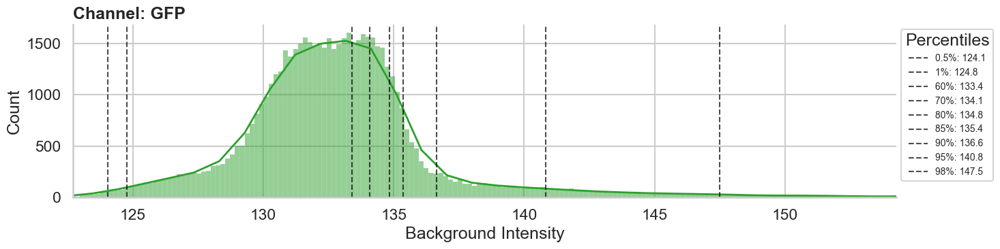

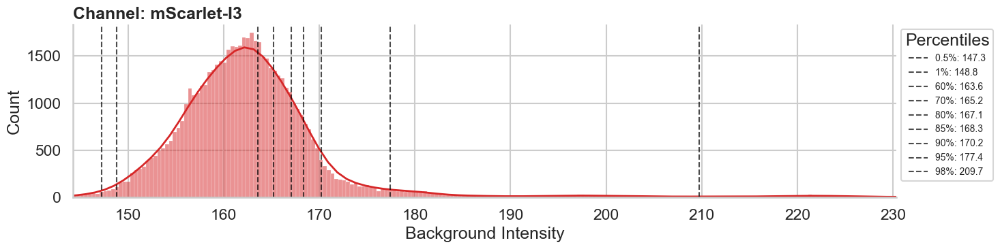

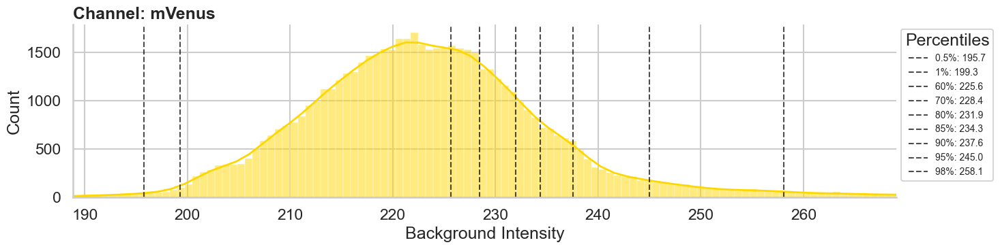

In [10]:
# Test which percentiles to use for background intensity threshold
PERCENTILES_TO_PLOT = [0.5, 1, 60, 70, 80, 85, 90, 95, 98]

plot_fluorescence_bg_histograms_custom(mother_machine_data, PERCENTILES_TO_PLOT)

Plotting GFP background histograms for 4 conditions...


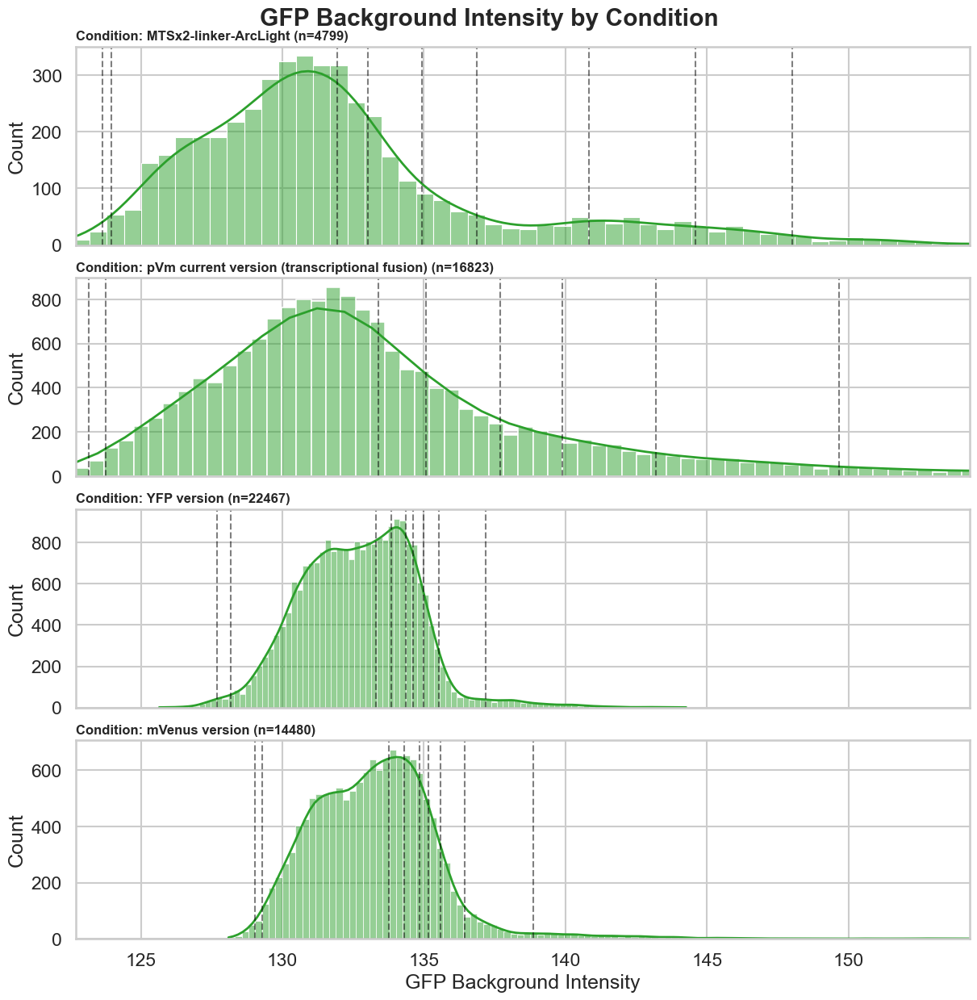

In [18]:
if 'plot_gfp_bg_histograms_by_condition' in locals():
    plot_gfp_bg_histograms_by_condition(mother_machine_data, PERCENTILES_TO_PLOT)

Filtering Criteria and Cutoffs (Growing Cells Only if available):
  GFP: Keeping range 6% (127.80) - 90% (136.65)
  mScarlet-I3: Keeping range 0.5% (147.26) - 90% (170.21)
  mVenus: Keeping range 0.5% (195.73) - 95% (244.99)


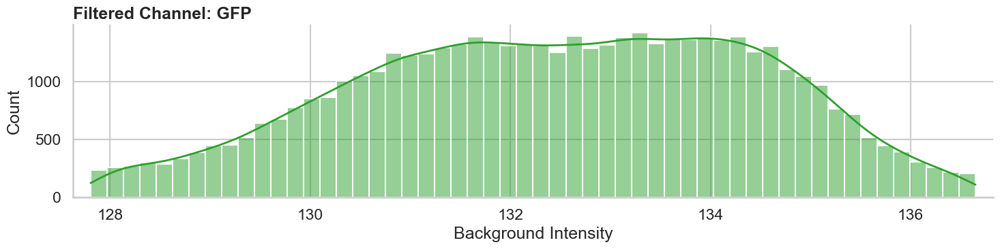

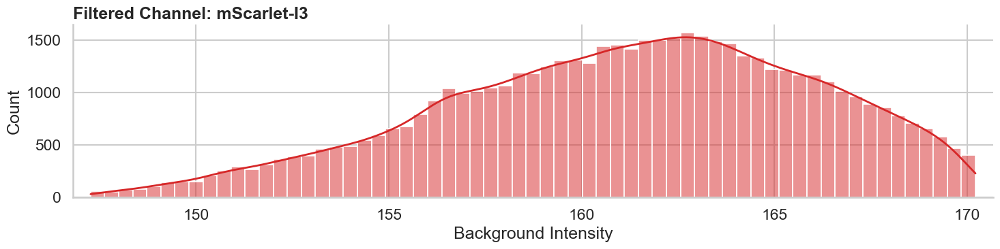

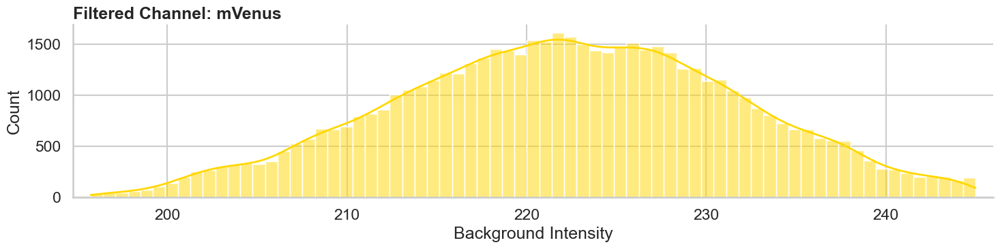

In [11]:
FLUOR_LIMITS = {
    'GFP': [6, 90],
    'mScarlet-I3': [0.5, 90],
    'mVenus': [0.5, 95]
}
    
plot_filtered_bg_histograms(mother_machine_data, FLUOR_LIMITS)

Calculating Cutoffs and Impact per Mother...
  GFP Limits: 6% (127.80) - 90% (136.65)
  mScarlet-I3 Limits: 0.5% (147.26) - 90% (170.21)
  mVenus Limits: 0.5% (195.73) - 95% (244.99)


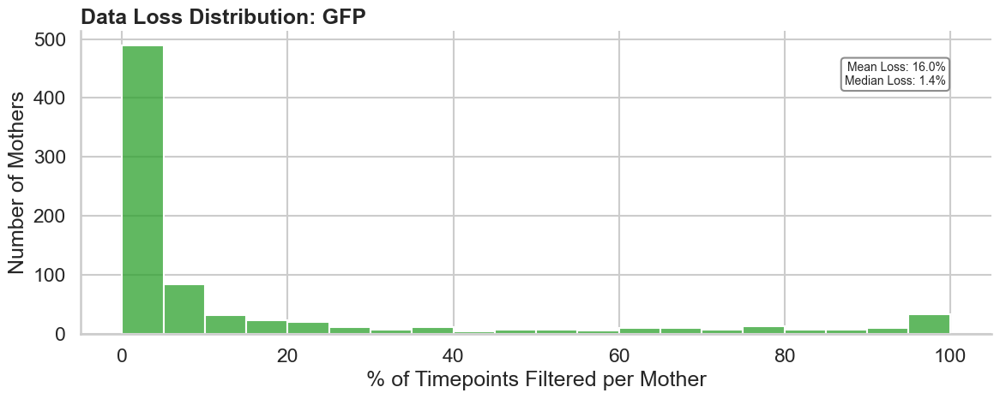

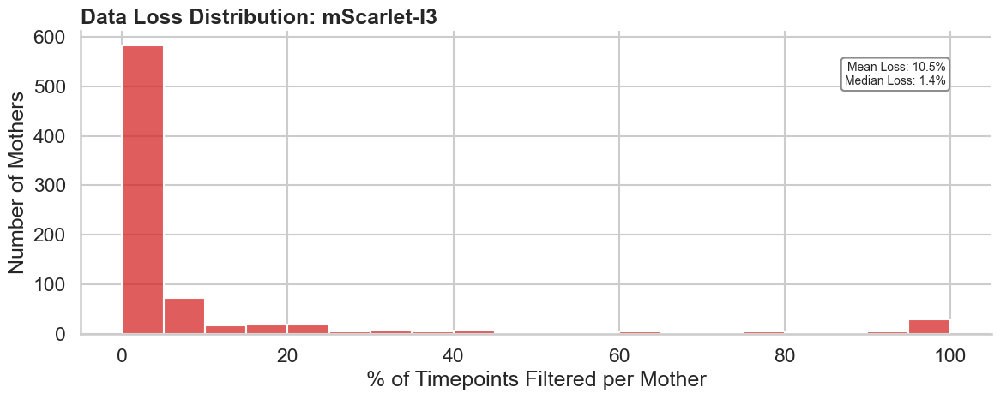

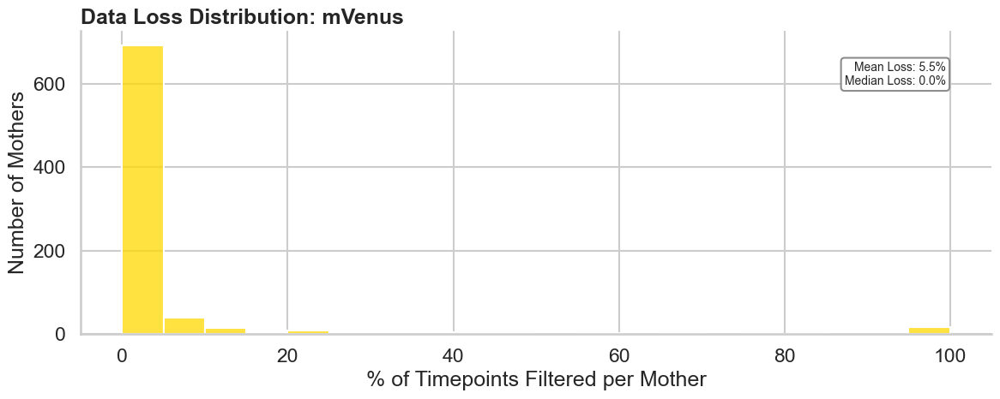

In [13]:
visualize_filtering_impact(mother_machine_data, FLUOR_LIMITS)

Identifying mothers with >20.0% data loss...
Found 343 channel-traces with high loss.


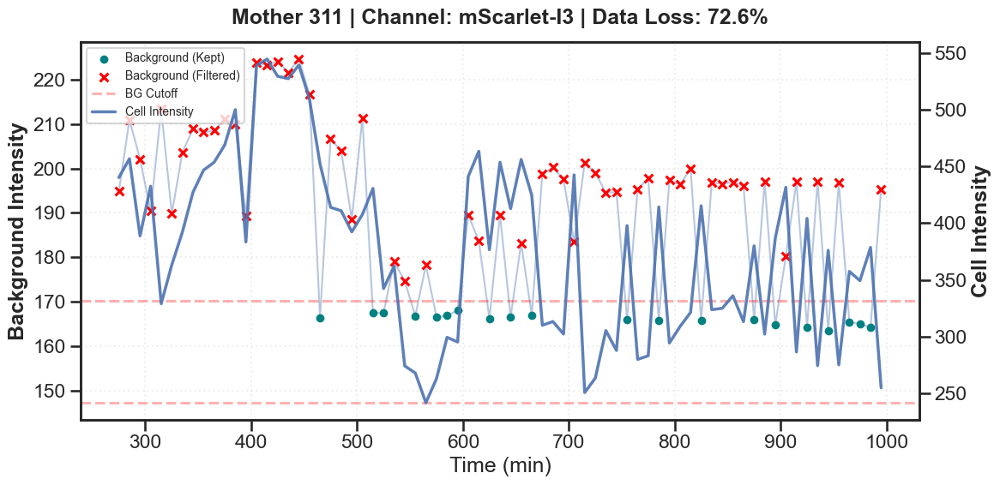

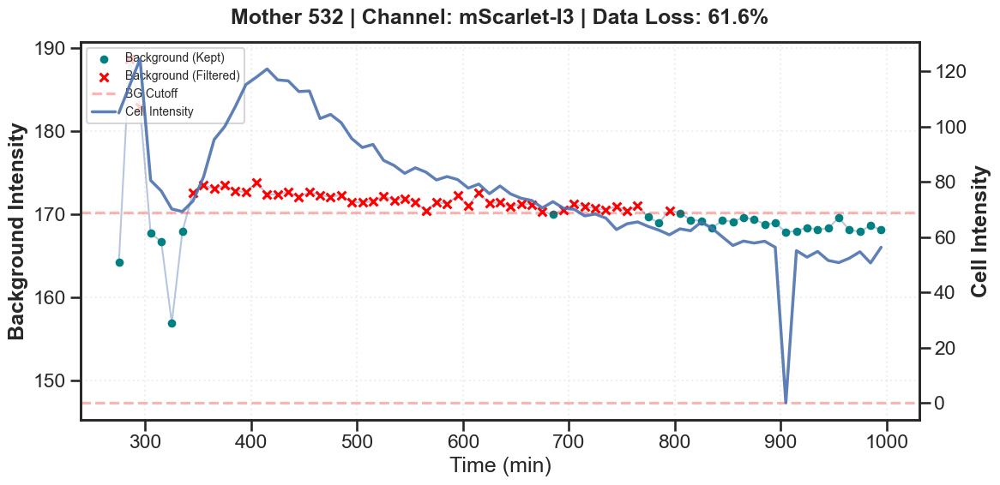

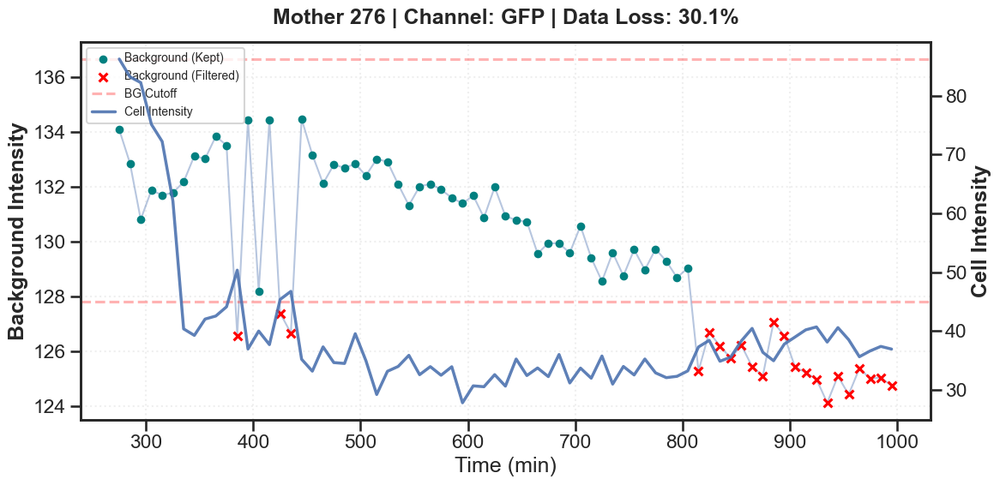

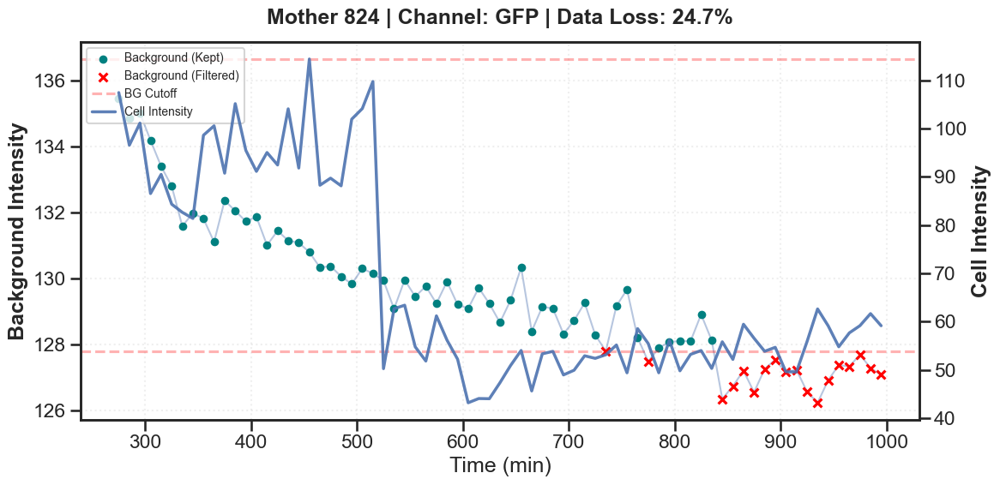

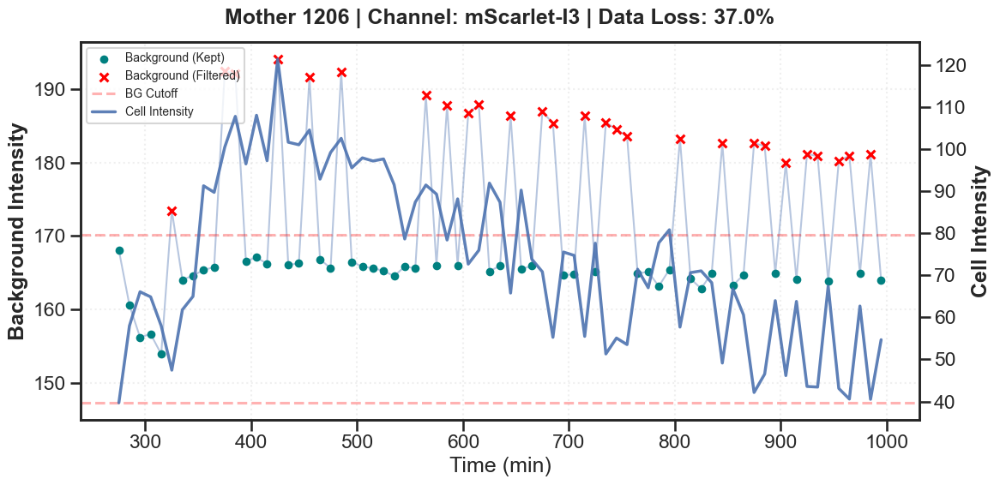

In [15]:
troubleshoot_high_loss_dual_plot(mother_machine_data, FLUOR_LIMITS, loss_threshold=20.0)

In [23]:
# most >threshold background seems just due to light being turned on etc, implement discard mother_id only if >X% are >threshold, i.e. due to debris or something in background region

In [19]:
LOSS_THRESHOLD = 50 # max % allowed above threshold, otherwise mother_id is discarded

_res = apply_fluorescence_qc(mother_machine_data, FLUOR_LIMITS, loss_threshold=LOSS_THRESHOLD)
if _res is not None: mother_machine_data = _res

Applying Background Intensity QC (Threshold: >= 50% filtered)...
  Channel GFP: Cutoffs 6% (127.80) - 90% (136.65)
    -> 113 mothers failed in GFP
  Channel mScarlet-I3: Cutoffs 0.5% (147.26) - 90% (170.21)
    -> 64 mothers failed in mScarlet-I3
  Channel mVenus: Cutoffs 0.5% (195.73) - 95% (244.99)
    -> 33 mothers failed in mVenus

QC Complete.
Total Growing Mothers: 805
Passed QC: 664
Discarded (High BG Noise): 141

Discarded Mothers by Condition:
condition
pVm current version (transcriptional fusion)    95
MTSx2-linker-ArcLight                           31
YFP version                                     10
mVenus version                                   5
Name: count, dtype: int64


### QC -- check for plasmid loss/unreasonably low fluorescence

Calculating mean intensity between 275-331 min.
Plotting distributions for: ['GFP', 'mScarlet-I3', 'mVenus']


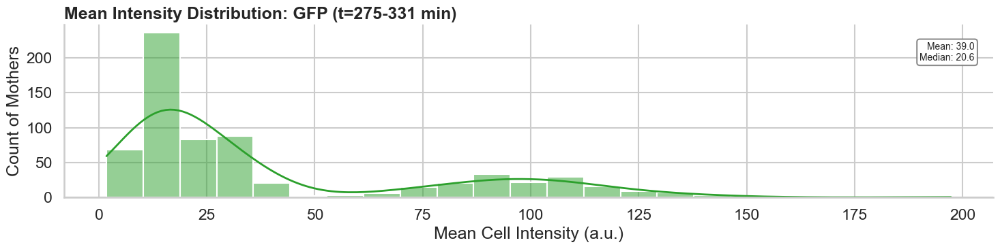

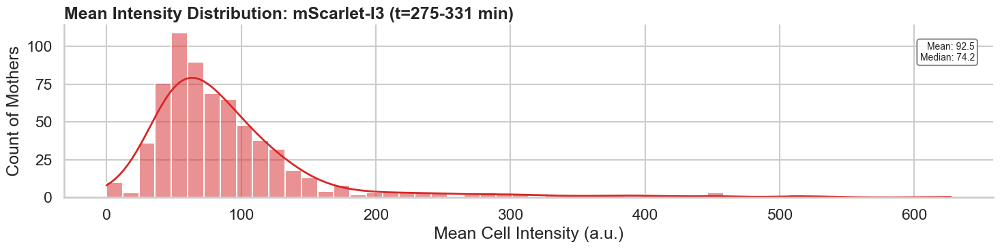

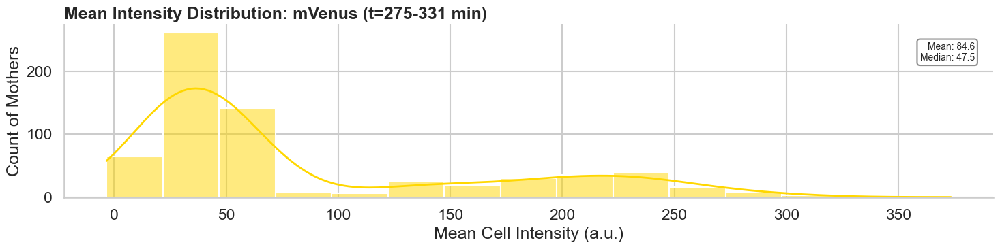

In [22]:
# -- CONFIGURATION: Time Range for Intensity QC --
QC_T1 = T1
QC_T2 = T2 # use growing range specified previously, or change manually as needed

plot_mean_intensity_histograms(mother_machine_data, QC_T1, QC_T2)

Plotting mean intensity (275-331 min) with 100 bins.


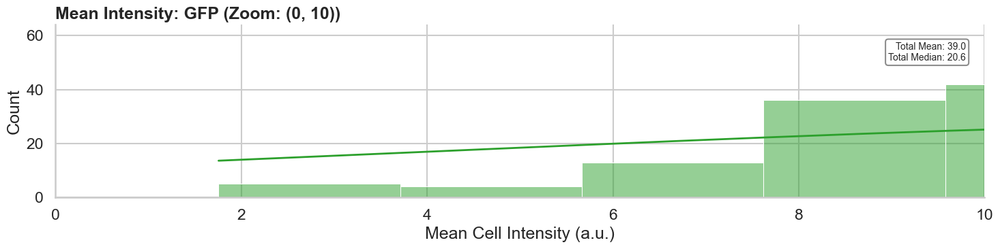

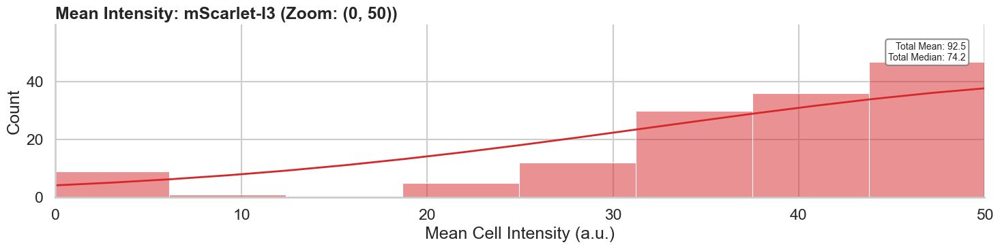

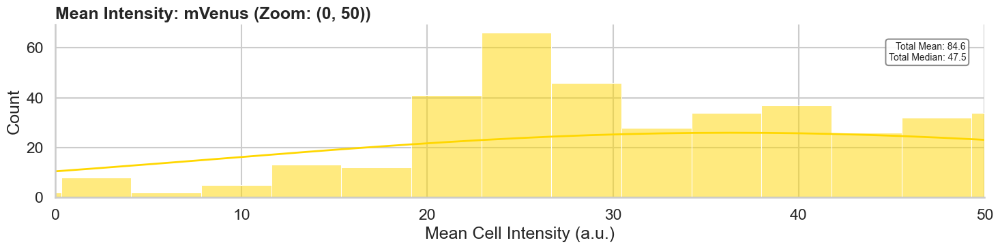

In [23]:
ZOOM_LIMITS = {
    'GFP': (0, 10),
    'mScarlet-I3': (0, 50),
    'mVenus': (0, 50)
}

plot_mean_intensity_histograms_zoomed_bins(mother_machine_data, QC_T1, QC_T2, ZOOM_LIMITS, n_bins=100)

In [24]:
FLUOR_THRESHOLDS = {
    'GFP': None,
    'mScarlet-I3': 15.0,
    'mVenus': None
}

_res = apply_intensity_qc(mother_machine_data, QC_T1, QC_T2, FLUOR_THRESHOLDS)
if _res is not None: mother_machine_data = _res

Applying Intensity QC (Time: 275-331 min)...
  Checking mScarlet-I3 >= 15.0...
    -> 10 mothers failed (mean < 15.0)

QC Complete.
Candidates (Passed BG QC): 664
Passed Intensity QC: 654
Discarded (Low Intensity): 10

Discarded Mothers by Condition:
condition
YFP version                                     5
mVenus version                                  3
MTSx2-linker-ArcLight                           1
pVm current version (transcriptional fusion)    1
Name: count, dtype: int64


In [75]:
mother_machine_data

,mother_id,timepoint,time,length,width,area,log_length,log_area,channel,intensity_raw,...,FOV_number,lane,condition,at_start,at_end,log_length_cleaned,division_event,growing_before,fluor_bg_QC,fluor_intensity_QC
0,0,0,275,11.821778,1.044076,9.208548,2.469943,2.220132,GFP,220.533760,...,0,0,MTSx2-linker-ArcLight,True,True,2.469943,False,False,False,False
1,0,0,275,11.821778,1.044076,9.208548,2.469943,2.220132,PC,10734.841507,...,0,0,MTSx2-linker-ArcLight,True,True,2.469943,False,False,False,False
2,0,0,275,11.821778,1.044076,9.208548,2.469943,2.220132,mScarlet-I3,224.133618,...,0,0,MTSx2-linker-ArcLight,True,True,2.469943,False,False,False,False
3,0,0,275,11.821778,1.044076,9.208548,2.469943,2.220132,mVenus,234.953802,...,0,0,MTSx2-linker-ArcLight,True,True,2.469943,False,False,False,False
4,0,1,285,4.991676,1.049679,3.972700,1.607772,1.379446,GFP,217.100494,...,0,0,MTSx2-linker-ArcLight,True,True,1.607772,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
480139,1834,71,985,2.160666,0.862598,1.420224,0.770416,0.350814,mVenus,296.377880,...,79,3,mVenus version,True,True,0.770416,False,False,False,False
480140,1834,72,995,1.636355,0.687392,0.870460,0.492471,-0.138734,GFP,147.578947,...,79,3,mVenus version,True,True,NaN,False,False,False,False
480141,1834,72,995,1.636355,0.687392,0.870460,0.492471,-0.138734,PC,10986.766917,...,79,3,mVenus version,True,True,NaN,False,False,False,False
480142,1834,72,995,1.636355,0.687392,0.870460,0.492471,-0.138734,mScarlet-I3,233.857143,...,79,3,mVenus version,True,True,NaN,False,False,False,False


In [76]:
mother_machine_data.to_pickle(mother_machine_data_pickle)

## Fluor plots

### Global means

Plotting population mean for 3 channels: ['GFP', 'mScarlet-I3', 'mVenus']


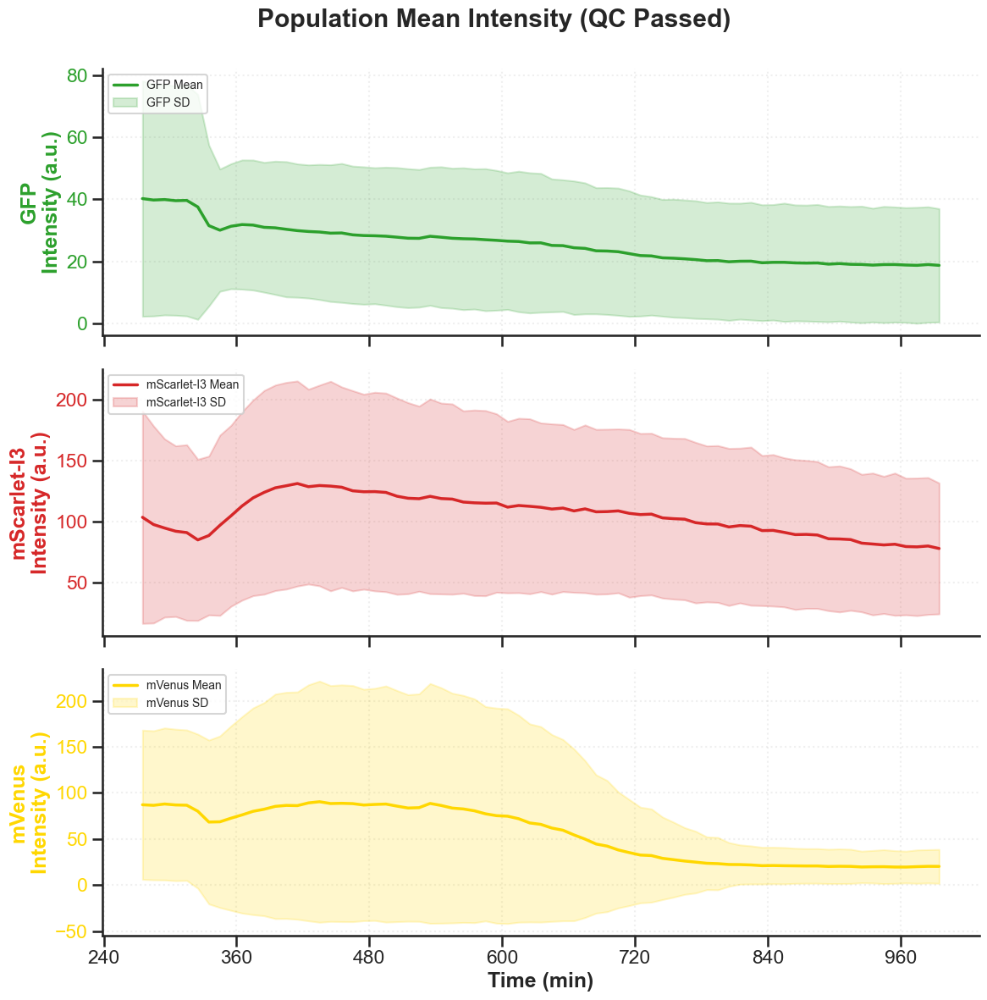

In [25]:
plot_population_mean_fluorescence(mother_machine_data)

### Different conditions means

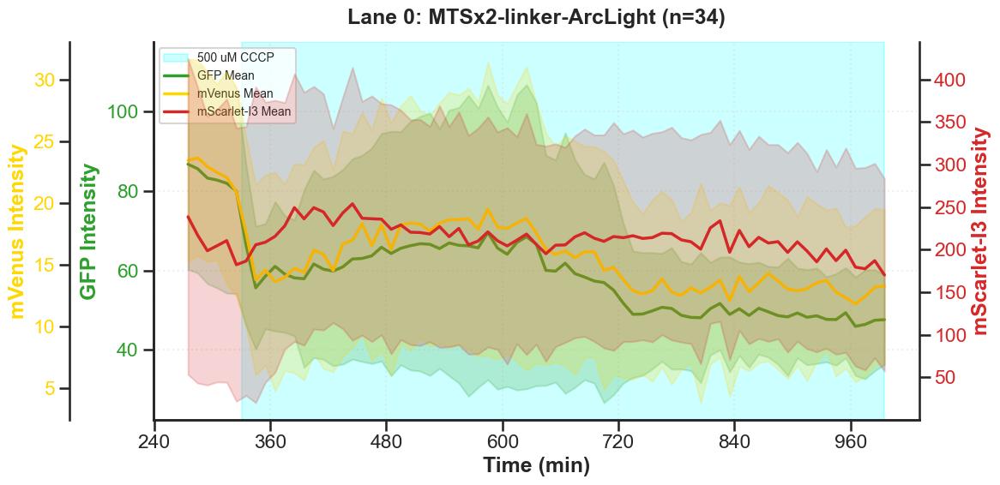

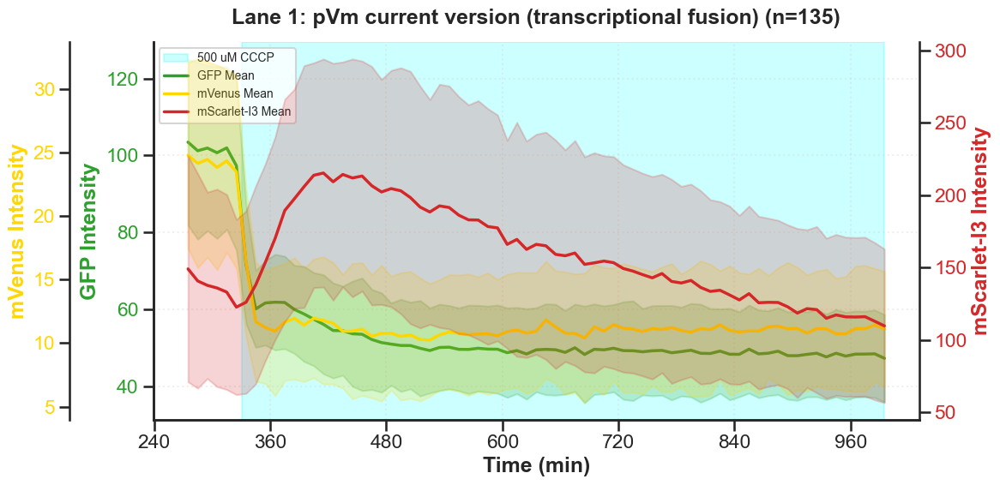

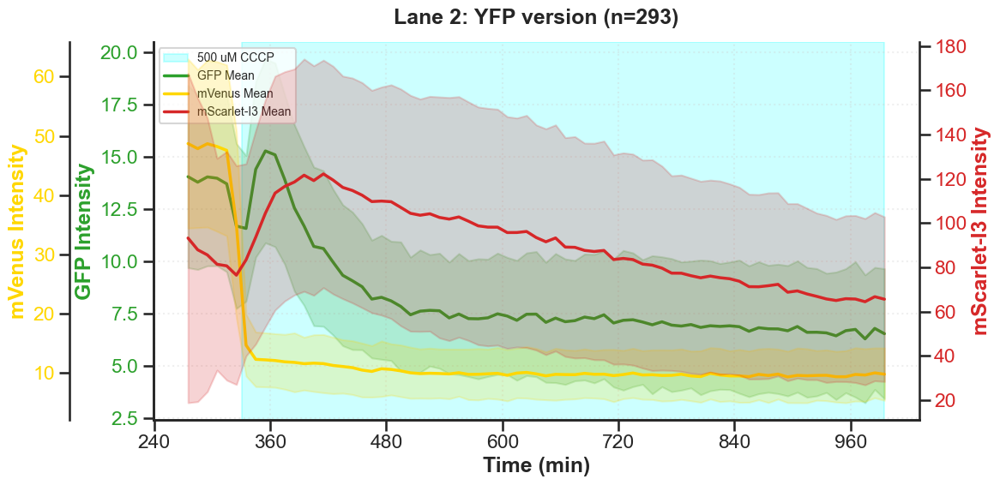

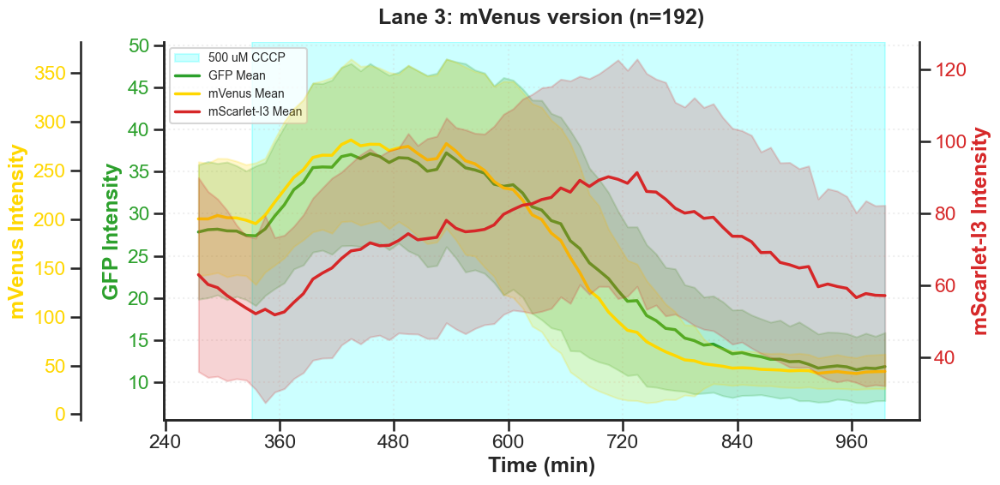

In [26]:
# -- CONFIGURATION: Add custom shaded regions --
# Use 'end': None to shade until the end of the data.
SHADING_REGIONS = [
    {
        'start': T2,    
        'end': None,      # None means "until the end"
        'color': 'cyan', 
        'alpha': 0.2, 
        'label': '500 uM CCCP'
    }
]

plot_population_mean_fluorescence_ordered_by_lane(mother_machine_data, SHADING_REGIONS)

### Ratio mean (filter mScarlet-I3 small values)

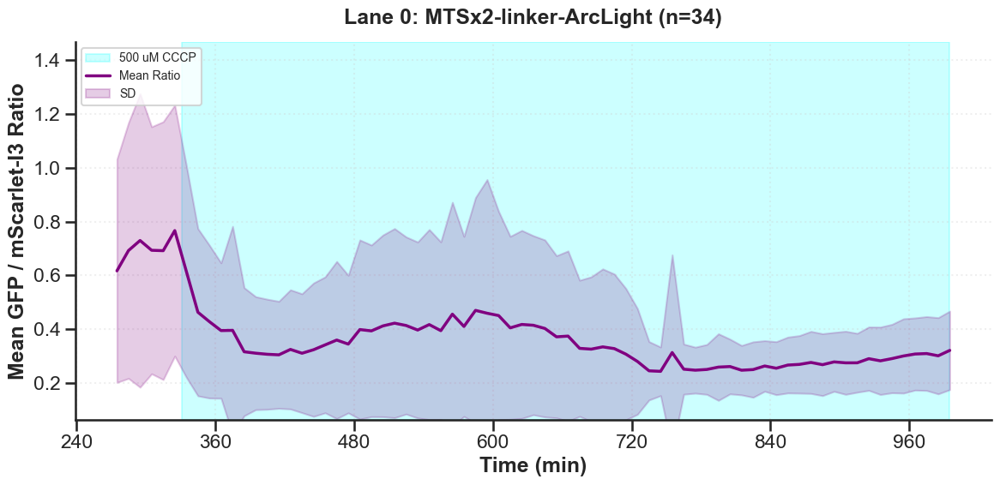

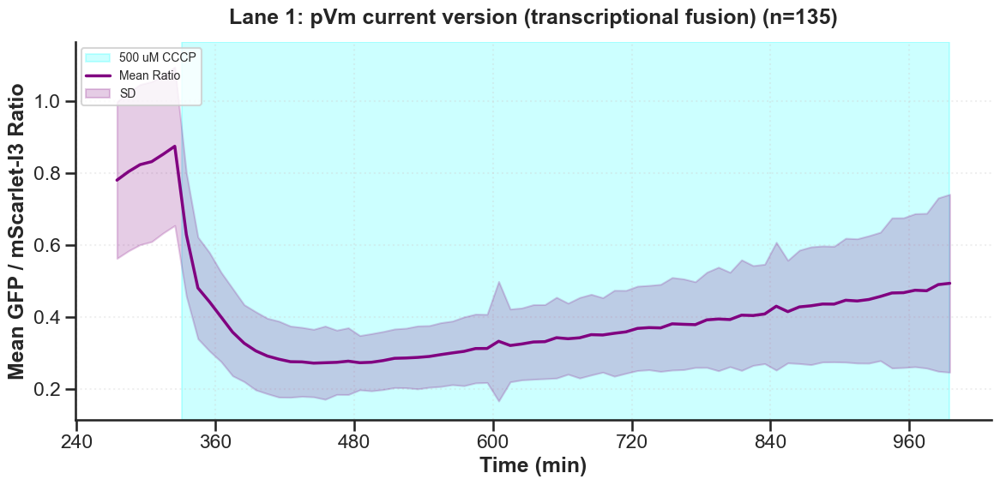

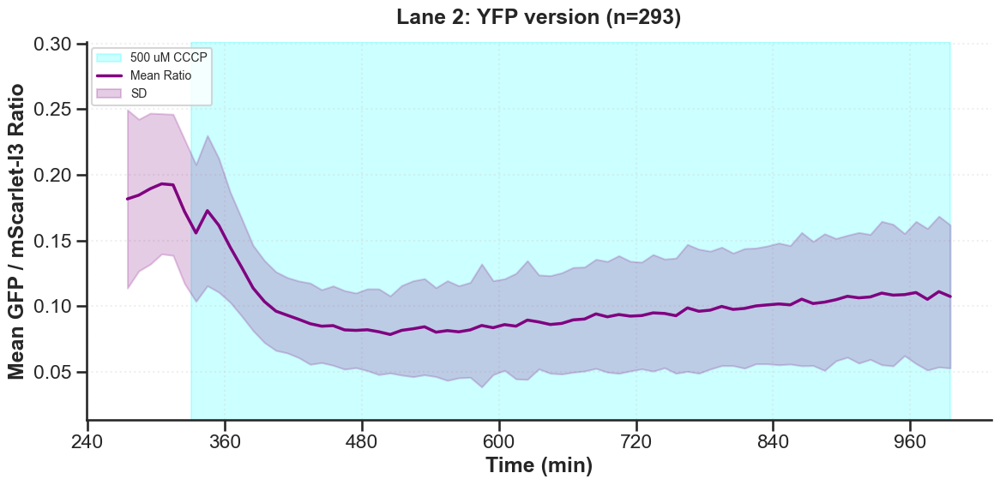

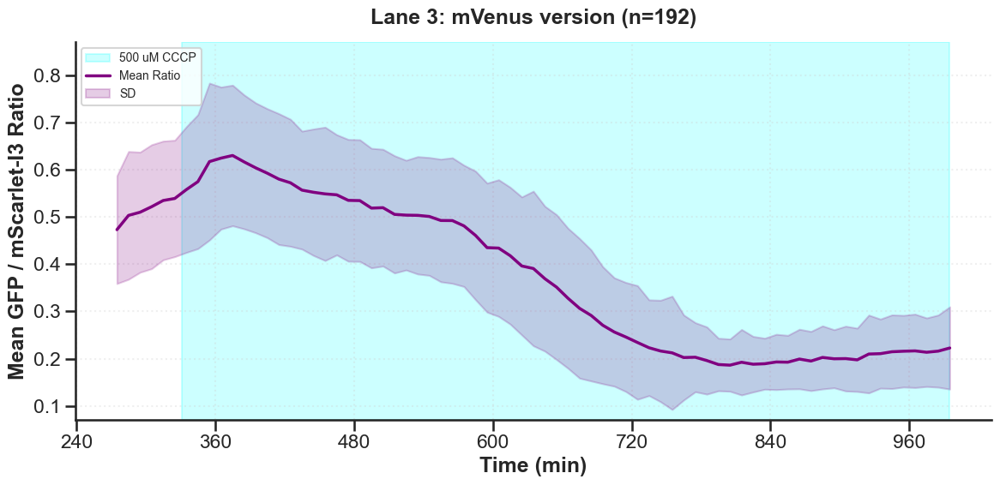

In [30]:
# -- CONFIGURATION: Ratio Definition --
RATIO_CONFIG_GFP = {
    'numerator': 'GFP',
    'denominator': 'mScarlet-I3',
    'label': 'Mean GFP / mScarlet-I3 Ratio',
    'min_denominator_threshold': 15  # Ignore timepoints below this value
}

# -- CONFIGURATION: Y-Axis Limits (Percentiles) --
Y_PERCENTILES = (1, 99)

plot_population_mean_ratio_ordered_by_lane(mother_machine_data, SHADING_REGIONS, RATIO_CONFIG_GFP, y_percentiles=Y_PERCENTILES)

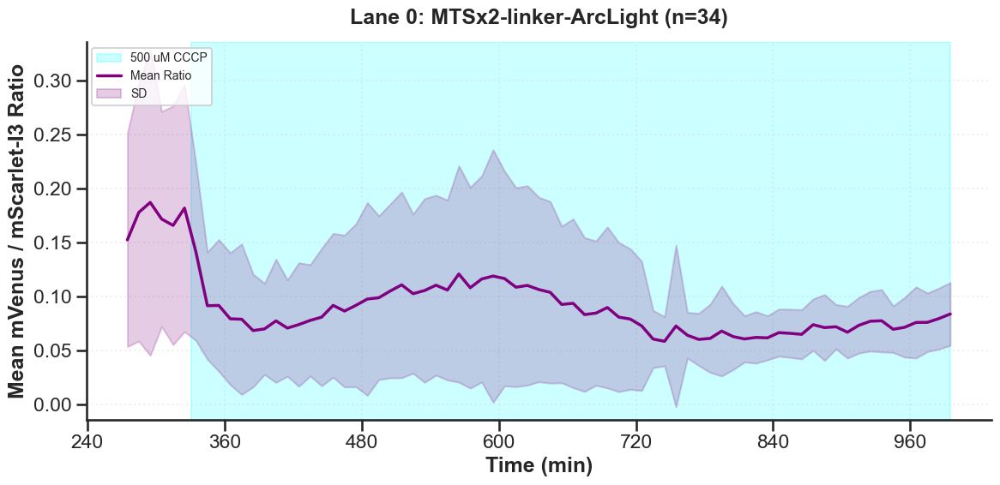

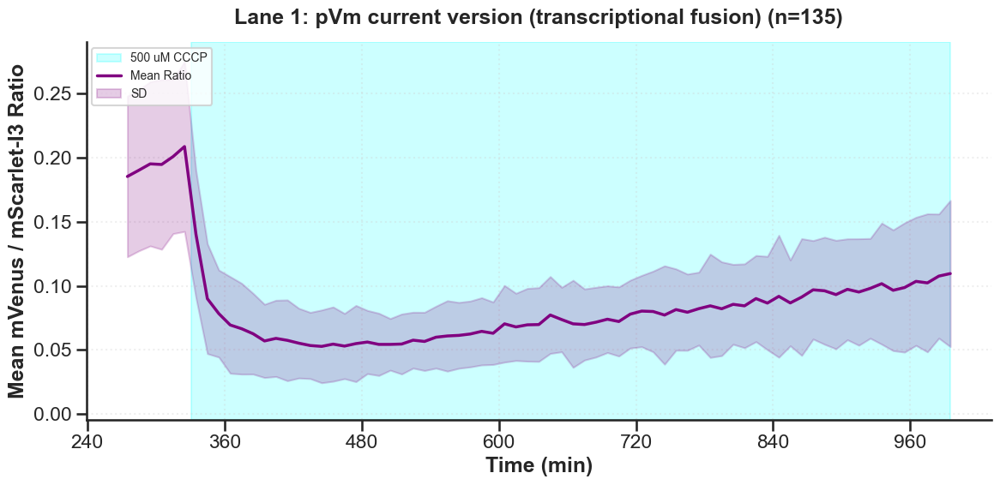

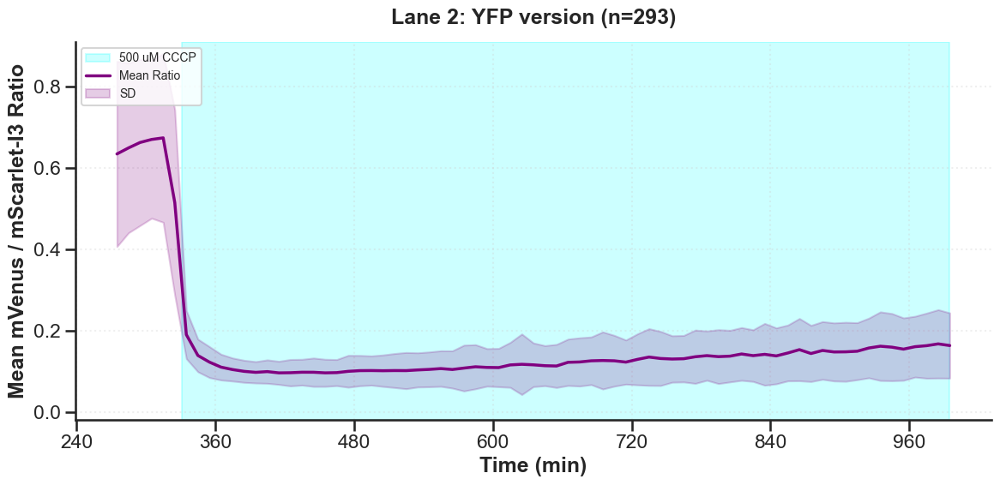

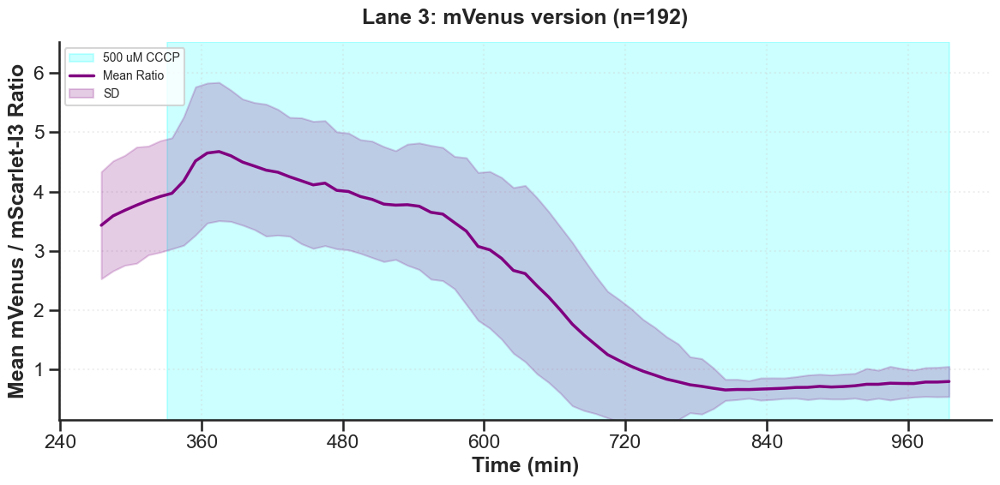

In [28]:
# -- CONFIGURATION: Ratio Definition --
RATIO_CONFIG_mVenus = {
    'numerator': 'mVenus',
    'denominator': 'mScarlet-I3',
    'label': 'Mean mVenus / mScarlet-I3 Ratio',
    'min_denominator_threshold': 15  # Ignore timepoints below this value
}

# -- CONFIGURATION: Y-Axis Limits (Percentiles) --
Y_PERCENTILES = (1, 99)

plot_population_mean_ratio_ordered_by_lane(mother_machine_data, SHADING_REGIONS, RATIO_CONFIG_mVenus, y_percentiles=Y_PERCENTILES)

In [35]:
# Dynamic range calculations:

In [31]:
# Define 2 regions to use for fold-change calculation
REGION_1 = (T1, T2)
REGION_2 = (810, 840)

summary_df, per_mother_values = summarize_regions_with_singlecell_sd_and_gfp(mother_machine_data, RATIO_CONFIG_GFP, region1=REGION_1, region2=REGION_2, min_points_per_region=1)

print("GFP/mScarlet-I3")
print_copy_pastable_summary_piped_aligned(summary_df) # Clean copy-pastable lines

clean_table = make_copy_pastable_summary_df(summary_df) # Clean table
clean_table

# summary_df # Full summary dataframe

GFP/mScarlet-I3
Lane 0 | MTSx2-linker-ArcLight                        | Vm-sensitive dynamic range: 40.7 ± 43.5% | Exponential phase mean GFP: 85.7 
Lane 1 | pVm current version (transcriptional fusion) | Vm-sensitive dynamic range: 45.8 ± 36.3% | Exponential phase mean GFP: 101.1
Lane 2 | YFP version                                  | Vm-sensitive dynamic range: 41.2 ± 33.9% | Exponential phase mean GFP: 13.7 
Lane 3 | mVenus version                               | Vm-sensitive dynamic range: 60.9 ± 15.0% | Exponential phase mean GFP: 27.8 


,Lane,Condition,Vm-sensitive dynamic range (%),Exp phase mean GFP,n
0,0,MTSx2-linker-ArcLight,40.7 ± 43.5,85.7,32
1,1,pVm current version (transcriptional fusion),45.8 ± 36.3,101.1,134
2,2,YFP version,41.2 ± 33.9,13.7,283
3,3,mVenus version,60.9 ± 15.0,27.8,189


In [32]:
# Define 2 regions to use for fold-change calculation
REGION_1 = (T1, T2)
REGION_2 = (810, 840)

summary_df, per_mother_values = summarize_regions_with_singlecell_sd_and_gfp(mother_machine_data, RATIO_CONFIG_mVenus, region1=REGION_1, region2=REGION_2, min_points_per_region=1)

print("mVenus/mScarlet-I3")
print_copy_pastable_summary_piped_aligned(summary_df) # Clean copy-pastable lines

clean_table = make_copy_pastable_summary_df(summary_df) # Clean table
clean_table

# summary_df # Full summary dataframe

mVenus/mScarlet-I3
Lane 0 | MTSx2-linker-ArcLight                        | Vm-sensitive dynamic range: 56.1 ± 65.1% | Exponential phase mean GFP: 23.4 
Lane 1 | pVm current version (transcriptional fusion) | Vm-sensitive dynamic range: 50.4 ± 28.3% | Exponential phase mean GFP: 24.2 
Lane 2 | YFP version                                  | Vm-sensitive dynamic range: 75.7 ± 13.3% | Exponential phase mean GFP: 46.3 
Lane 3 | mVenus version                               | Vm-sensitive dynamic range: 80.9 ± 6.9%  | Exponential phase mean GFP: 200.7


,Lane,Condition,Vm-sensitive dynamic range (%),Exp phase mean GFP,n
0,0,MTSx2-linker-ArcLight,56.1 ± 65.1,23.4,32
1,1,pVm current version (transcriptional fusion),50.4 ± 28.3,24.2,134
2,2,YFP version,75.7 ± 13.3,46.3,283
3,3,mVenus version,80.9 ± 6.9,200.7,189


### Single-cell traces

GFP/mScarlet-I3


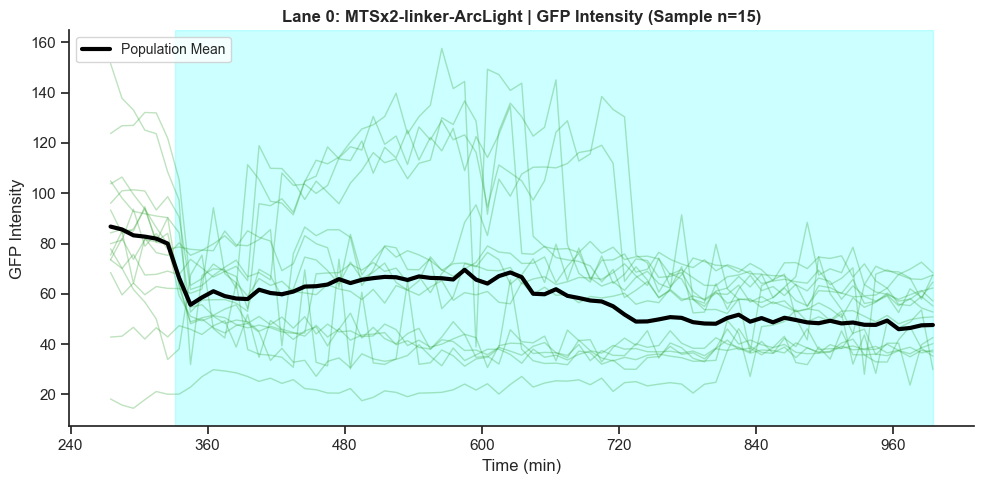

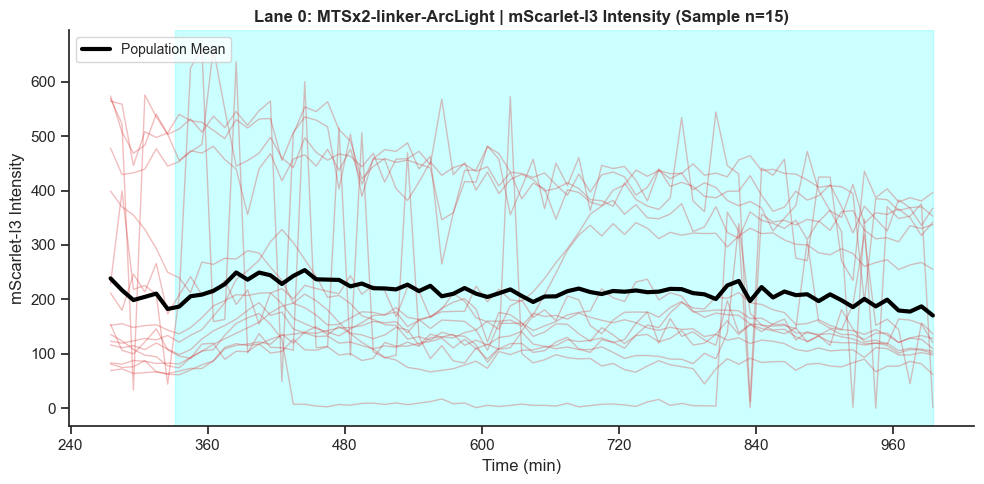

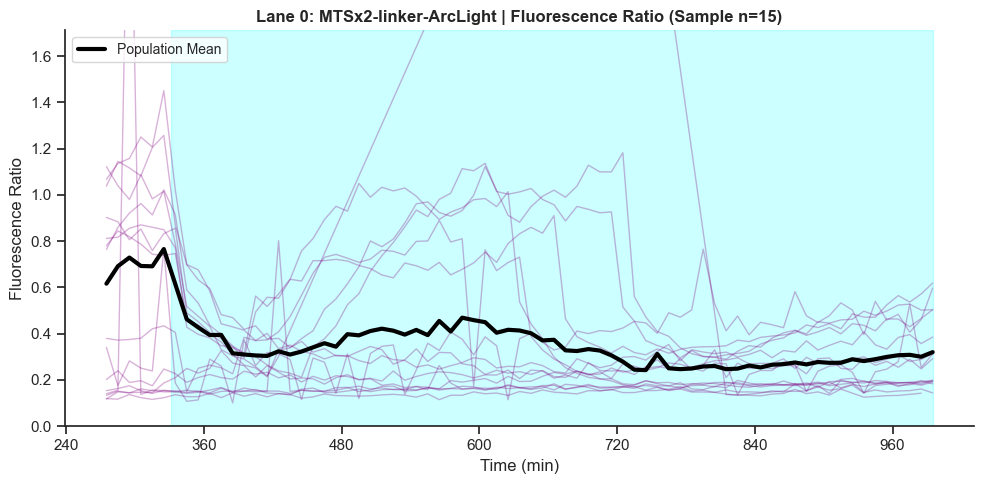

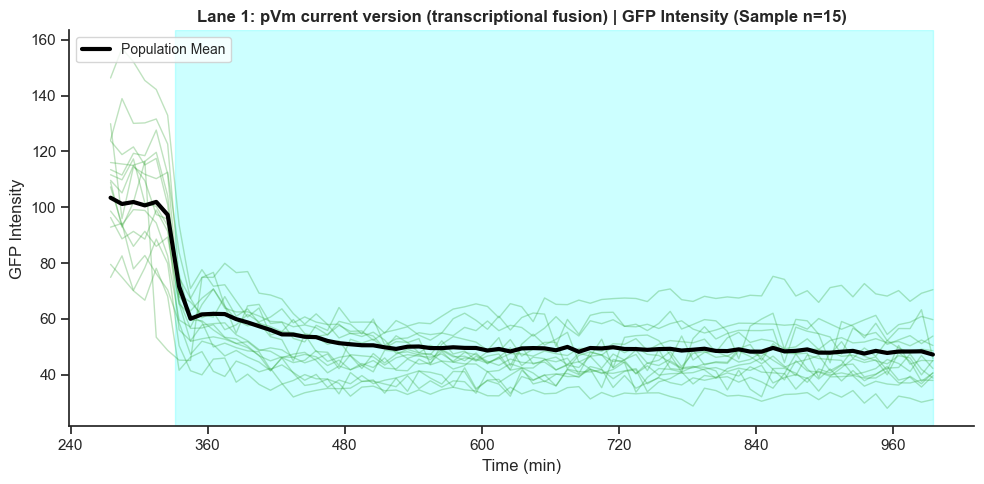

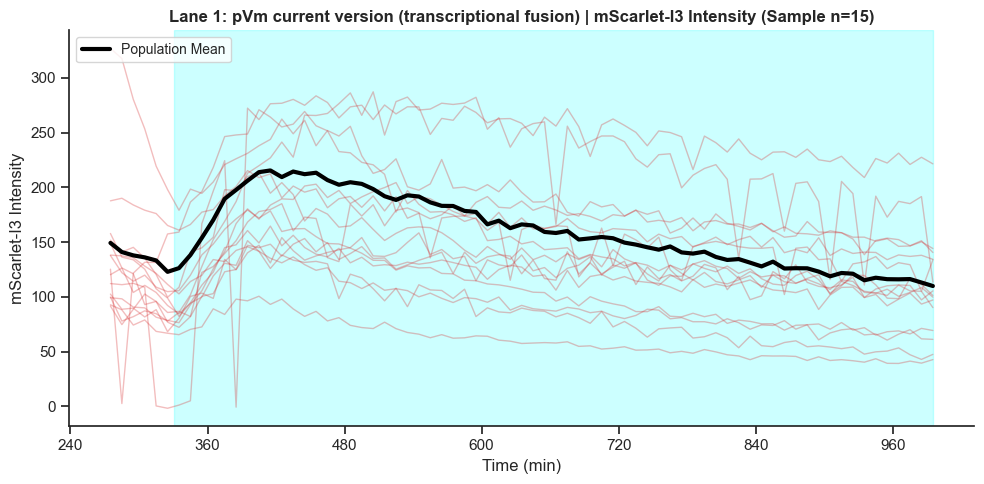

...

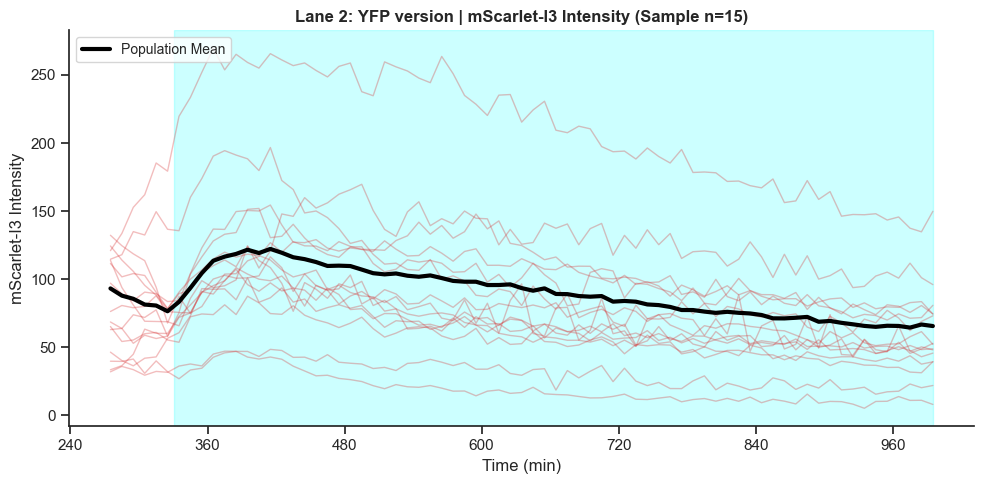

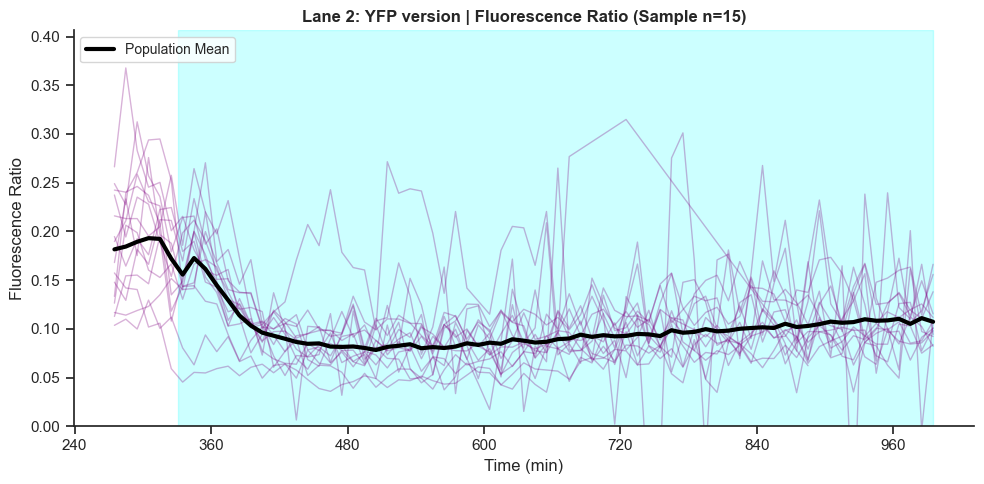

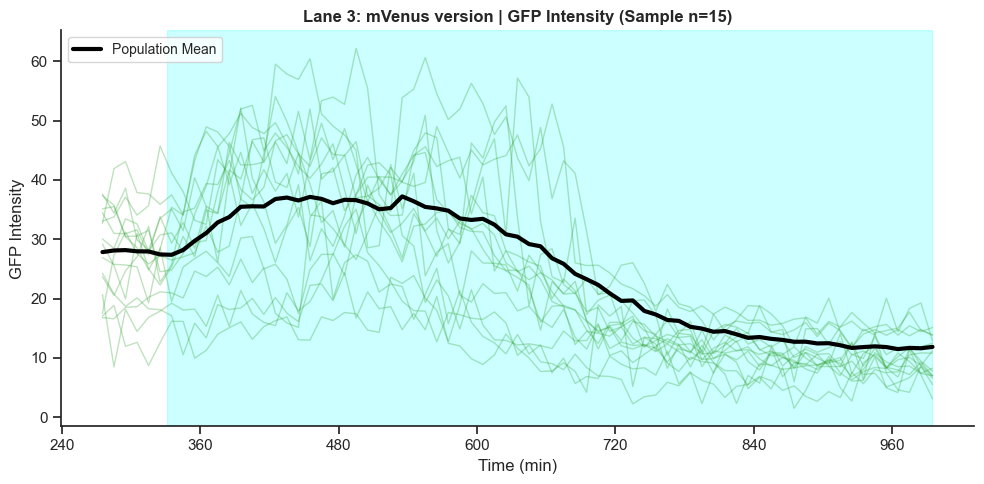

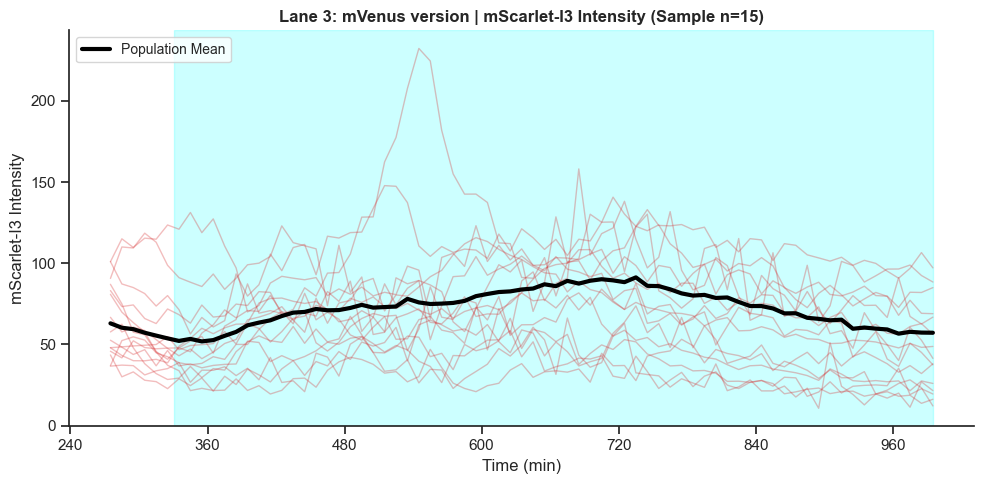

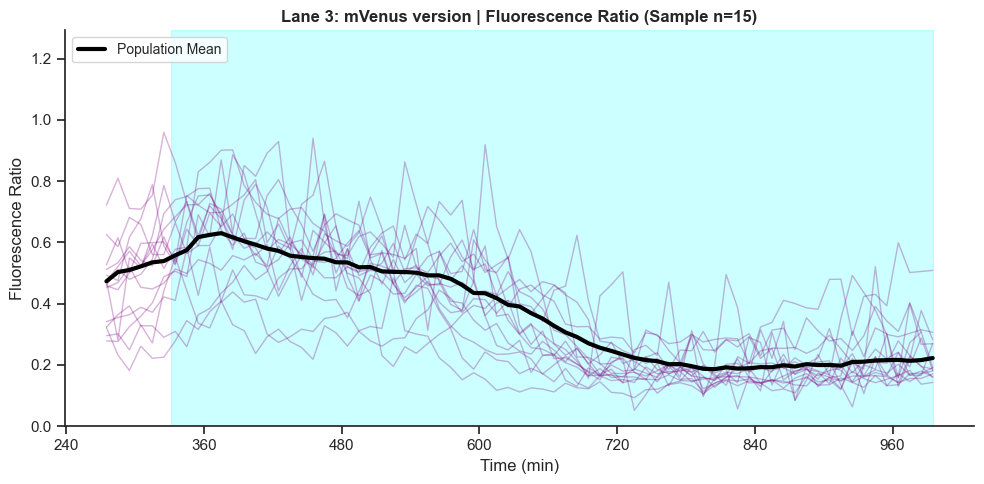

In [33]:
# -- CONFIGURATION: Number of mother_ids to plot --
SAMPLE_SIZE = 15  

print("GFP/mScarlet-I3")
plot_individual_traces_by_lane(mother_machine_data, SHADING_REGIONS, RATIO_CONFIG_GFP, sample_size=SAMPLE_SIZE)

mVenus/mScarlet-I3


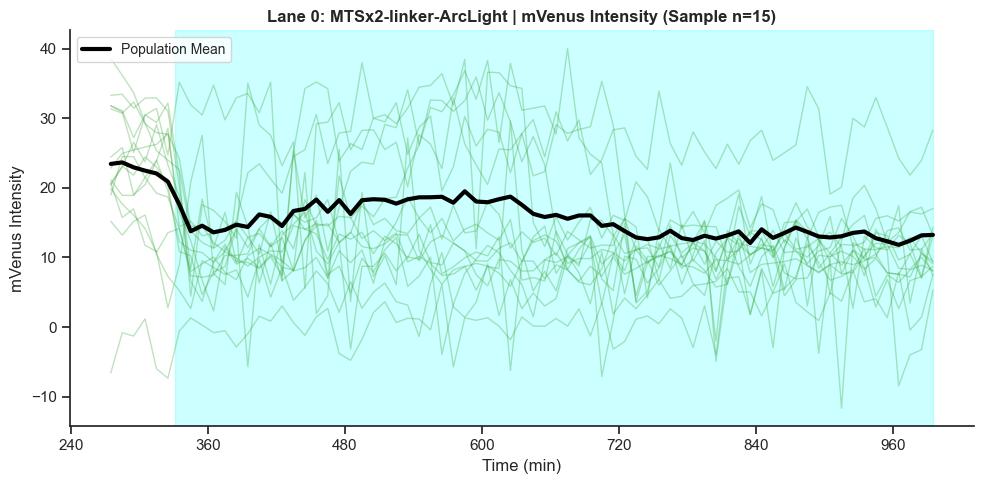

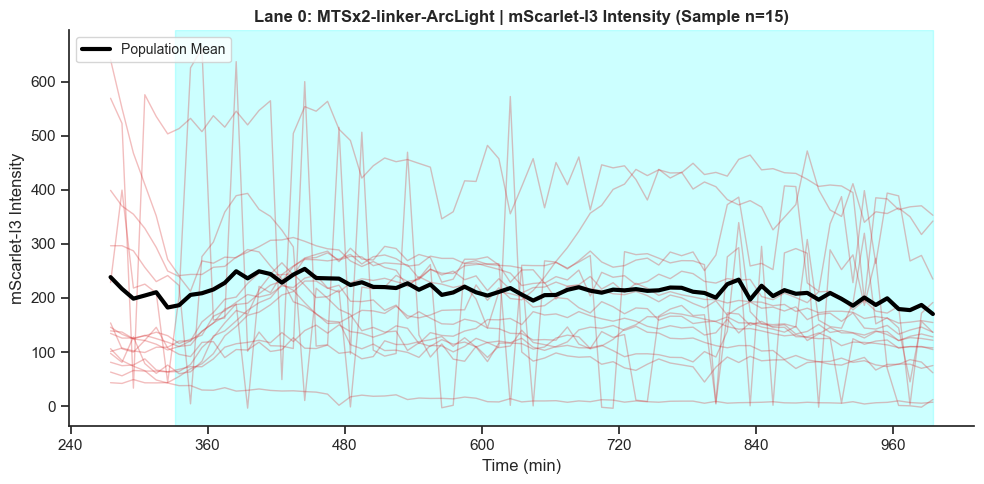

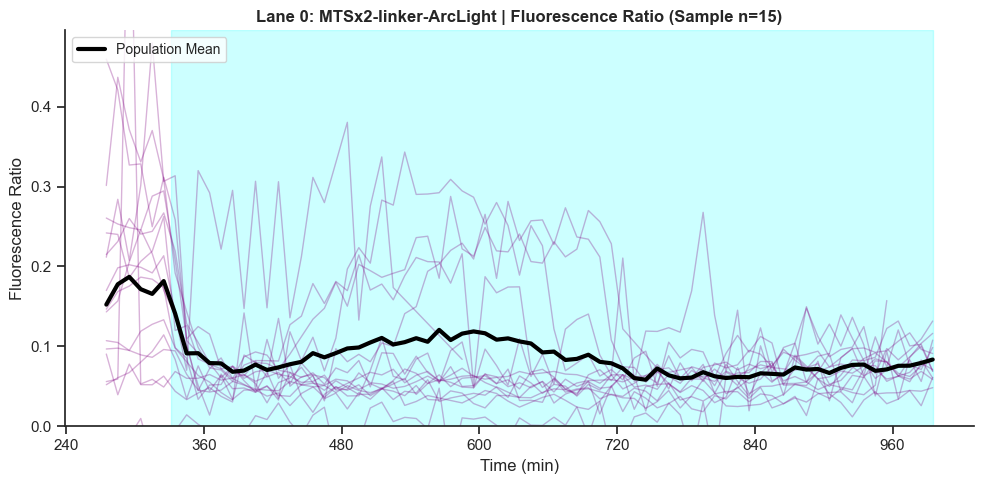

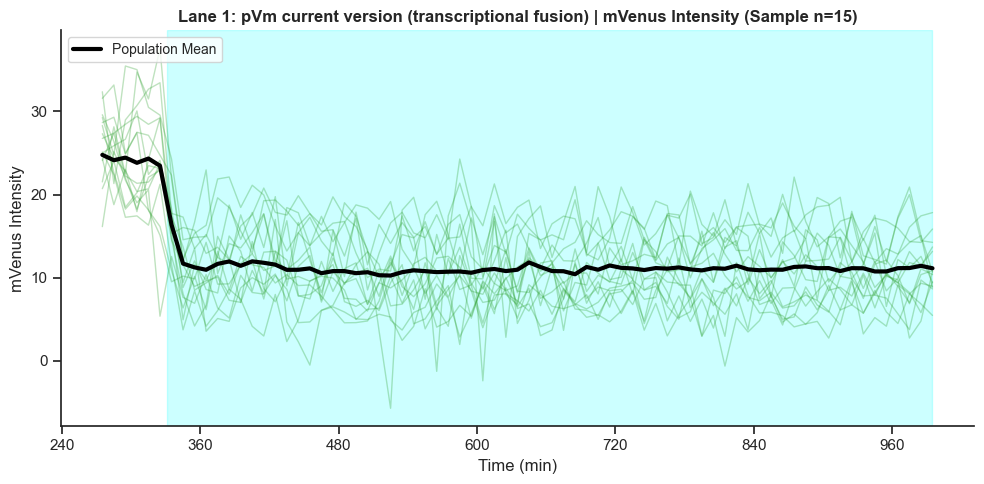

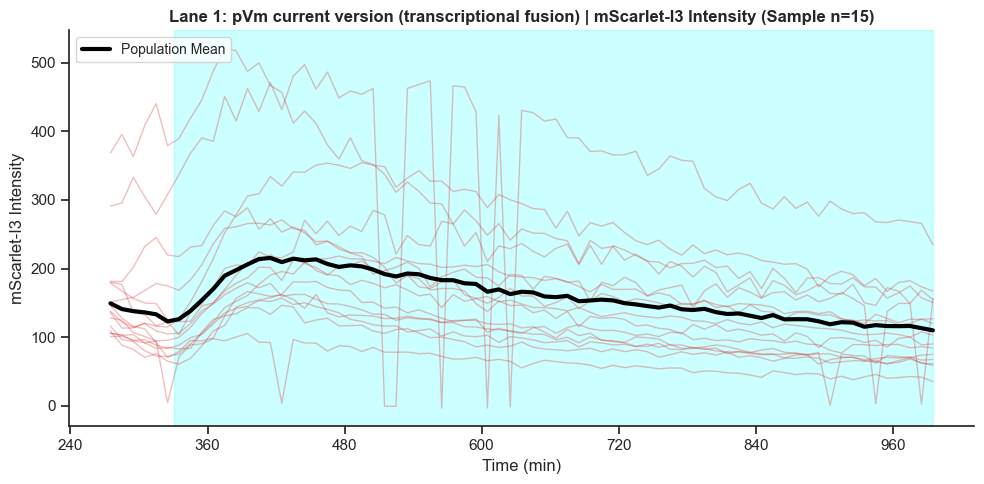

...

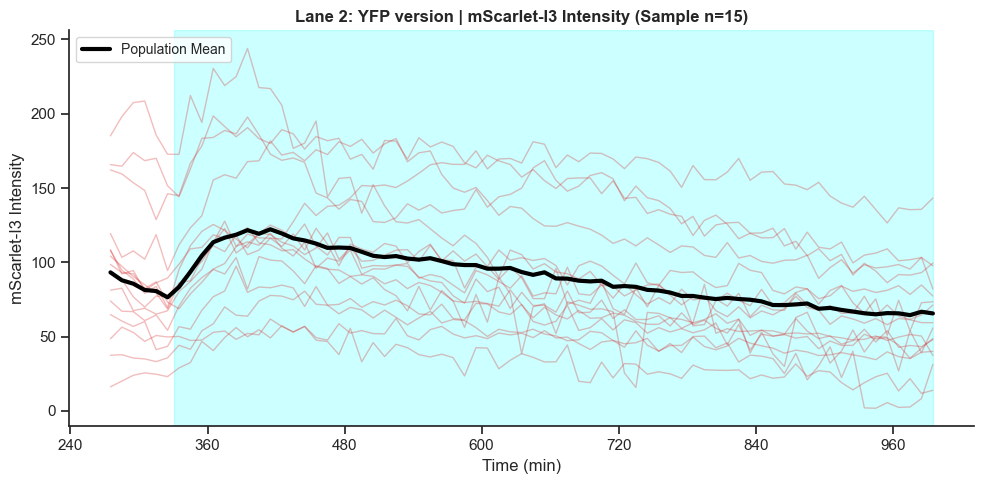

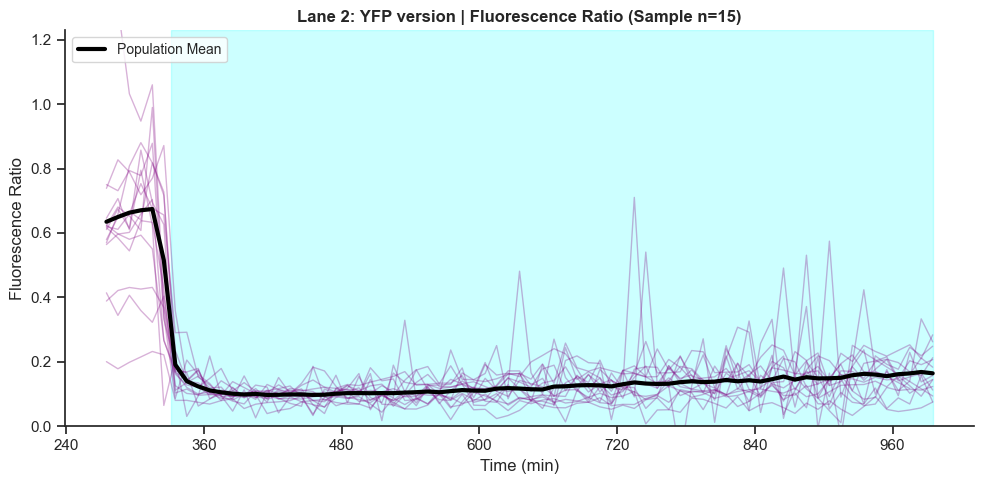

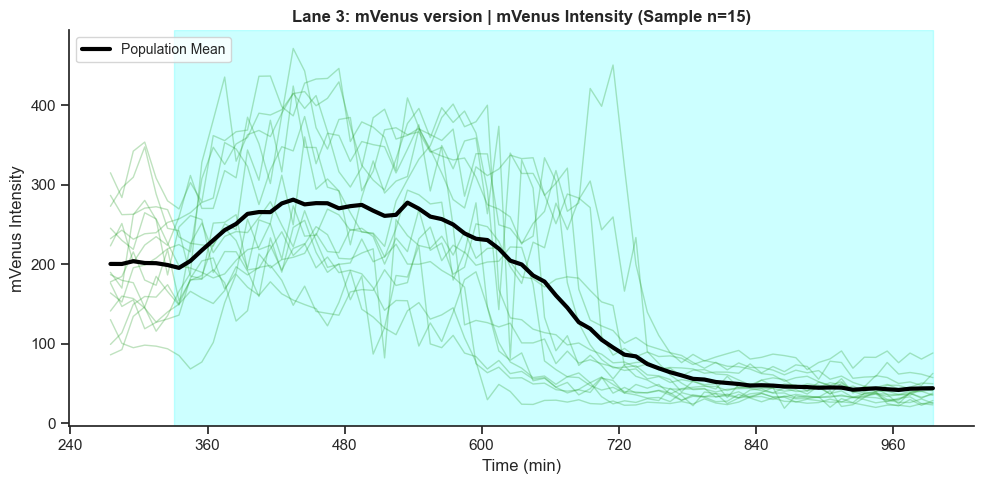

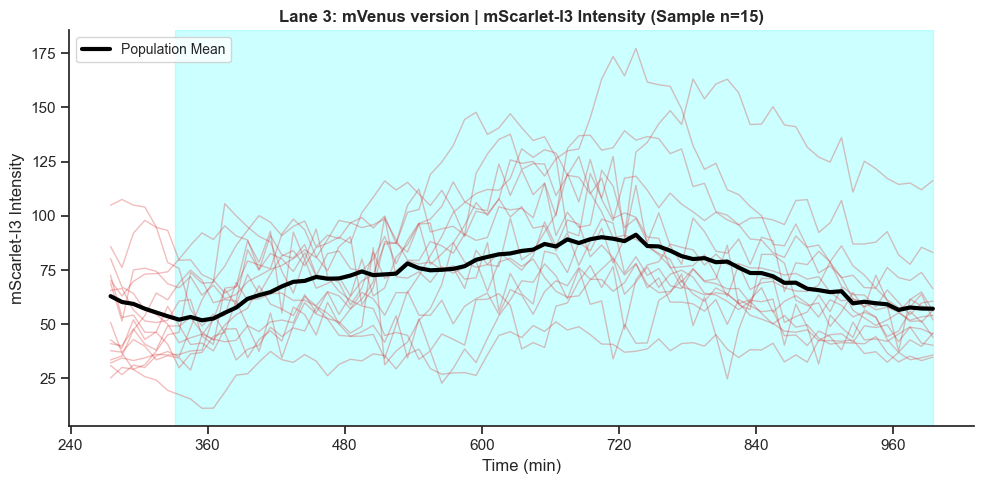

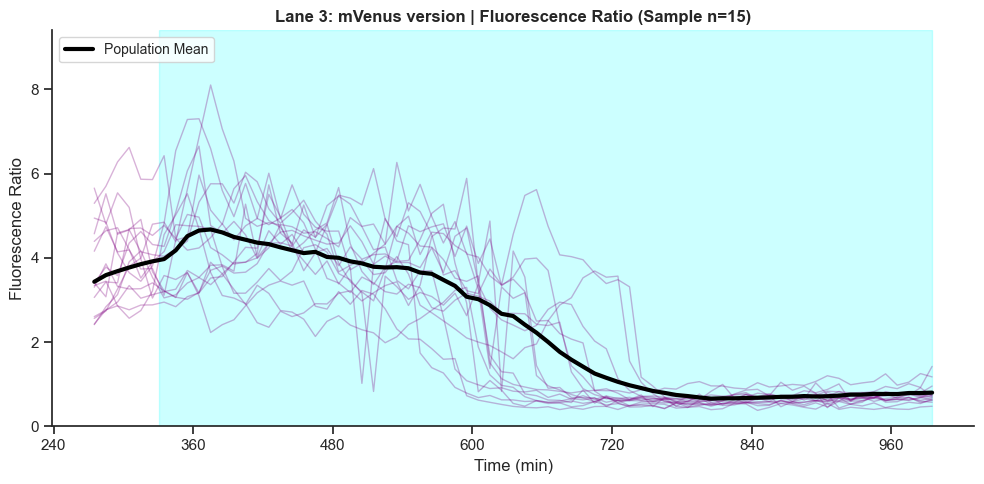

In [34]:
# -- CONFIGURATION: Number of mother_ids to plot --
SAMPLE_SIZE = 15  

print("mVenus/mScarlet-I3")
plot_individual_traces_by_lane(mother_machine_data, SHADING_REGIONS, RATIO_CONFIG_mVenus, sample_size=SAMPLE_SIZE)

### Single-cell traces with LOWESS smoothing of individual traces

GFP/mScarlet-I3


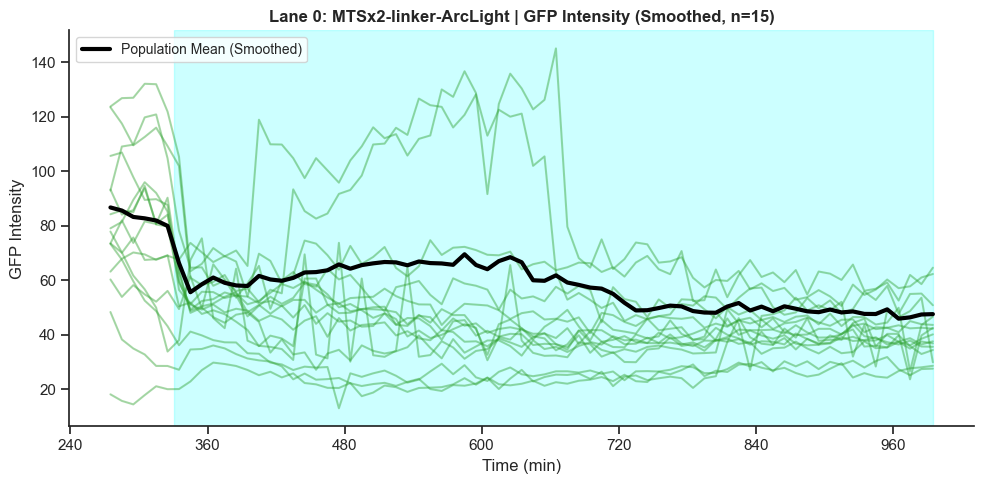

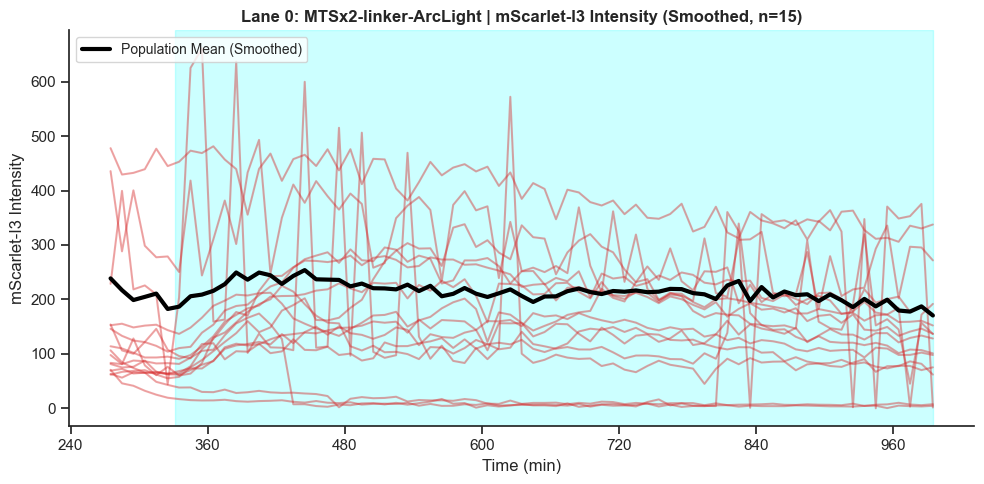

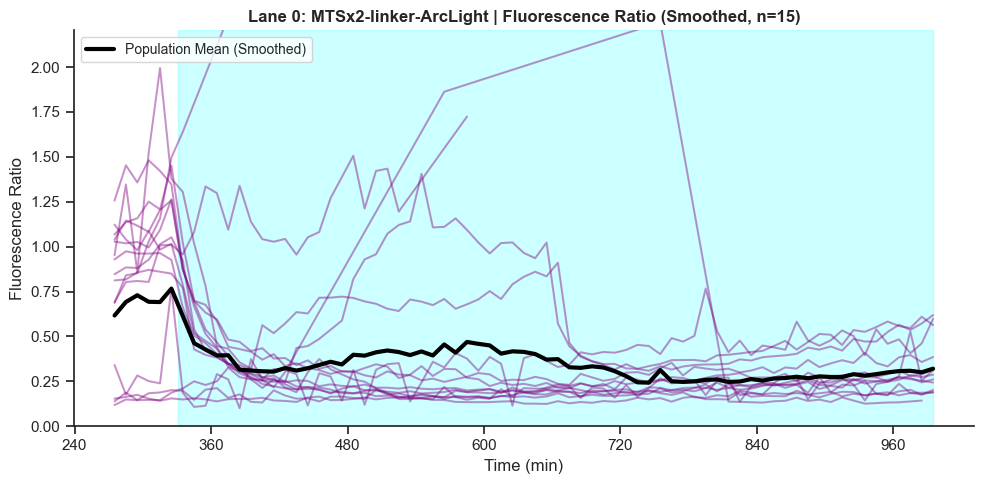

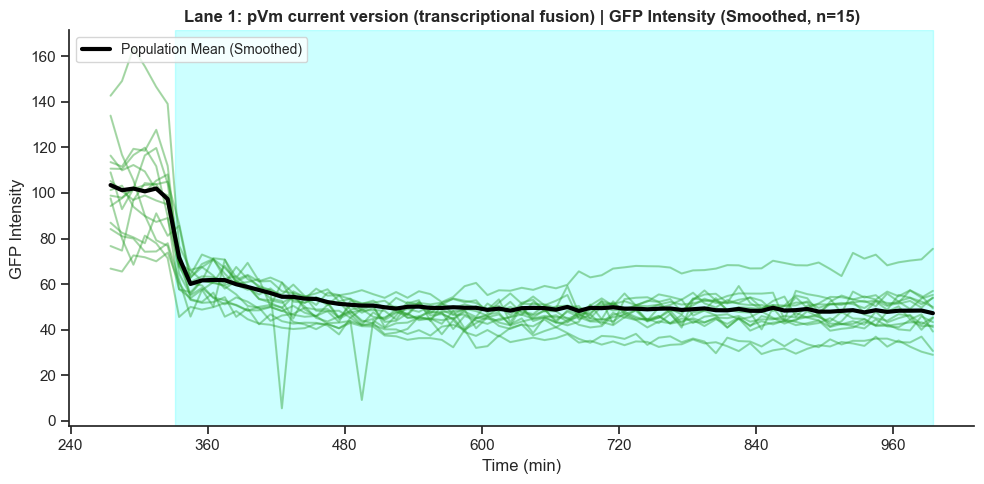

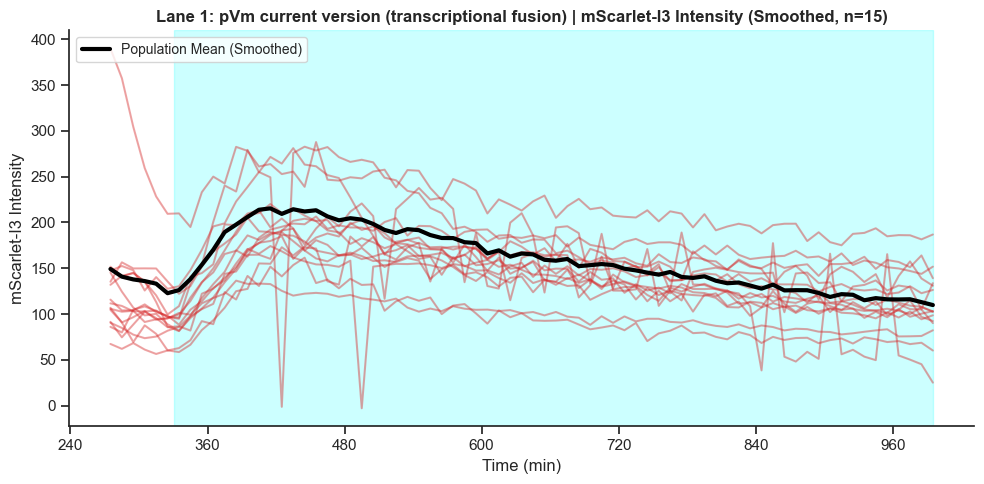

...

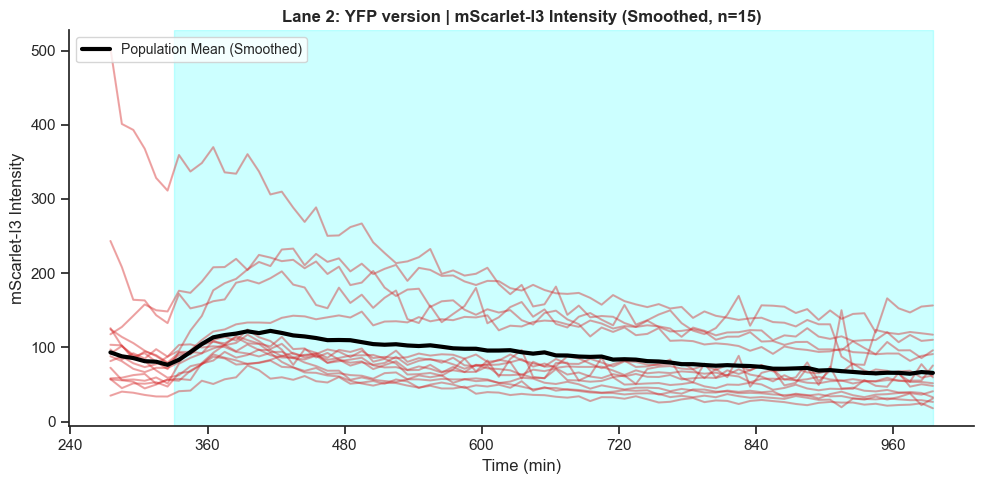

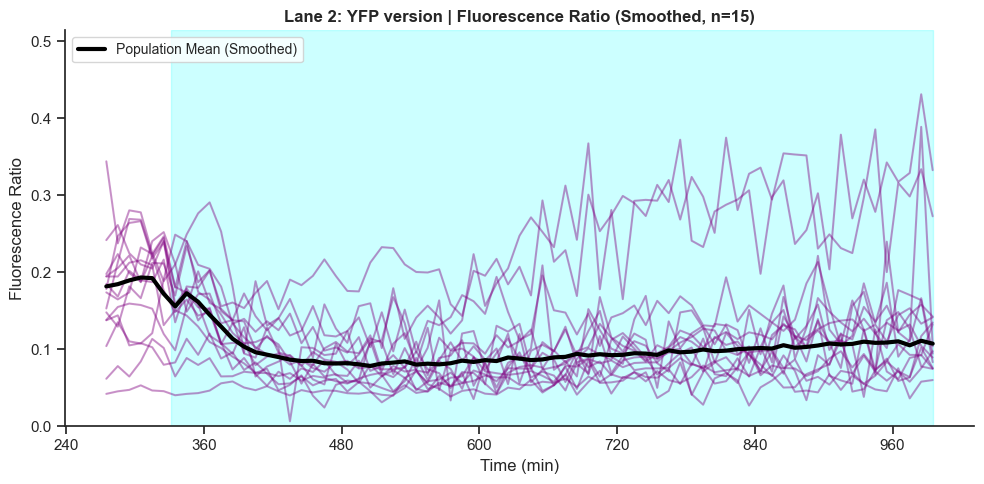

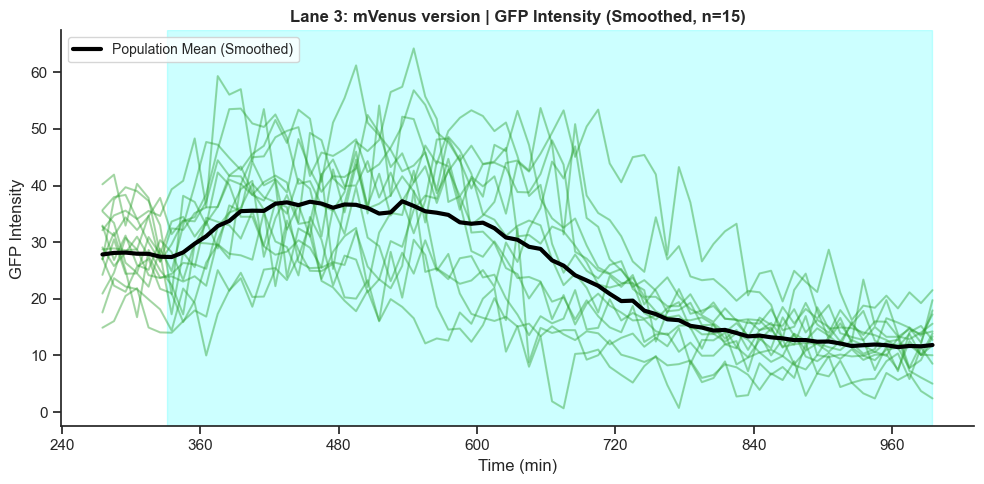

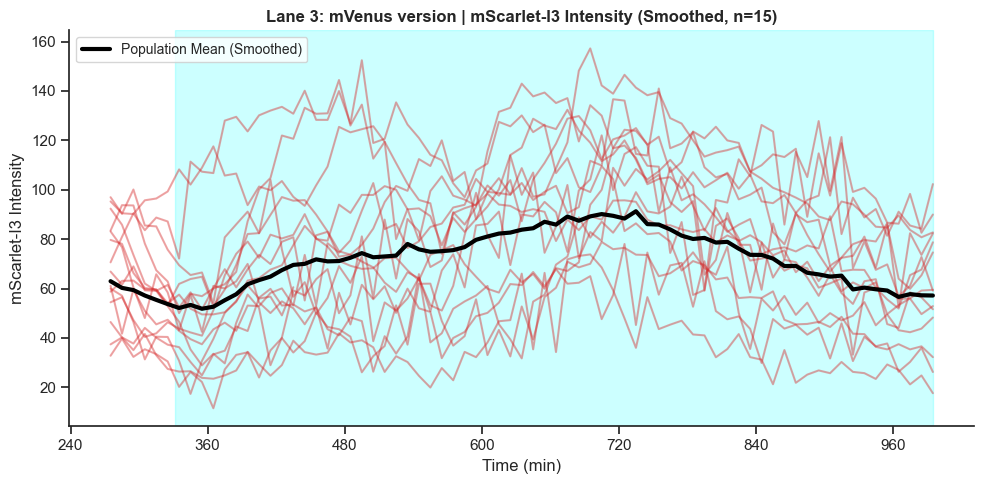

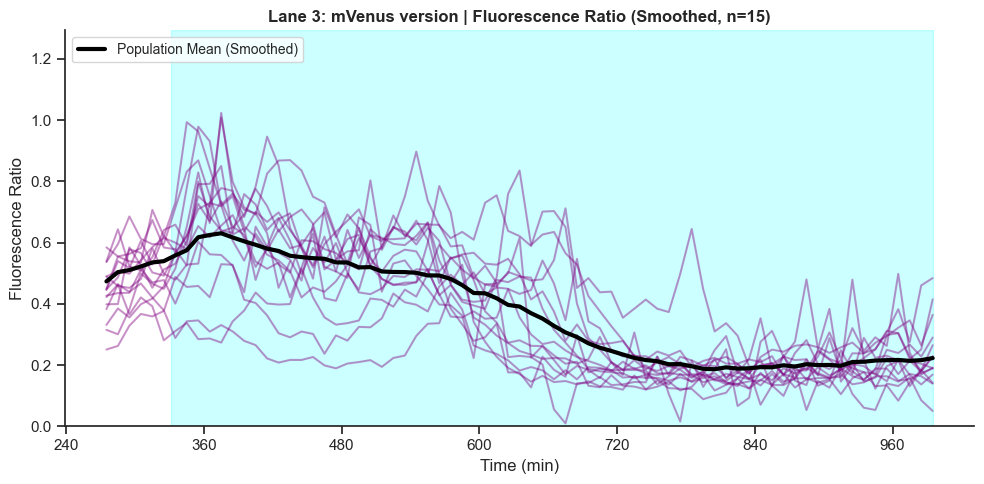

In [35]:
# -- CONFIGURATION: Number of mother_ids to plot & LOWESS fraction --
SAMPLE_SIZE = 15  
LOWESS_FRAC = 0.05  # Fraction of timepoints used for LOWESS smoothing (0 to 1)

print("GFP/mScarlet-I3")
plot_individual_traces_by_lane_smoothed(mother_machine_data, SHADING_REGIONS, RATIO_CONFIG_GFP, sample_size=SAMPLE_SIZE, lowess_frac=LOWESS_FRAC)

mVenus/mScarlet-I3


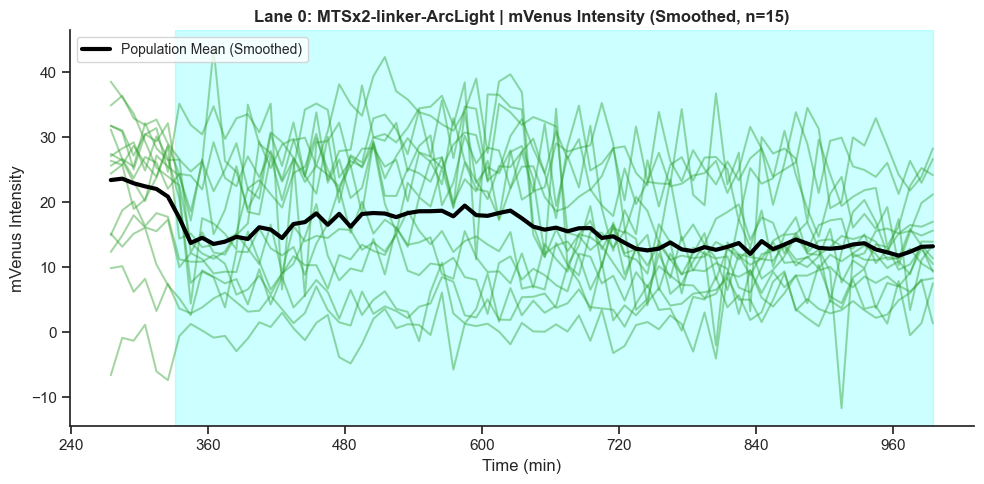

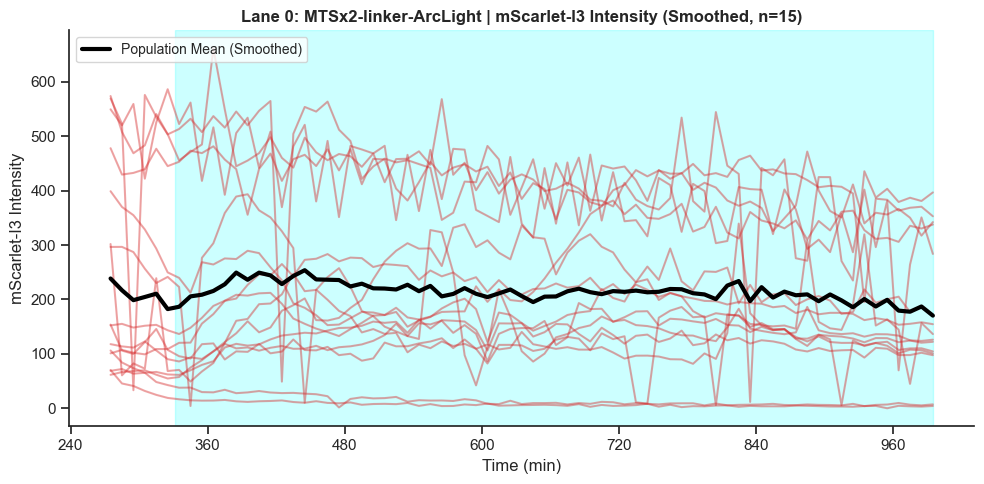

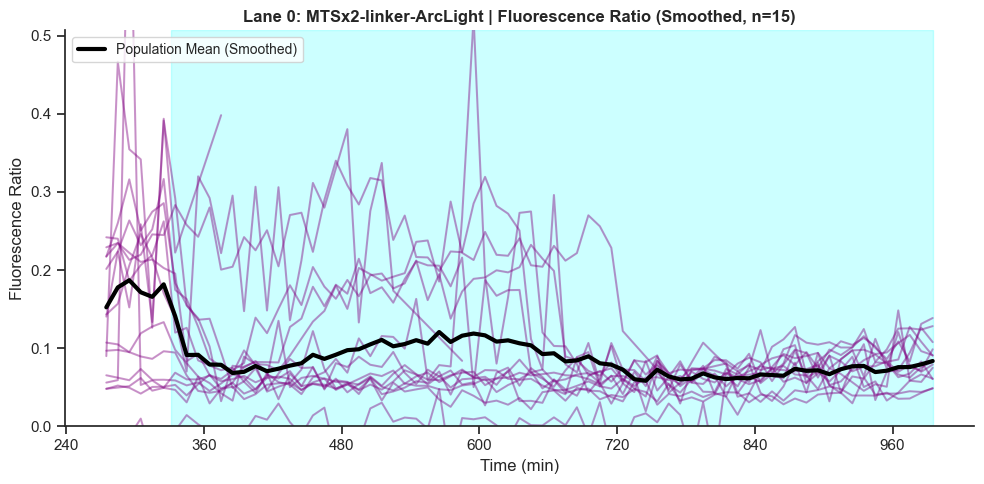

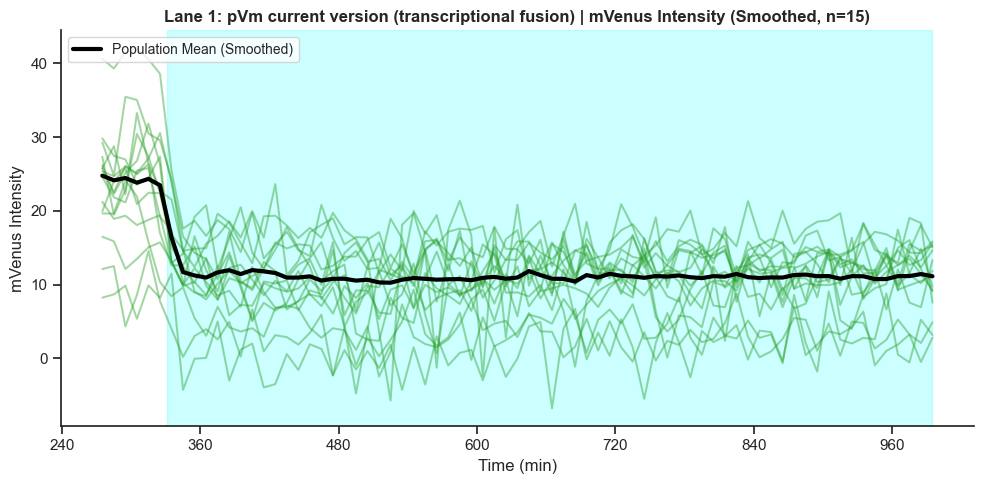

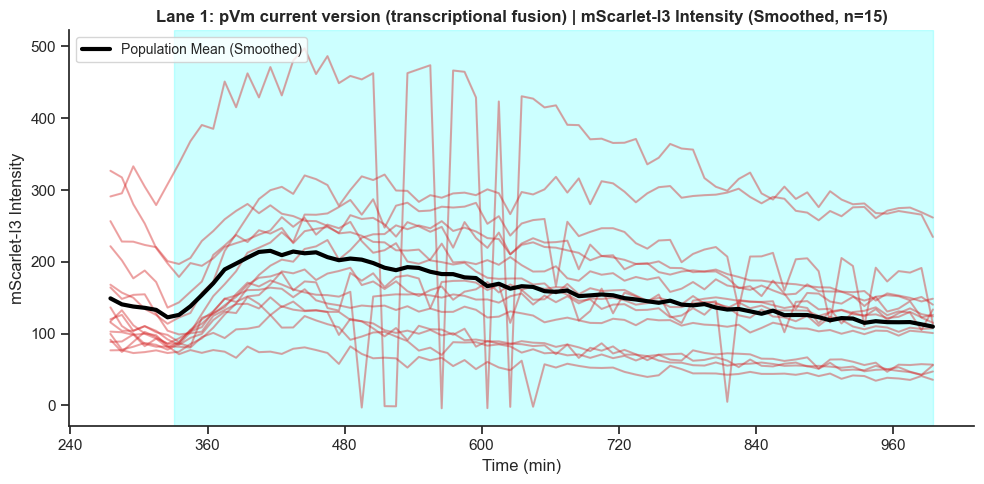

...

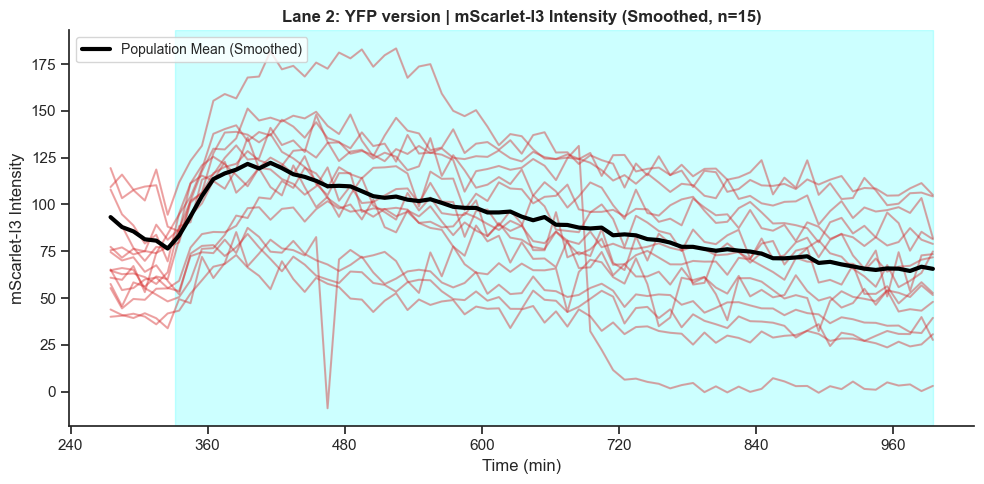

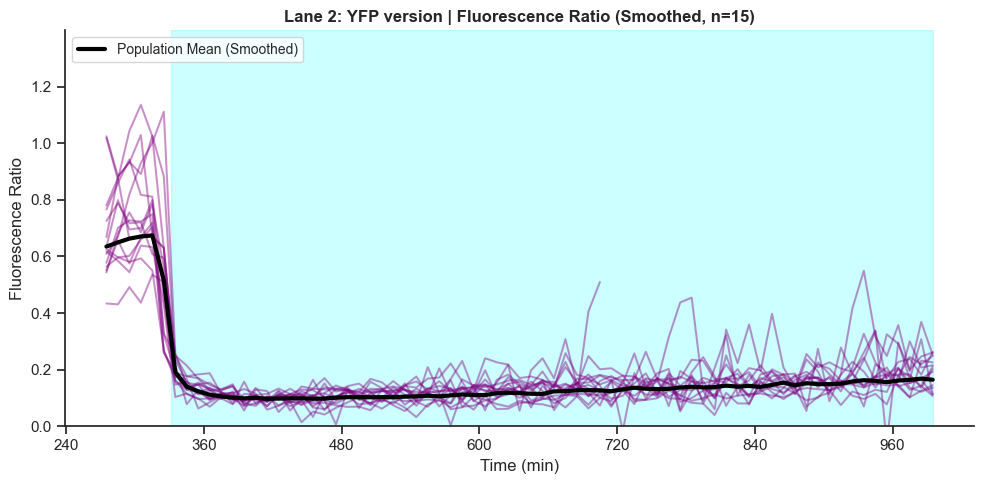

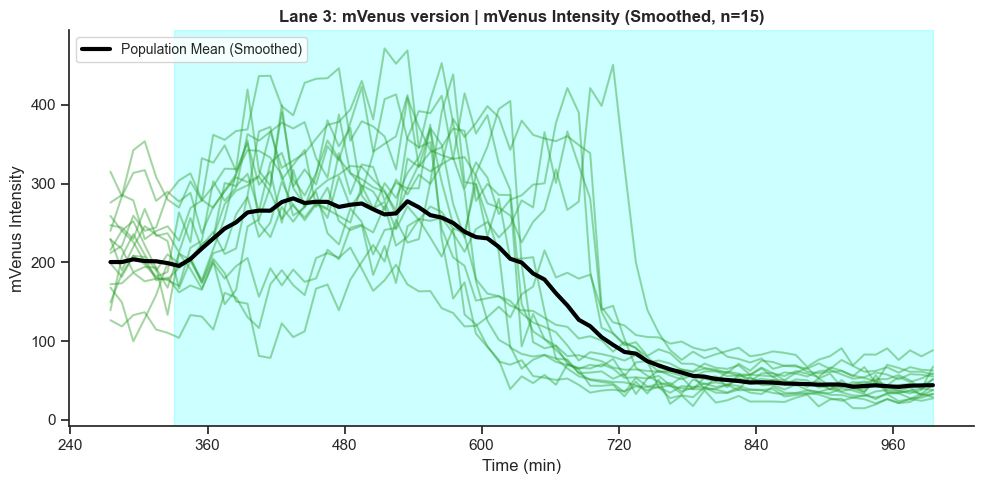

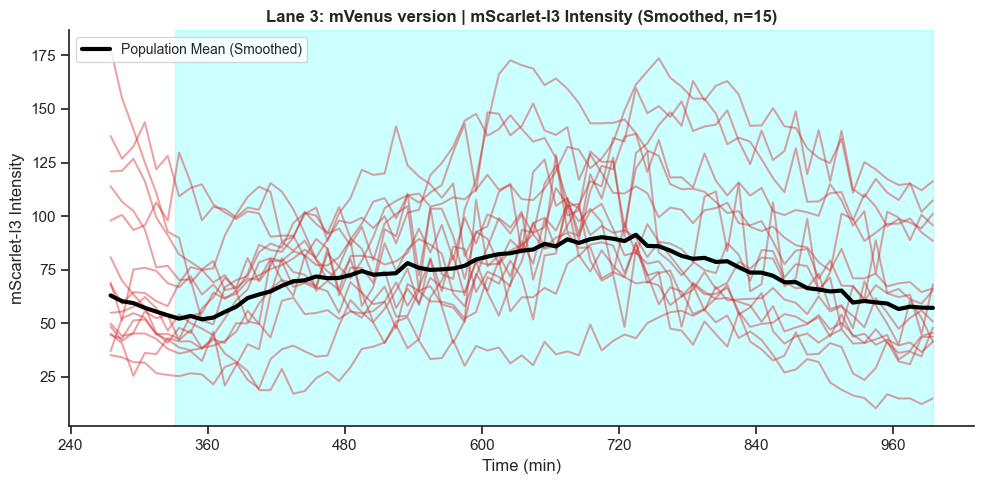

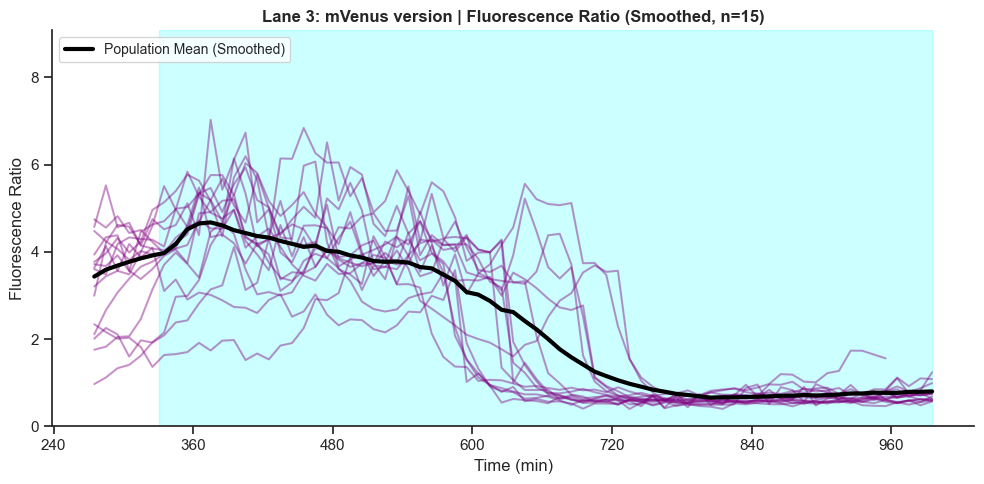

In [36]:
# -- CONFIGURATION: Number of mother_ids to plot & LOWESS fraction --
SAMPLE_SIZE = 15  
LOWESS_FRAC = 0.05  # Fraction of timepoints used for LOWESS smoothing (0 to 1)

print("mVenus/mScarlet-I3")
plot_individual_traces_by_lane_smoothed(mother_machine_data, SHADING_REGIONS, RATIO_CONFIG_mVenus, sample_size=SAMPLE_SIZE, lowess_frac=LOWESS_FRAC)

### Single-cell plots to PDF

In [38]:
# -- CONFIGURATION --
SAMPLE_SIZE = 15  
LOWESS_FRAC = 0.1
RANDOM_SEED = 42
PDF_FILENAME = "single_cell_fluorescence_plots_raw_and_smoothed_GFP.pdf"

# -- Y-AXIS CONFIGURATION --
# Keys must match the channel names in RATIO_CONFIG
Y_LIMITS = {
    'GFP': None,
    'mScarlet-I3': (0, 200),
    'ratio': None
}

generate_single_cell_report(mother_machine_data, PDF_FILENAME, ratio_config=RATIO_CONFIG_GFP, sample_size=SAMPLE_SIZE, lowess_frac=LOWESS_FRAC, seed=RANDOM_SEED, y_limits=Y_LIMITS)

Generating plots for Lane 0 (MTSx2-linker-ArcLight)...
Generating plots for Lane 1 (pVm current version (transcriptional fusion))...
Generating plots for Lane 2 (YFP version)...
Generating plots for Lane 3 (mVenus version)...
Report saved: single_cell_fluorescence_plots_raw_and_smoothed_GFP.pdf


In [39]:
# -- CONFIGURATION --
SAMPLE_SIZE = 15  
LOWESS_FRAC = 0.1
RANDOM_SEED = 42
PDF_FILENAME = "single_cell_fluorescence_plots_raw_and_smoothed_mVenus.pdf"

# -- Y-AXIS CONFIGURATION --
# Keys must match the channel names in RATIO_CONFIG
Y_LIMITS = {
    'mVenus': None,
    'mScarlet-I3': (0, 200),
    'ratio': None
}

generate_single_cell_report(mother_machine_data, PDF_FILENAME, ratio_config=RATIO_CONFIG_mVenus, sample_size=SAMPLE_SIZE, lowess_frac=LOWESS_FRAC, seed=RANDOM_SEED, y_limits=Y_LIMITS)

Generating plots for Lane 0 (MTSx2-linker-ArcLight)...
Generating plots for Lane 1 (pVm current version (transcriptional fusion))...
Generating plots for Lane 2 (YFP version)...
Generating plots for Lane 3 (mVenus version)...
Report saved: single_cell_fluorescence_plots_raw_and_smoothed_mVenus.pdf


In [40]:
#

# End

In [8]:
#